<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_5_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(5):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 33.2649 - IoU: 0.0677
Epoch 1: val_loss improved from inf to 36.64144, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


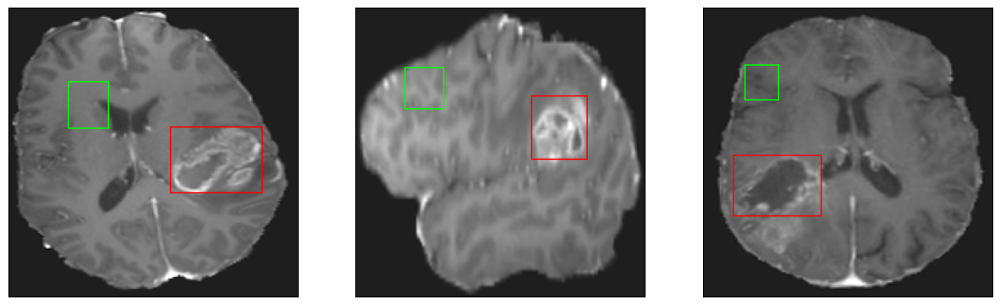

26/26 [==============================] - 20s 259ms/step - loss: 33.2649 - IoU: 0.0677 - val_loss: 36.6414 - val_IoU: 0.0171
Epoch 2/200
25/26 [===========================>..] - ETA: 0s - loss: 20.3745 - IoU: 0.1623
Epoch 2: val_loss improved from 36.64144 to 24.30146, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


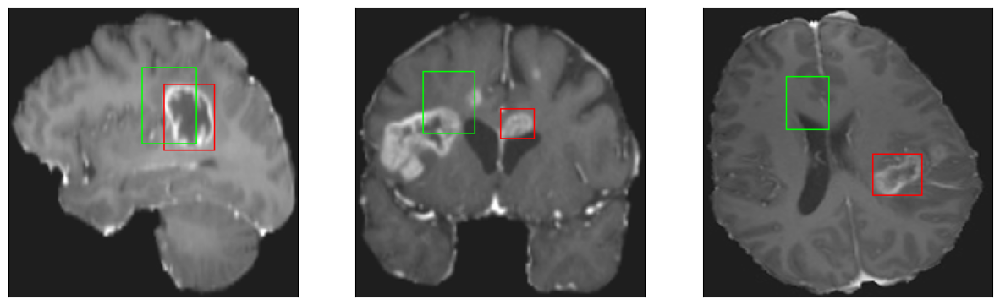

26/26 [==============================] - 2s 86ms/step - loss: 20.2582 - IoU: 0.1640 - val_loss: 24.3015 - val_IoU: 0.1120
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 16.4510 - IoU: 0.2398
Epoch 3: val_loss did not improve from 24.30146
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


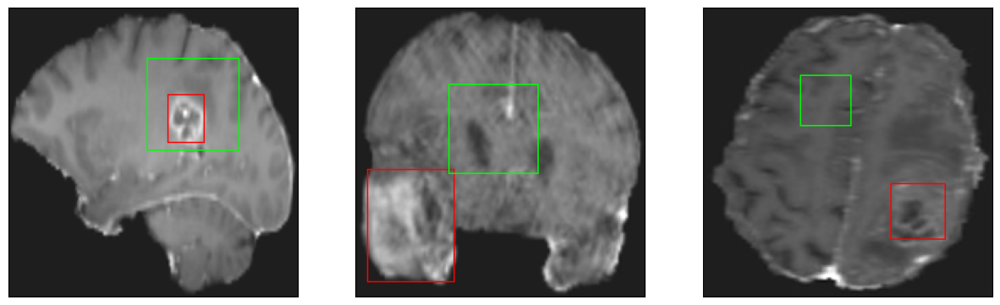

26/26 [==============================] - 2s 78ms/step - loss: 16.4510 - IoU: 0.2398 - val_loss: 29.1242 - val_IoU: 0.1059
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 14.6949 - IoU: 0.2733
Epoch 4: val_loss did not improve from 24.30146
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


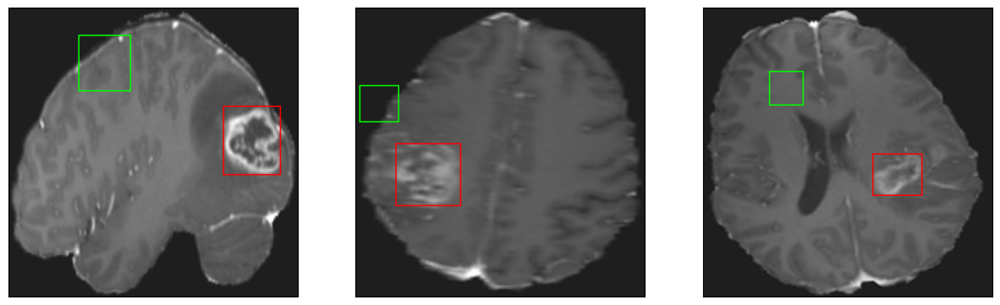

26/26 [==============================] - 3s 99ms/step - loss: 14.6949 - IoU: 0.2733 - val_loss: 29.0007 - val_IoU: 0.0679
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 13.2712 - IoU: 0.3077
Epoch 5: val_loss did not improve from 24.30146
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


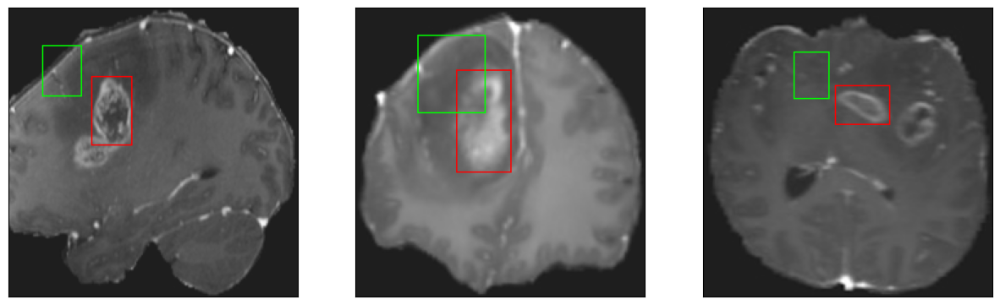

26/26 [==============================] - 3s 105ms/step - loss: 13.2712 - IoU: 0.3077 - val_loss: 25.6572 - val_IoU: 0.1142
Epoch 6/200
25/26 [===========================>..] - ETA: 0s - loss: 12.7809 - IoU: 0.3219
Epoch 6: val_loss did not improve from 24.30146
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


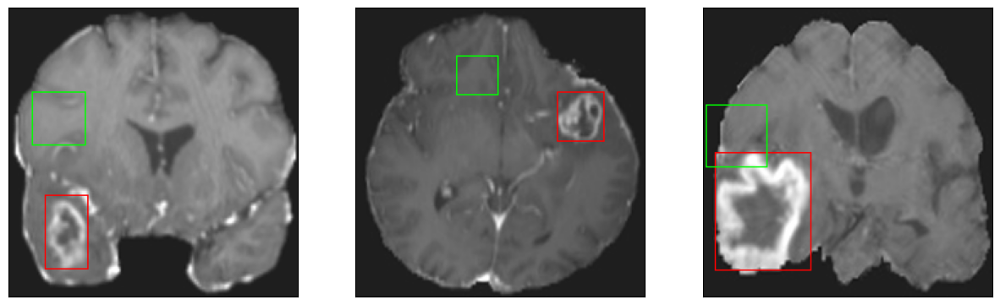

26/26 [==============================] - 2s 93ms/step - loss: 12.7945 - IoU: 0.3210 - val_loss: 29.3407 - val_IoU: 0.0433
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 11.9067 - IoU: 0.3482
Epoch 7: val_loss did not improve from 24.30146
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


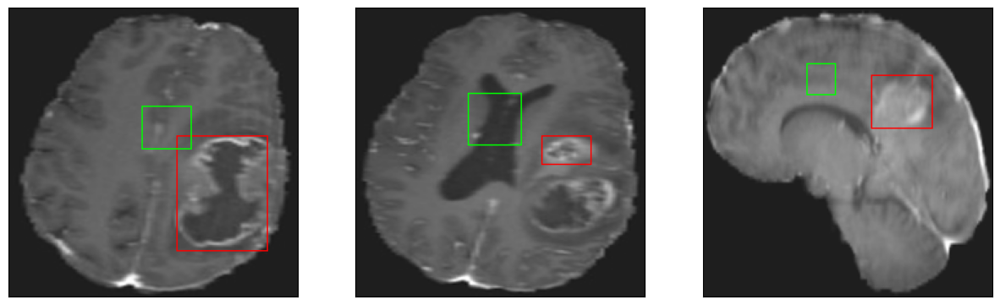

26/26 [==============================] - 2s 86ms/step - loss: 11.9067 - IoU: 0.3482 - val_loss: 24.8230 - val_IoU: 0.0657
Epoch 8/200
25/26 [===========================>..] - ETA: 0s - loss: 11.7202 - IoU: 0.3541
Epoch 8: val_loss improved from 24.30146 to 20.13674, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


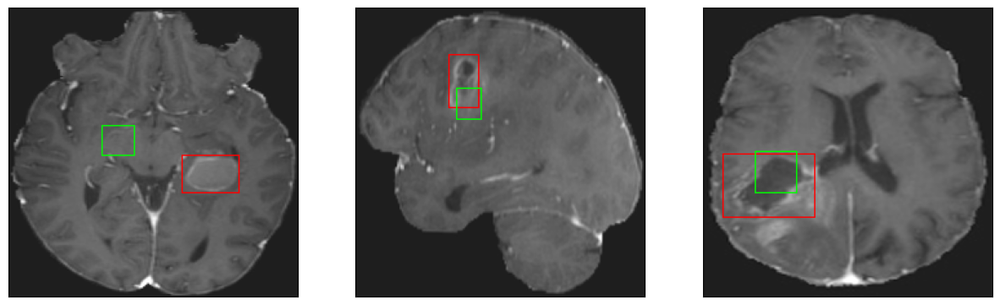

26/26 [==============================] - 3s 119ms/step - loss: 11.6122 - IoU: 0.3598 - val_loss: 20.1367 - val_IoU: 0.1334
Epoch 9/200
25/26 [===========================>..] - ETA: 0s - loss: 10.9368 - IoU: 0.3731
Epoch 9: val_loss did not improve from 20.13674
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


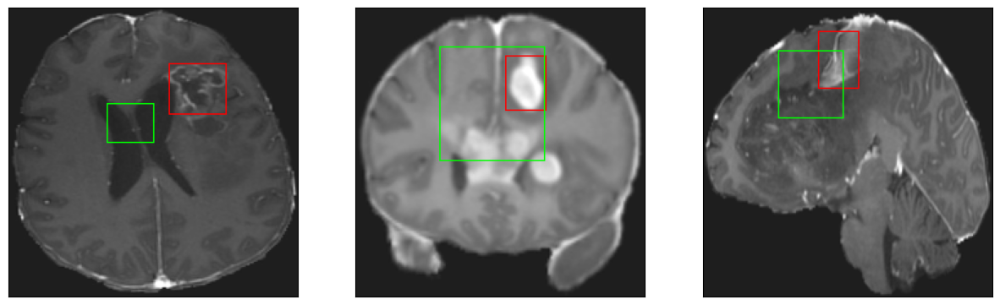

26/26 [==============================] - 2s 86ms/step - loss: 10.9529 - IoU: 0.3742 - val_loss: 22.0194 - val_IoU: 0.2037
Epoch 10/200
25/26 [===========================>..] - ETA: 0s - loss: 10.1276 - IoU: 0.4021
Epoch 10: val_loss improved from 20.13674 to 15.10539, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


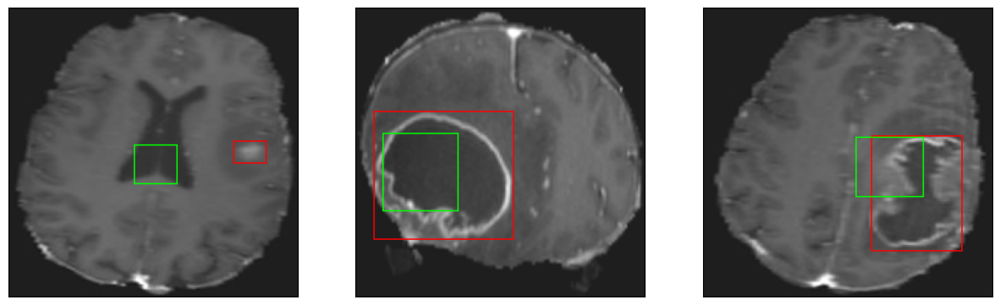

26/26 [==============================] - 2s 96ms/step - loss: 10.2444 - IoU: 0.3994 - val_loss: 15.1054 - val_IoU: 0.2581
Epoch 11/200
25/26 [===========================>..] - ETA: 0s - loss: 9.8925 - IoU: 0.4042
Epoch 11: val_loss improved from 15.10539 to 12.95465, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


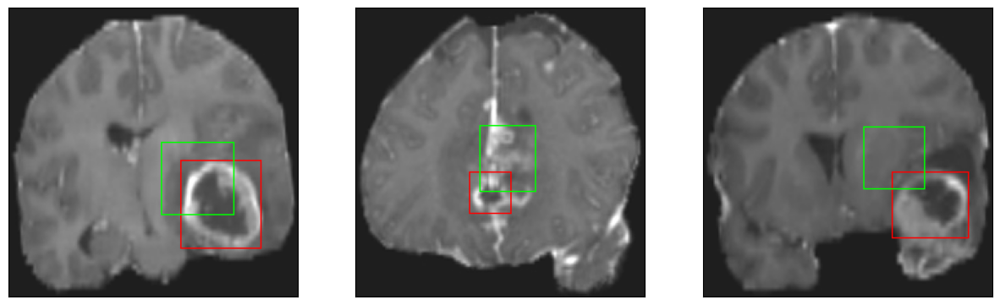

26/26 [==============================] - 3s 97ms/step - loss: 9.8986 - IoU: 0.4030 - val_loss: 12.9547 - val_IoU: 0.3434
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 9.4093 - IoU: 0.4210
Epoch 12: val_loss did not improve from 12.95465
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


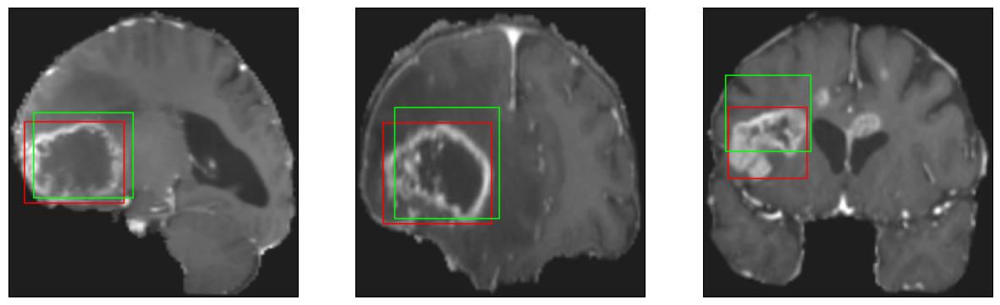

26/26 [==============================] - 2s 92ms/step - loss: 9.4093 - IoU: 0.4210 - val_loss: 15.5665 - val_IoU: 0.2819
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 9.8539 - IoU: 0.4057
Epoch 13: val_loss did not improve from 12.95465
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


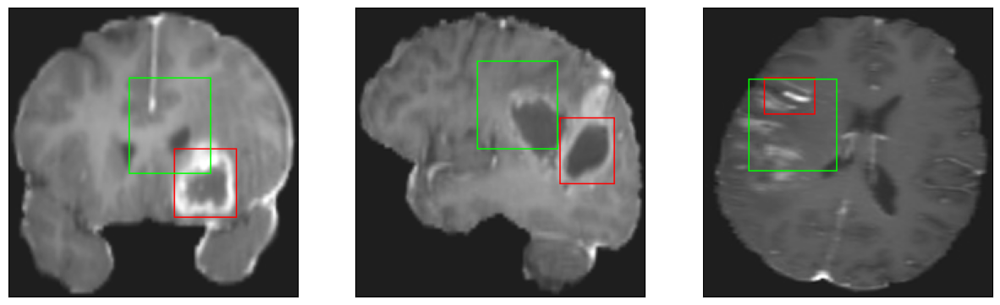

26/26 [==============================] - 3s 132ms/step - loss: 9.8539 - IoU: 0.4057 - val_loss: 19.3127 - val_IoU: 0.2262
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 9.5811 - IoU: 0.4094
Epoch 14: val_loss improved from 12.95465 to 12.91814, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


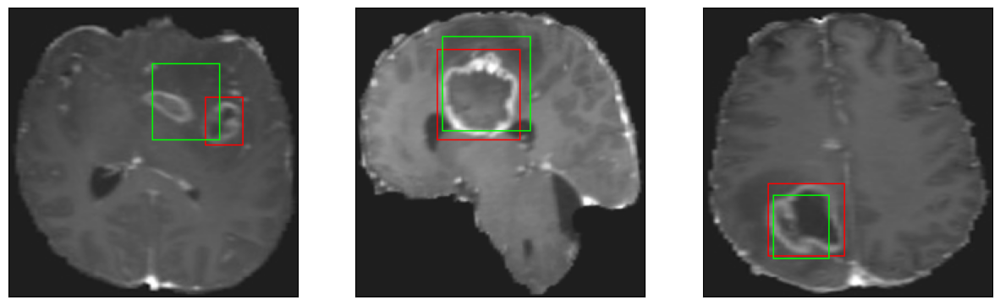

26/26 [==============================] - 3s 114ms/step - loss: 9.5811 - IoU: 0.4094 - val_loss: 12.9181 - val_IoU: 0.4003
Epoch 15/200
25/26 [===========================>..] - ETA: 0s - loss: 9.0126 - IoU: 0.4376
Epoch 15: val_loss did not improve from 12.91814
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


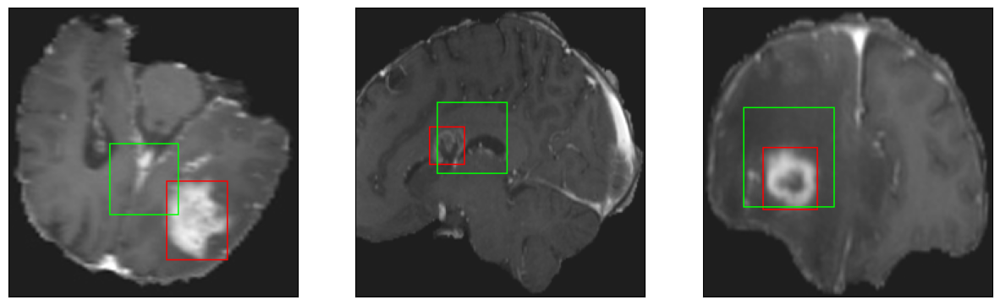

26/26 [==============================] - 2s 92ms/step - loss: 8.9498 - IoU: 0.4399 - val_loss: 14.8549 - val_IoU: 0.2956
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 9.0806 - IoU: 0.4316
Epoch 16: val_loss improved from 12.91814 to 12.04609, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


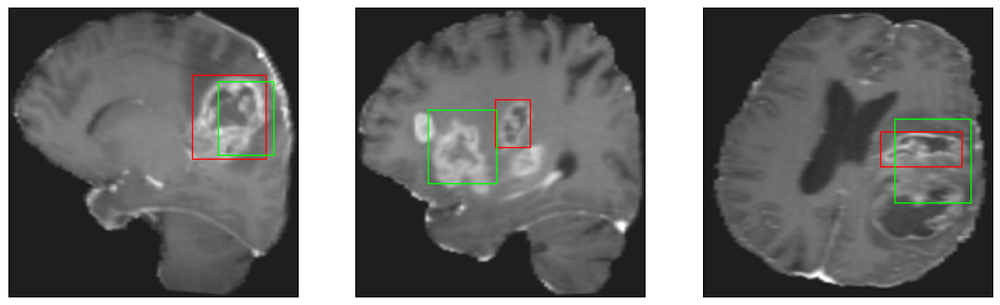

26/26 [==============================] - 2s 92ms/step - loss: 9.0835 - IoU: 0.4294 - val_loss: 12.0461 - val_IoU: 0.3728
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 8.8205 - IoU: 0.4382
Epoch 17: val_loss improved from 12.04609 to 11.75844, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


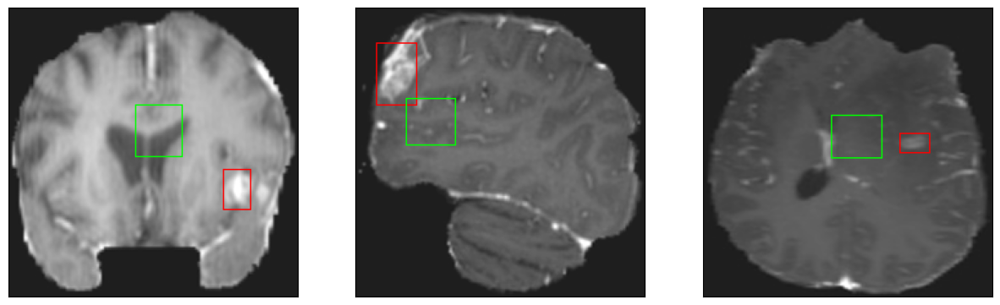

26/26 [==============================] - 3s 116ms/step - loss: 8.8205 - IoU: 0.4382 - val_loss: 11.7584 - val_IoU: 0.3757
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 8.3937 - IoU: 0.4585
Epoch 18: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


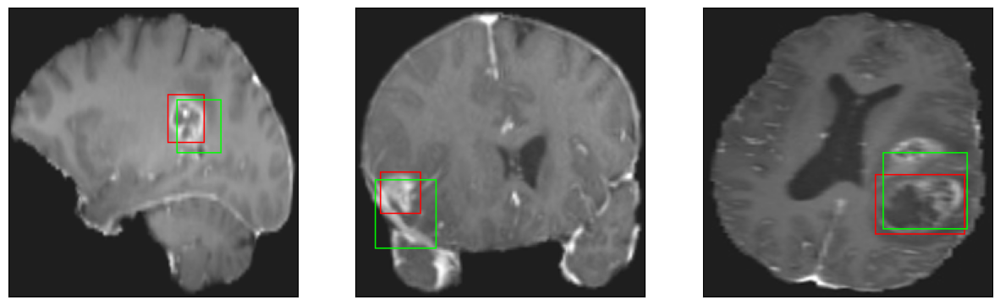

26/26 [==============================] - 3s 127ms/step - loss: 8.3937 - IoU: 0.4585 - val_loss: 12.2500 - val_IoU: 0.3810
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 8.8197 - IoU: 0.4412
Epoch 19: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


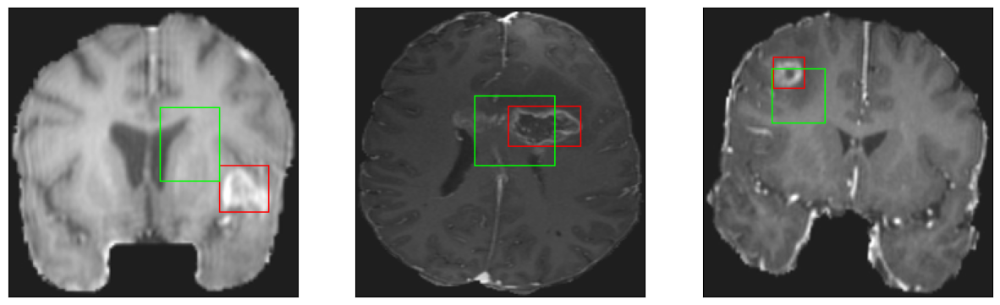

26/26 [==============================] - 3s 97ms/step - loss: 8.8197 - IoU: 0.4412 - val_loss: 12.4820 - val_IoU: 0.3821
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 8.6265 - IoU: 0.4450
Epoch 20: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


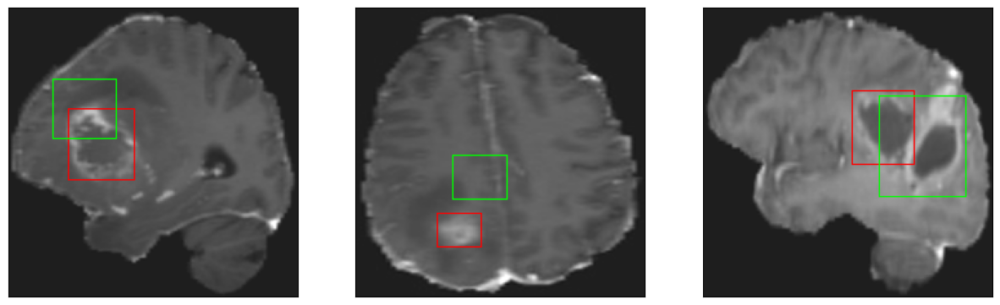

26/26 [==============================] - 2s 90ms/step - loss: 8.6212 - IoU: 0.4468 - val_loss: 15.0200 - val_IoU: 0.3301
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 7.9547 - IoU: 0.4801
Epoch 21: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


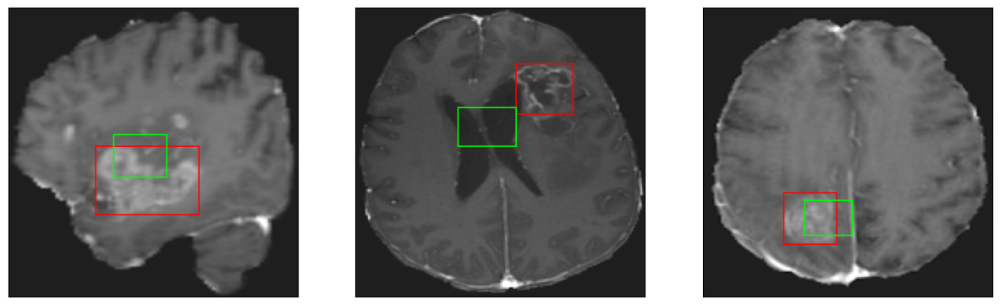

26/26 [==============================] - 3s 103ms/step - loss: 7.9547 - IoU: 0.4801 - val_loss: 11.7745 - val_IoU: 0.4140
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 7.9165 - IoU: 0.4823
Epoch 22: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


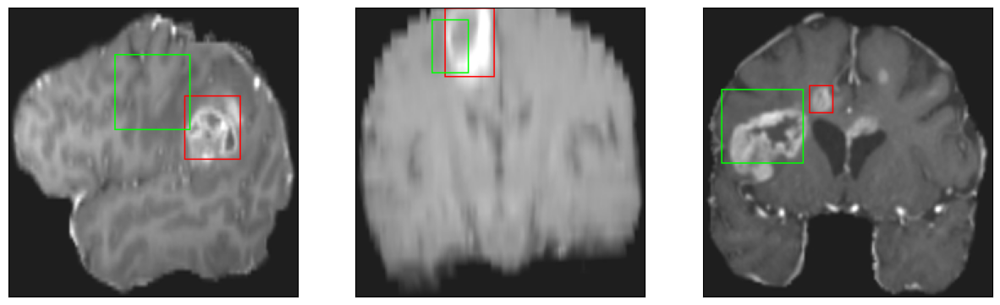

26/26 [==============================] - 3s 97ms/step - loss: 7.9165 - IoU: 0.4823 - val_loss: 13.5294 - val_IoU: 0.3537
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 7.7723 - IoU: 0.4799
Epoch 23: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


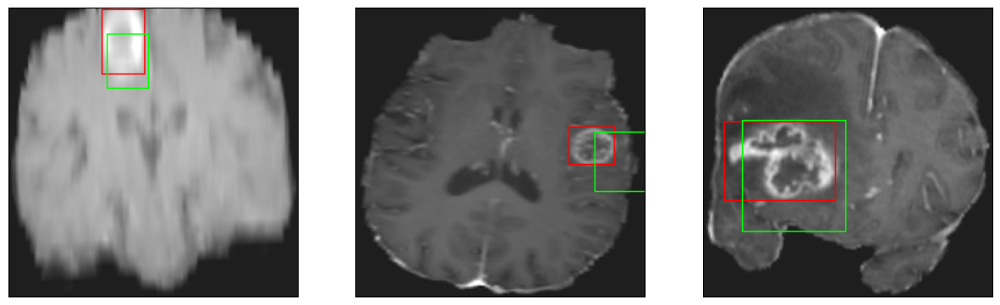

26/26 [==============================] - 2s 94ms/step - loss: 7.7723 - IoU: 0.4799 - val_loss: 15.2771 - val_IoU: 0.3133
Epoch 24/200
25/26 [===========================>..] - ETA: 0s - loss: 7.6927 - IoU: 0.4766
Epoch 24: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


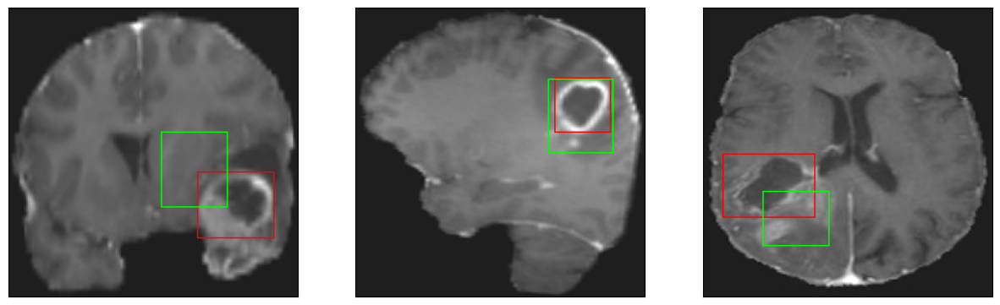

26/26 [==============================] - 3s 95ms/step - loss: 7.6964 - IoU: 0.4784 - val_loss: 12.9334 - val_IoU: 0.3865
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 7.6369 - IoU: 0.4918
Epoch 25: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


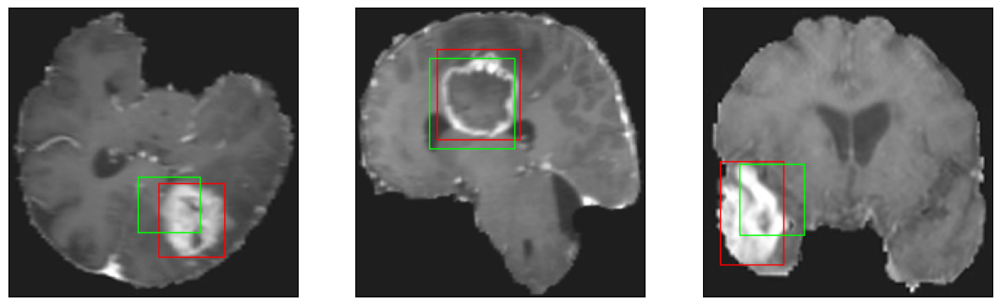

26/26 [==============================] - 2s 96ms/step - loss: 7.6369 - IoU: 0.4918 - val_loss: 13.9728 - val_IoU: 0.3307
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 7.1314 - IoU: 0.5089
Epoch 26: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


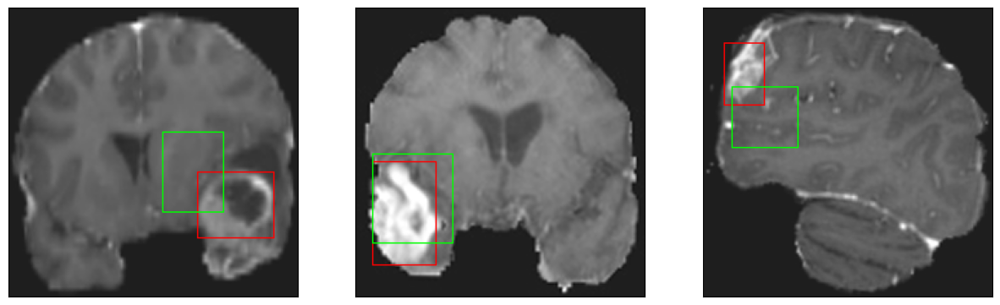

26/26 [==============================] - 3s 121ms/step - loss: 7.1314 - IoU: 0.5089 - val_loss: 15.7908 - val_IoU: 0.3449
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 7.0667 - IoU: 0.5050
Epoch 27: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


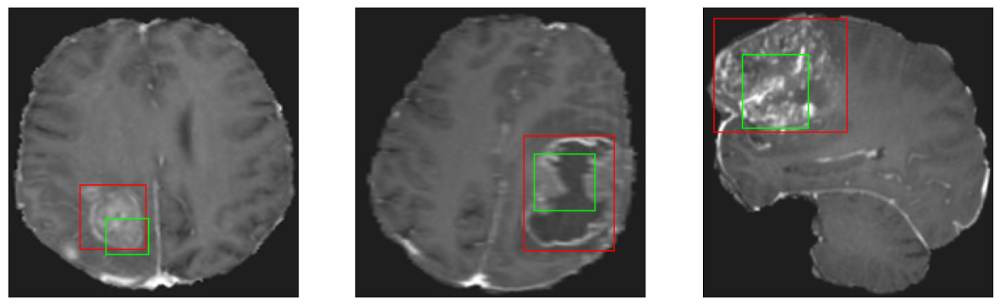

26/26 [==============================] - 3s 117ms/step - loss: 7.0667 - IoU: 0.5050 - val_loss: 14.2250 - val_IoU: 0.3037
Epoch 28/200
25/26 [===========================>..] - ETA: 0s - loss: 7.5259 - IoU: 0.4858
Epoch 28: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


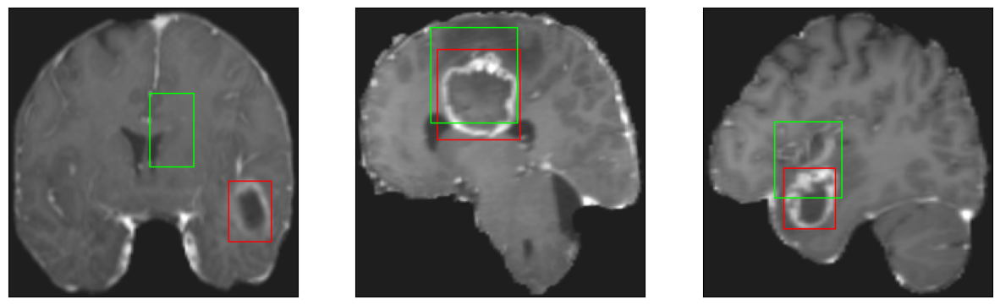

26/26 [==============================] - 3s 107ms/step - loss: 7.4891 - IoU: 0.4867 - val_loss: 13.5943 - val_IoU: 0.3650
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 6.9563 - IoU: 0.5181
Epoch 29: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


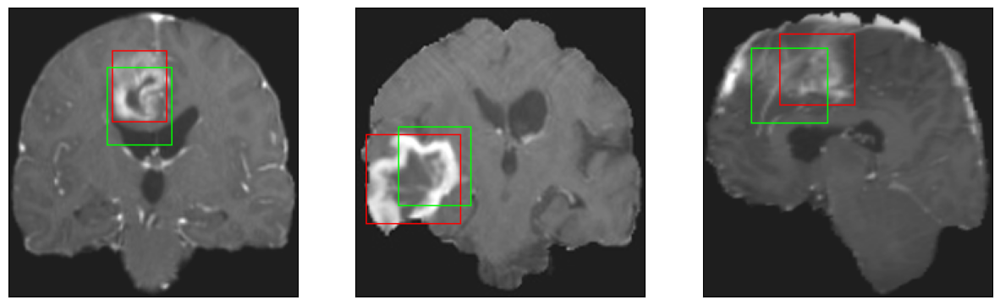

26/26 [==============================] - 3s 111ms/step - loss: 6.9644 - IoU: 0.5178 - val_loss: 15.4064 - val_IoU: 0.3019
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 7.5798 - IoU: 0.4856
Epoch 30: val_loss did not improve from 11.75844
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


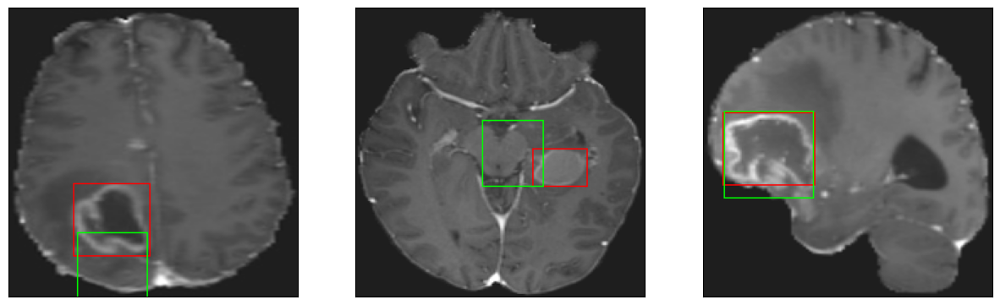

26/26 [==============================] - 3s 110ms/step - loss: 7.5798 - IoU: 0.4856 - val_loss: 13.2488 - val_IoU: 0.3387
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 7.0876 - IoU: 0.5189
Epoch 31: val_loss improved from 11.75844 to 11.61014, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 13ms/step
4


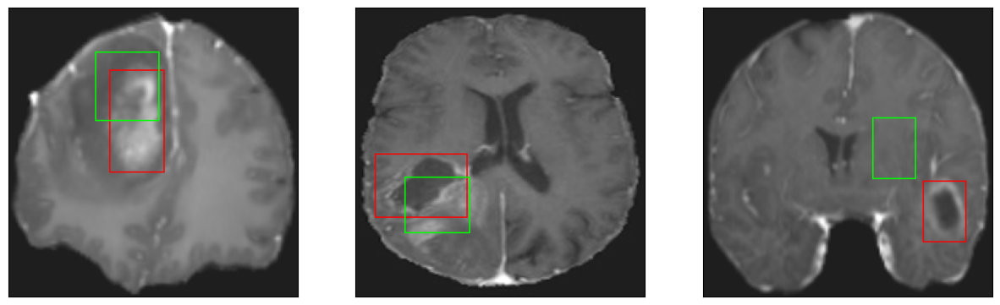

26/26 [==============================] - 4s 151ms/step - loss: 7.0876 - IoU: 0.5189 - val_loss: 11.6101 - val_IoU: 0.4260
Epoch 32/200
25/26 [===========================>..] - ETA: 0s - loss: 6.7749 - IoU: 0.5281
Epoch 32: val_loss improved from 11.61014 to 10.93359, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


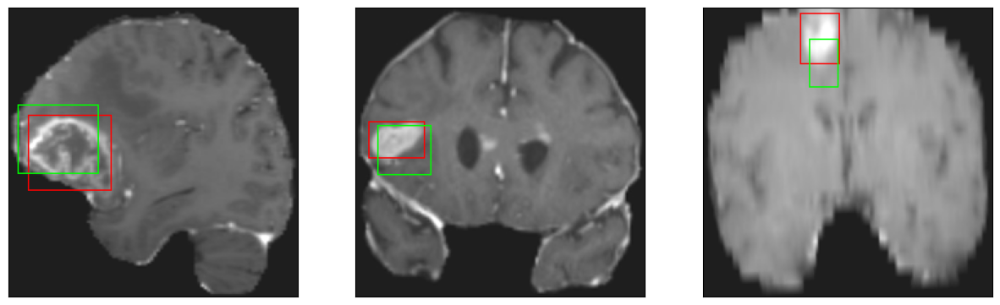

26/26 [==============================] - 3s 121ms/step - loss: 6.7929 - IoU: 0.5264 - val_loss: 10.9336 - val_IoU: 0.4111
Epoch 33/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6854 - IoU: 0.5347
Epoch 33: val_loss did not improve from 10.93359
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


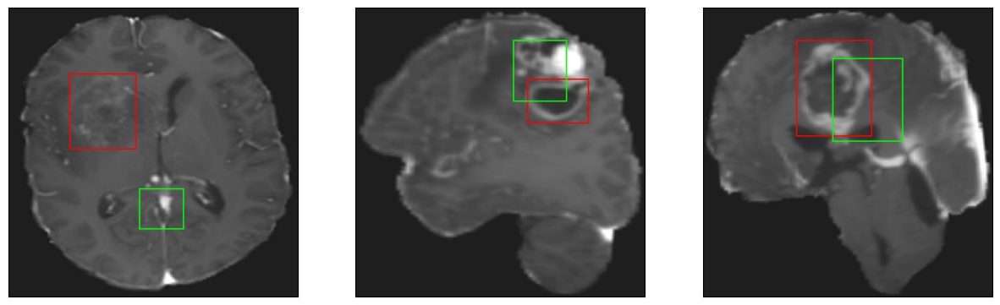

26/26 [==============================] - 3s 98ms/step - loss: 6.6645 - IoU: 0.5350 - val_loss: 12.5495 - val_IoU: 0.3629
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 6.9520 - IoU: 0.5199
Epoch 34: val_loss did not improve from 10.93359
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


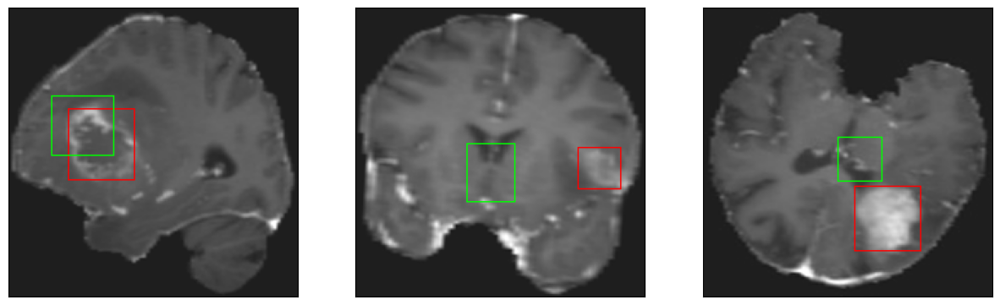

26/26 [==============================] - 2s 94ms/step - loss: 6.9520 - IoU: 0.5199 - val_loss: 11.1035 - val_IoU: 0.4058
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 6.7621 - IoU: 0.5227
Epoch 35: val_loss did not improve from 10.93359
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


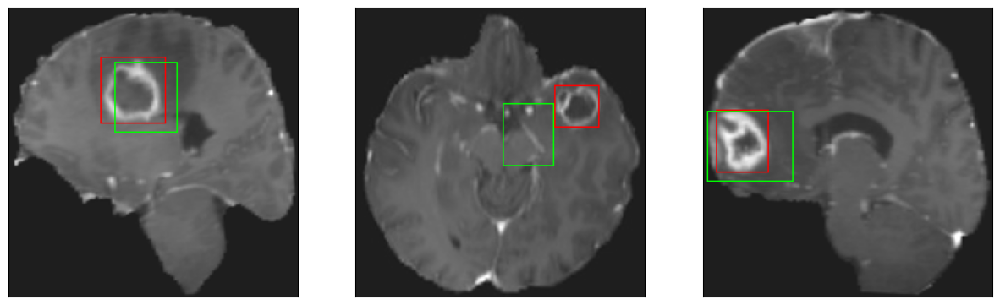

26/26 [==============================] - 3s 119ms/step - loss: 6.7621 - IoU: 0.5227 - val_loss: 13.4396 - val_IoU: 0.3209
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 6.8245 - IoU: 0.5187
Epoch 36: val_loss did not improve from 10.93359
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


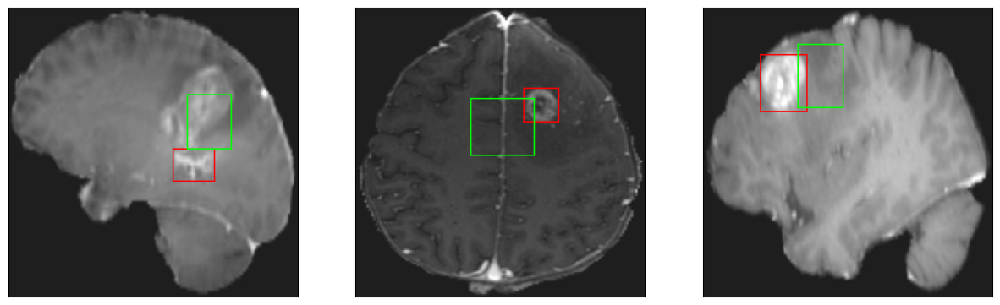

26/26 [==============================] - 3s 113ms/step - loss: 6.8245 - IoU: 0.5187 - val_loss: 12.0212 - val_IoU: 0.3842
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 6.3942 - IoU: 0.5437
Epoch 37: val_loss did not improve from 10.93359
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


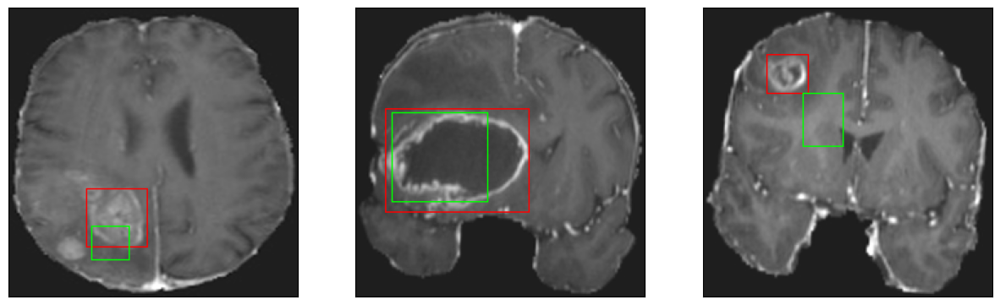

26/26 [==============================] - 3s 104ms/step - loss: 6.3942 - IoU: 0.5437 - val_loss: 11.8610 - val_IoU: 0.3702
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 6.5227 - IoU: 0.5373
Epoch 38: val_loss did not improve from 10.93359
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


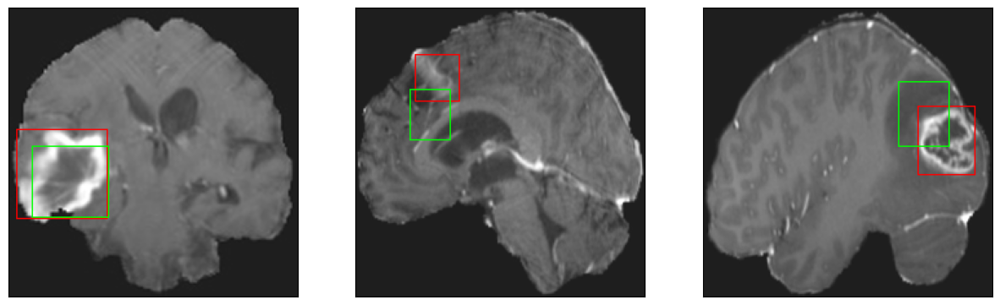

26/26 [==============================] - 3s 111ms/step - loss: 6.5227 - IoU: 0.5373 - val_loss: 11.0369 - val_IoU: 0.3990
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4287 - IoU: 0.5422
Epoch 39: val_loss did not improve from 10.93359
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


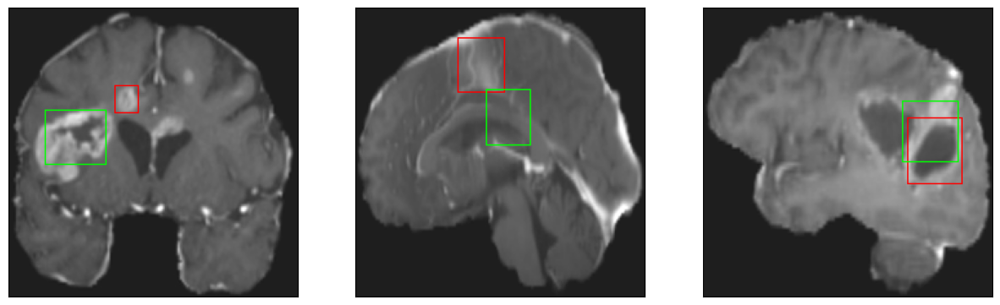

26/26 [==============================] - 3s 104ms/step - loss: 6.3623 - IoU: 0.5440 - val_loss: 12.4153 - val_IoU: 0.3564
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 6.3974 - IoU: 0.5427
Epoch 40: val_loss did not improve from 10.93359
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


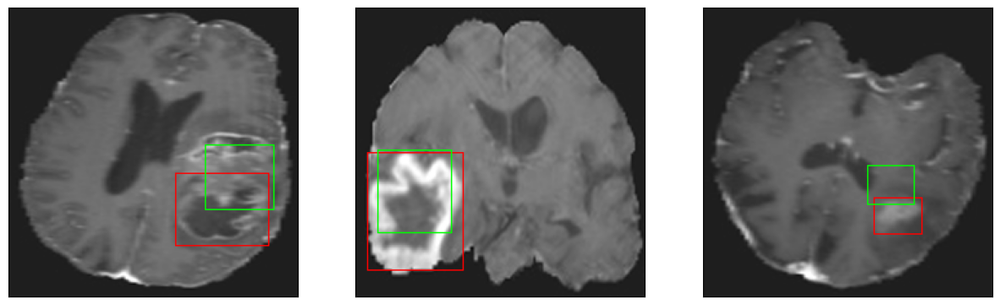

26/26 [==============================] - 3s 102ms/step - loss: 6.3974 - IoU: 0.5427 - val_loss: 11.6727 - val_IoU: 0.3902
Epoch 41/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5320 - IoU: 0.5426
Epoch 41: val_loss did not improve from 10.93359
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


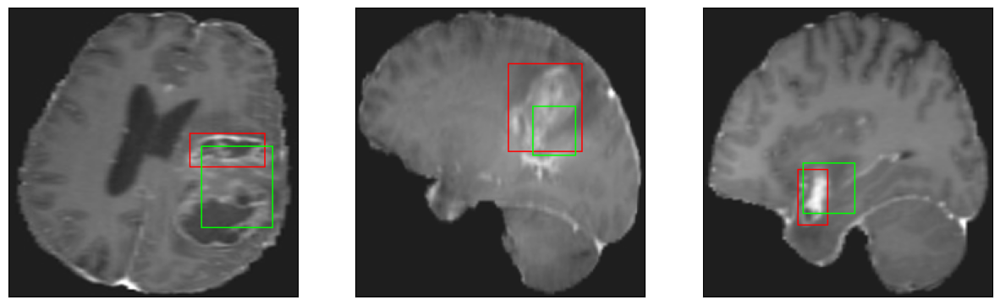

26/26 [==============================] - 3s 129ms/step - loss: 6.5451 - IoU: 0.5422 - val_loss: 11.8411 - val_IoU: 0.3731
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 6.4750 - IoU: 0.5398
Epoch 42: val_loss improved from 10.93359 to 10.62845, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


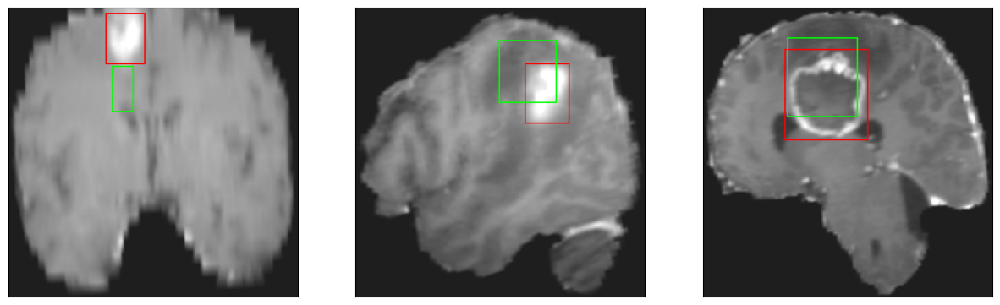

26/26 [==============================] - 4s 155ms/step - loss: 6.4750 - IoU: 0.5398 - val_loss: 10.6285 - val_IoU: 0.4140
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 6.4574 - IoU: 0.5375
Epoch 43: val_loss did not improve from 10.62845
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


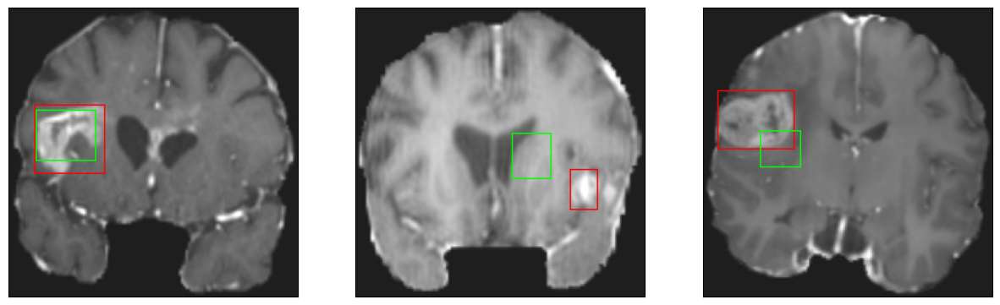

26/26 [==============================] - 3s 112ms/step - loss: 6.4574 - IoU: 0.5375 - val_loss: 11.3570 - val_IoU: 0.3869
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1099 - IoU: 0.5560
Epoch 44: val_loss did not improve from 10.62845
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


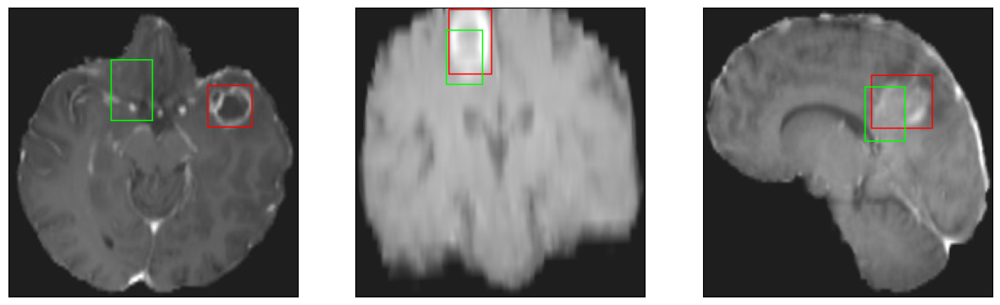

26/26 [==============================] - 3s 105ms/step - loss: 6.1133 - IoU: 0.5564 - val_loss: 13.3388 - val_IoU: 0.3294
Epoch 45/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5291 - IoU: 0.5271
Epoch 45: val_loss did not improve from 10.62845
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


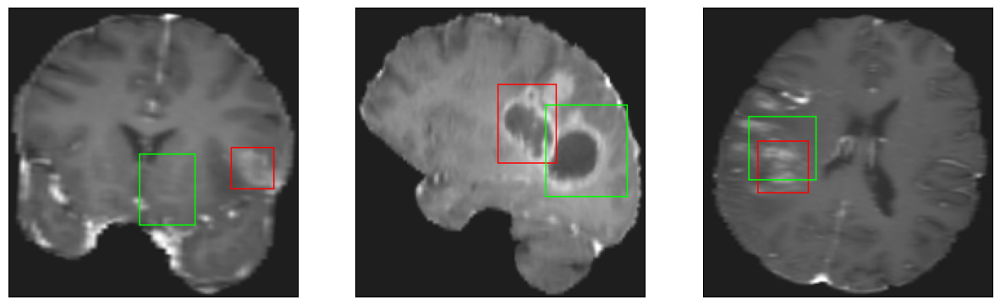

26/26 [==============================] - 3s 112ms/step - loss: 6.5169 - IoU: 0.5286 - val_loss: 11.4003 - val_IoU: 0.4032
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4783 - IoU: 0.5430
Epoch 46: val_loss did not improve from 10.62845
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


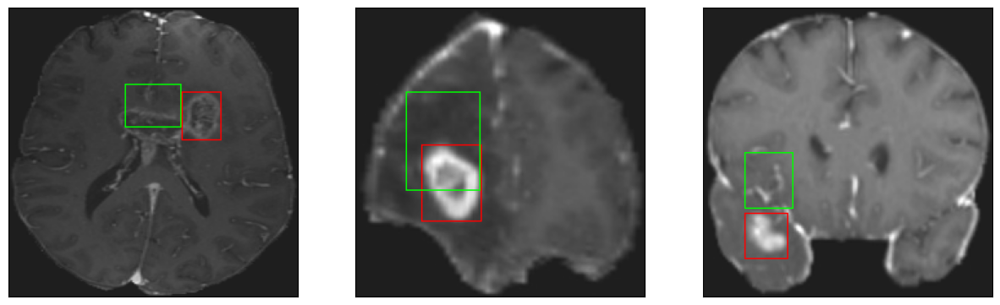

26/26 [==============================] - 3s 117ms/step - loss: 6.4566 - IoU: 0.5445 - val_loss: 14.6902 - val_IoU: 0.2867
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0013 - IoU: 0.5654
Epoch 47: val_loss did not improve from 10.62845
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


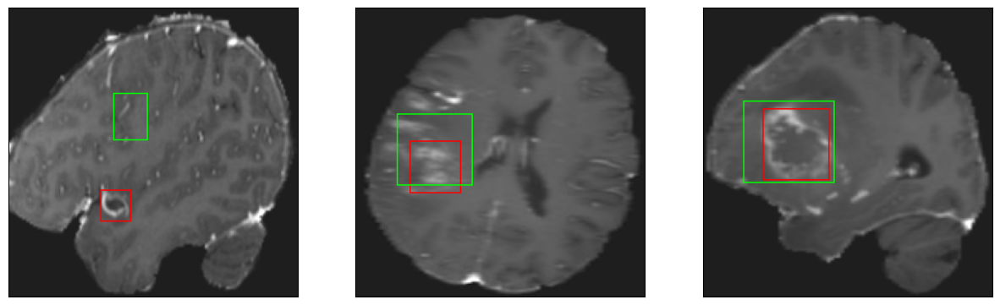

26/26 [==============================] - 2s 95ms/step - loss: 5.9858 - IoU: 0.5645 - val_loss: 13.4008 - val_IoU: 0.3801
Epoch 48/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9599 - IoU: 0.5731
Epoch 48: val_loss did not improve from 10.62845
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


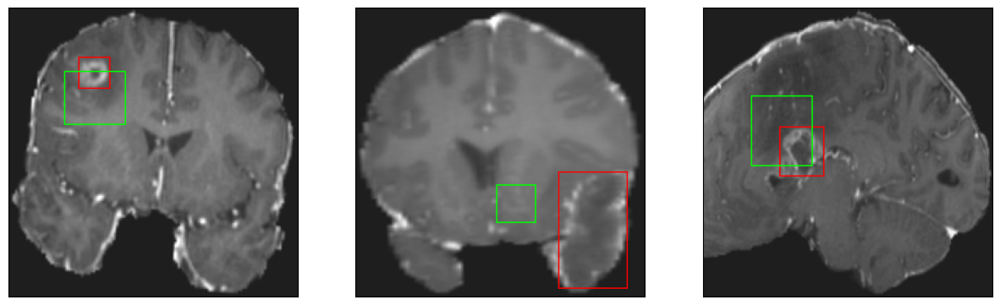

26/26 [==============================] - 3s 104ms/step - loss: 5.9837 - IoU: 0.5710 - val_loss: 11.3183 - val_IoU: 0.4232
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3118 - IoU: 0.5542
Epoch 49: val_loss did not improve from 10.62845
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


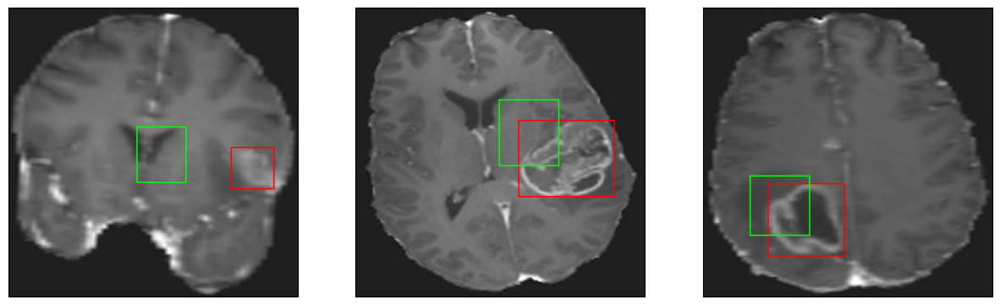

26/26 [==============================] - 3s 96ms/step - loss: 6.3551 - IoU: 0.5539 - val_loss: 14.4983 - val_IoU: 0.2925
Epoch 50/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0356 - IoU: 0.5607
Epoch 50: val_loss did not improve from 10.62845
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


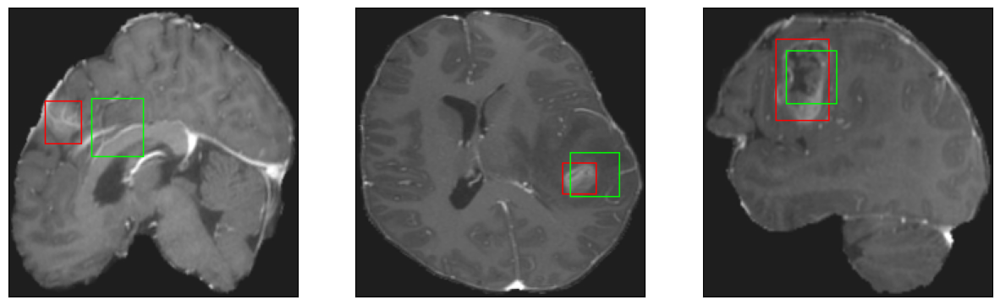

26/26 [==============================] - 3s 116ms/step - loss: 5.9981 - IoU: 0.5629 - val_loss: 10.6783 - val_IoU: 0.4281
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 5.8387 - IoU: 0.5693
Epoch 51: val_loss did not improve from 10.62845
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


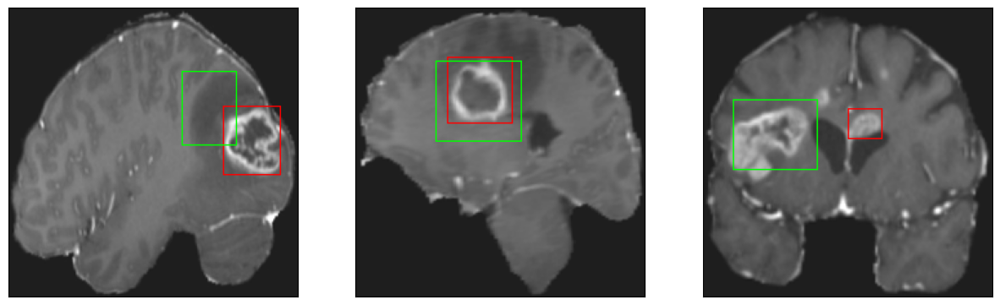

26/26 [==============================] - 3s 121ms/step - loss: 5.8387 - IoU: 0.5693 - val_loss: 11.7063 - val_IoU: 0.4022
Epoch 52/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5961 - IoU: 0.5809
Epoch 52: val_loss improved from 10.62845 to 10.61644, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


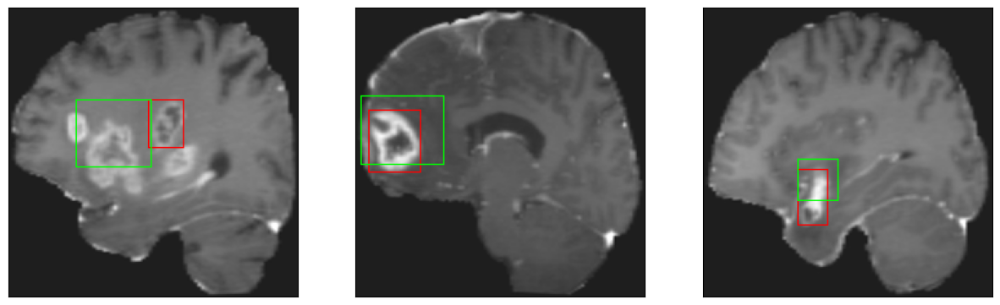

26/26 [==============================] - 3s 127ms/step - loss: 5.6009 - IoU: 0.5806 - val_loss: 10.6164 - val_IoU: 0.4360
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 5.9618 - IoU: 0.5674
Epoch 53: val_loss did not improve from 10.61644
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


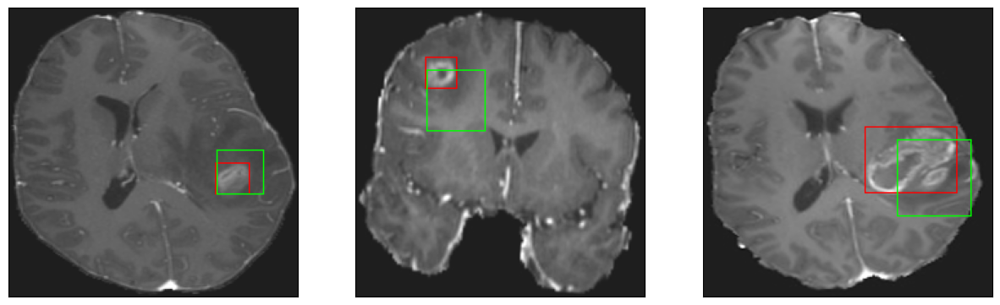

26/26 [==============================] - 3s 110ms/step - loss: 5.9618 - IoU: 0.5674 - val_loss: 12.1947 - val_IoU: 0.4122
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 5.8428 - IoU: 0.5764
Epoch 54: val_loss did not improve from 10.61644
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


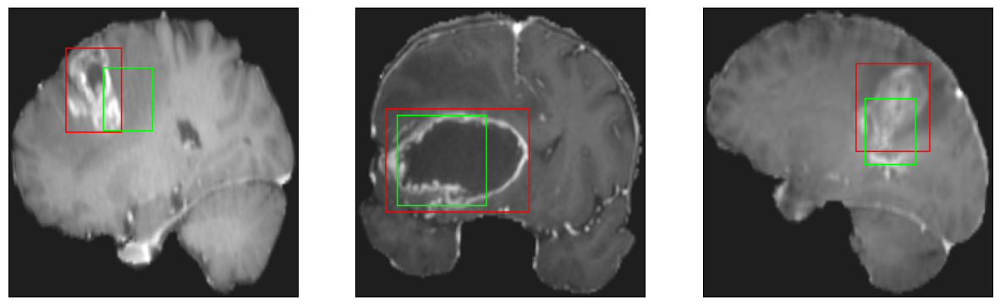

26/26 [==============================] - 3s 125ms/step - loss: 5.8428 - IoU: 0.5764 - val_loss: 11.7946 - val_IoU: 0.3743
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 5.9475 - IoU: 0.5701
Epoch 55: val_loss did not improve from 10.61644
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


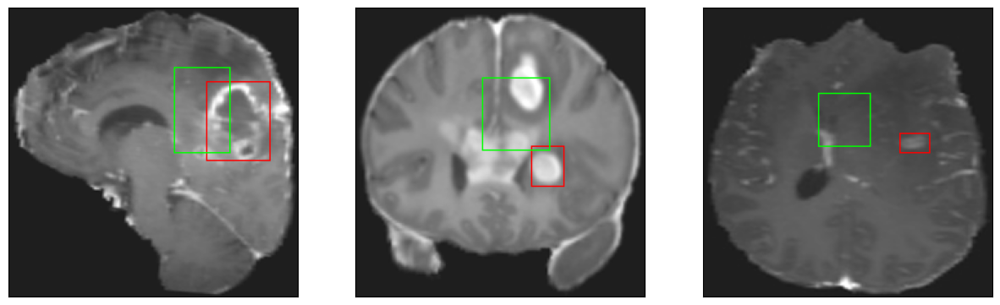

26/26 [==============================] - 3s 108ms/step - loss: 5.9475 - IoU: 0.5701 - val_loss: 10.9222 - val_IoU: 0.4136
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 6.2964 - IoU: 0.5541
Epoch 56: val_loss did not improve from 10.61644
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


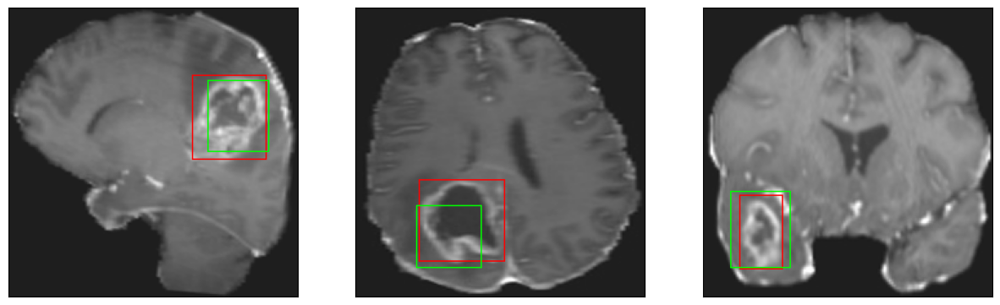

26/26 [==============================] - 3s 113ms/step - loss: 6.2964 - IoU: 0.5541 - val_loss: 10.6374 - val_IoU: 0.4107
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 6.1527 - IoU: 0.5524
Epoch 57: val_loss improved from 10.61644 to 10.18888, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


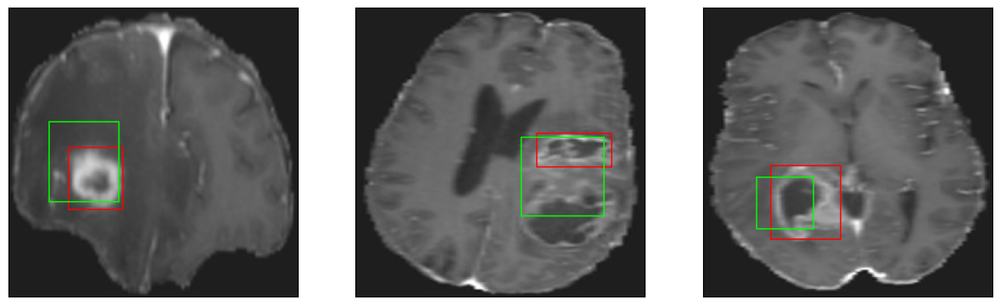

26/26 [==============================] - 4s 149ms/step - loss: 6.1527 - IoU: 0.5524 - val_loss: 10.1889 - val_IoU: 0.4694
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 6.0593 - IoU: 0.5620
Epoch 58: val_loss did not improve from 10.18888
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


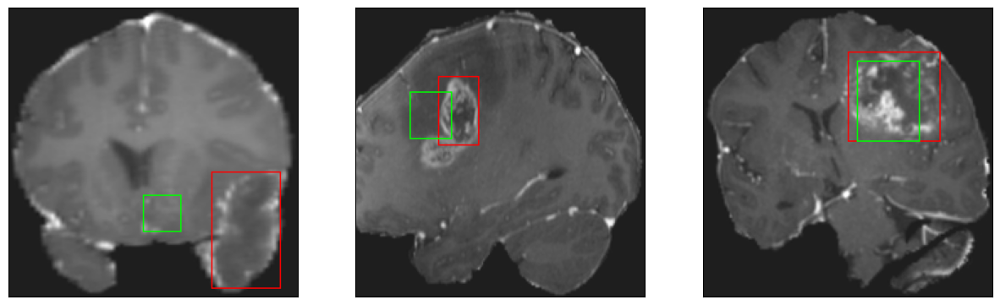

26/26 [==============================] - 3s 99ms/step - loss: 6.0593 - IoU: 0.5620 - val_loss: 12.0182 - val_IoU: 0.3657
Epoch 59/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7128 - IoU: 0.5807
Epoch 59: val_loss improved from 10.18888 to 10.05902, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


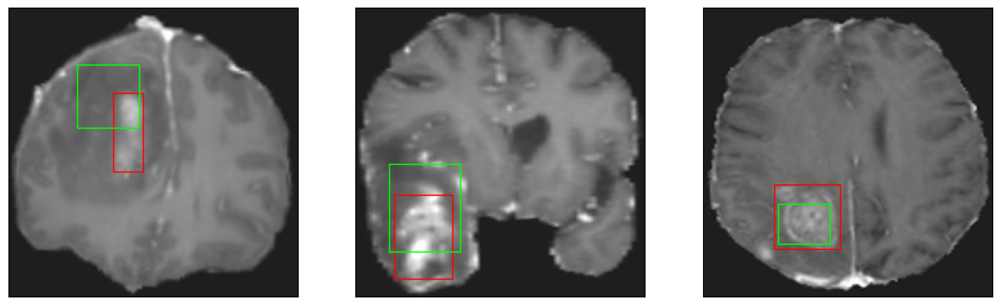

26/26 [==============================] - 3s 105ms/step - loss: 5.7763 - IoU: 0.5786 - val_loss: 10.0590 - val_IoU: 0.4721
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 5.6309 - IoU: 0.5807
Epoch 60: val_loss did not improve from 10.05902
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


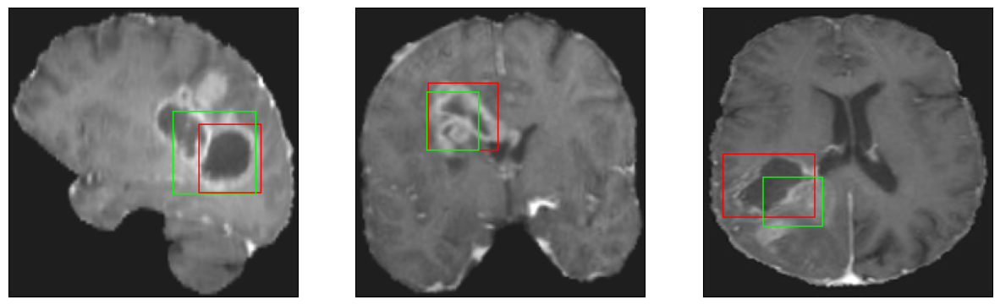

26/26 [==============================] - 3s 101ms/step - loss: 5.6309 - IoU: 0.5807 - val_loss: 12.5573 - val_IoU: 0.3558
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 5.5668 - IoU: 0.5871
Epoch 61: val_loss did not improve from 10.05902
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


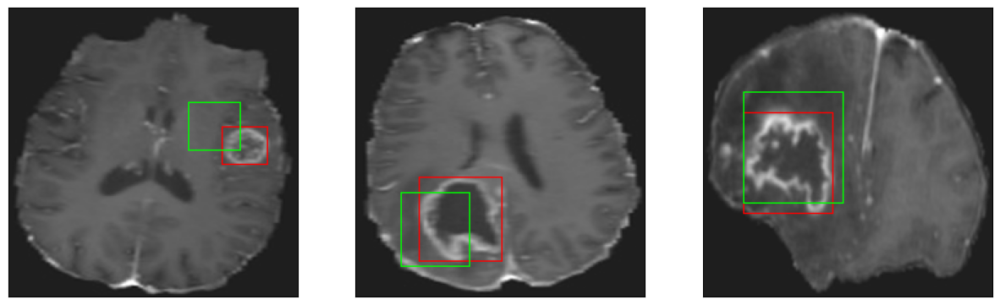

26/26 [==============================] - 3s 133ms/step - loss: 5.5668 - IoU: 0.5871 - val_loss: 12.0875 - val_IoU: 0.3800
Epoch 62/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5928 - IoU: 0.5879
Epoch 62: val_loss did not improve from 10.05902
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


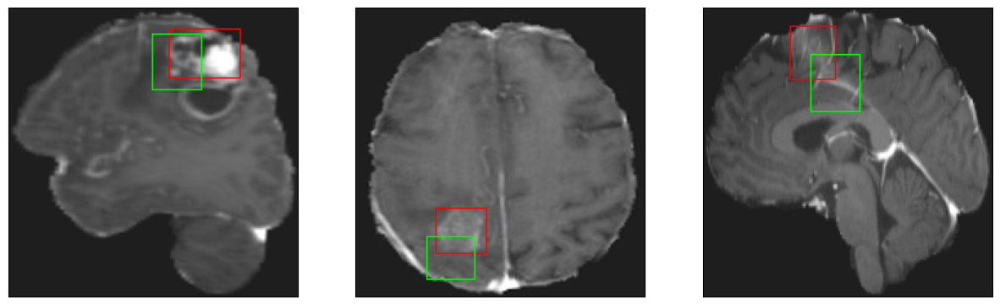

26/26 [==============================] - 3s 117ms/step - loss: 5.6681 - IoU: 0.5857 - val_loss: 10.4866 - val_IoU: 0.4239
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 5.4518 - IoU: 0.5996
Epoch 63: val_loss improved from 10.05902 to 9.85859, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


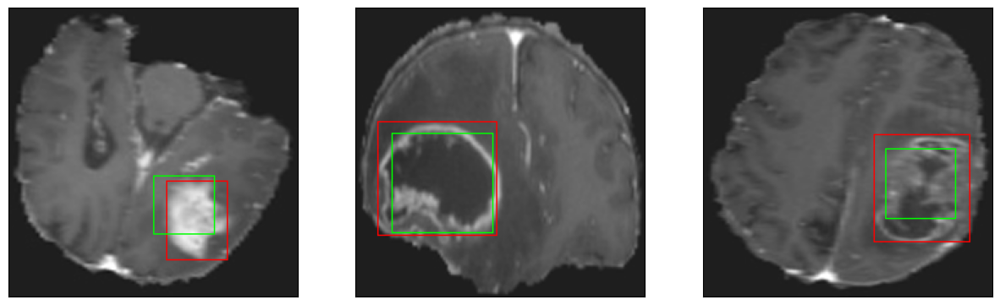

26/26 [==============================] - 3s 126ms/step - loss: 5.4518 - IoU: 0.5996 - val_loss: 9.8586 - val_IoU: 0.4517
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 5.4931 - IoU: 0.5881
Epoch 64: val_loss did not improve from 9.85859
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


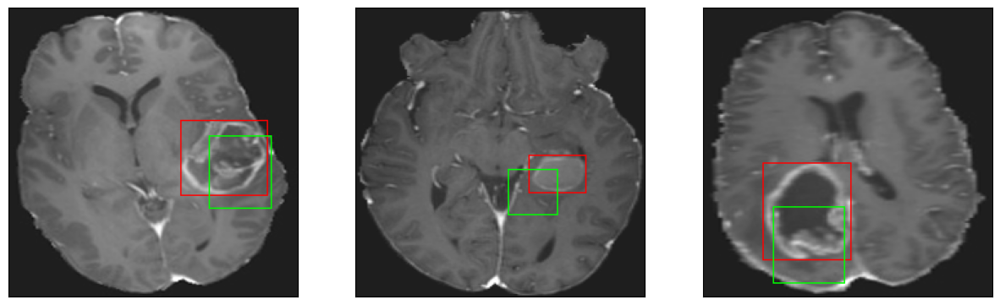

26/26 [==============================] - 3s 106ms/step - loss: 5.4931 - IoU: 0.5881 - val_loss: 10.8491 - val_IoU: 0.4269
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5156 - IoU: 0.5894
Epoch 65: val_loss improved from 9.85859 to 9.63908, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


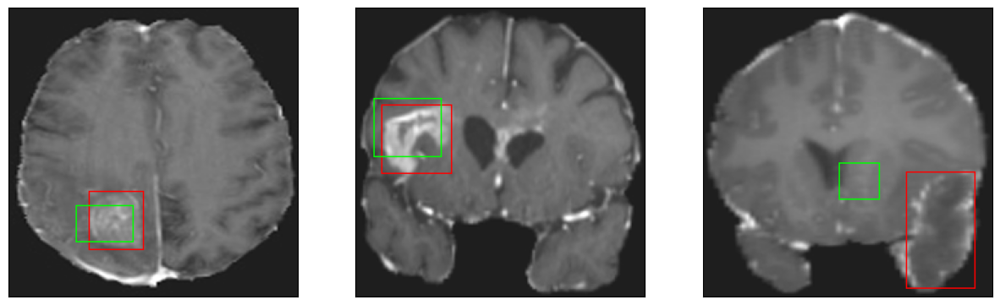

26/26 [==============================] - 4s 136ms/step - loss: 5.5076 - IoU: 0.5896 - val_loss: 9.6391 - val_IoU: 0.4616
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 5.7828 - IoU: 0.5684
Epoch 66: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


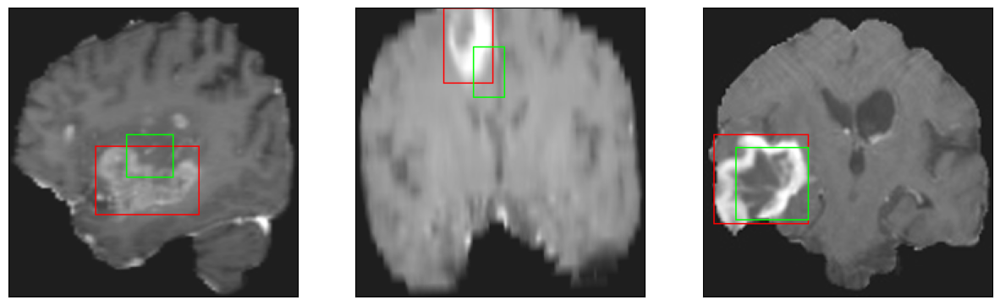

26/26 [==============================] - 3s 114ms/step - loss: 5.7828 - IoU: 0.5684 - val_loss: 10.1783 - val_IoU: 0.4366
Epoch 67/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6831 - IoU: 0.5732
Epoch 67: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


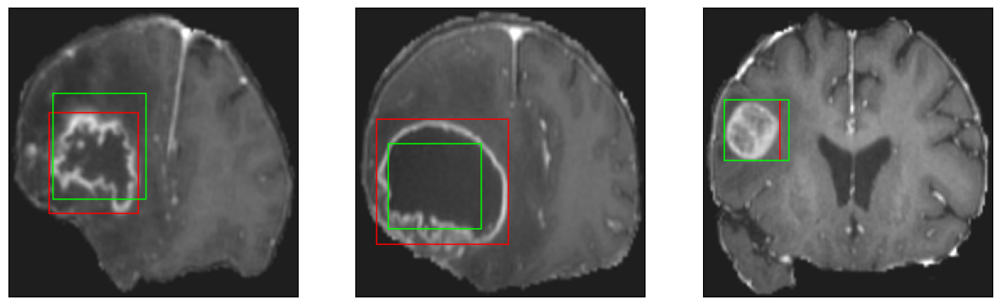

26/26 [==============================] - 3s 100ms/step - loss: 5.6673 - IoU: 0.5746 - val_loss: 10.1443 - val_IoU: 0.4632
Epoch 68/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2973 - IoU: 0.6016
Epoch 68: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


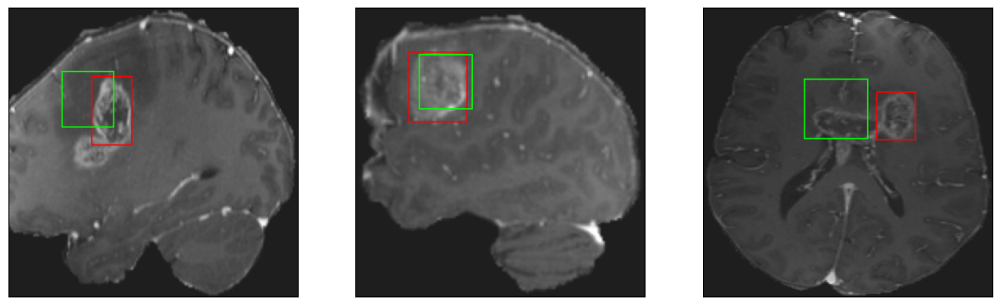

26/26 [==============================] - 2s 93ms/step - loss: 5.3360 - IoU: 0.5978 - val_loss: 9.8515 - val_IoU: 0.4615
Epoch 69/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2725 - IoU: 0.5995
Epoch 69: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


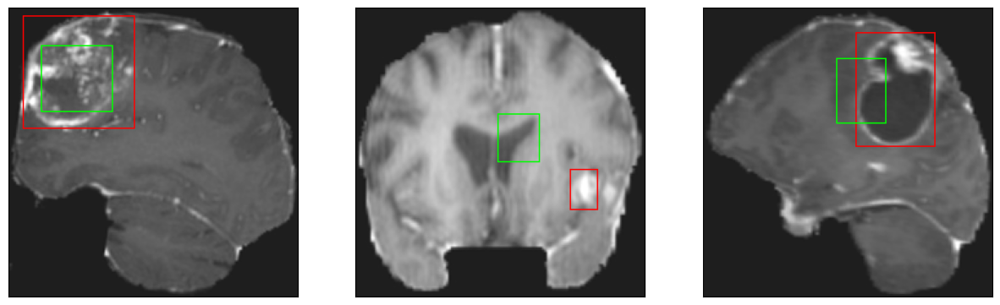

26/26 [==============================] - 3s 106ms/step - loss: 5.2166 - IoU: 0.6031 - val_loss: 9.8590 - val_IoU: 0.4633
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 5.5087 - IoU: 0.5884
Epoch 70: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


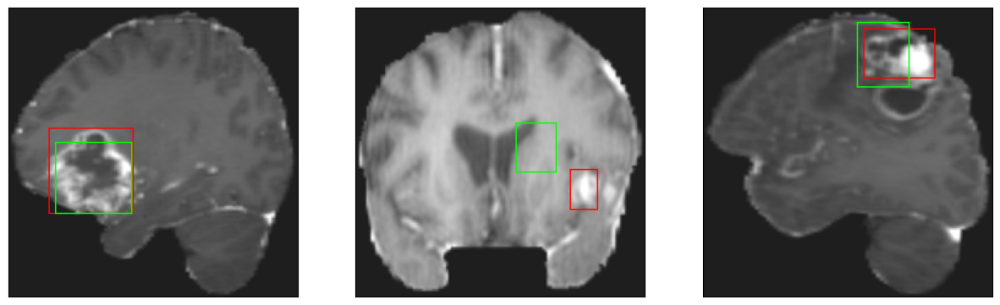

26/26 [==============================] - 3s 105ms/step - loss: 5.5087 - IoU: 0.5884 - val_loss: 10.1270 - val_IoU: 0.4438
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4220 - IoU: 0.5916
Epoch 71: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


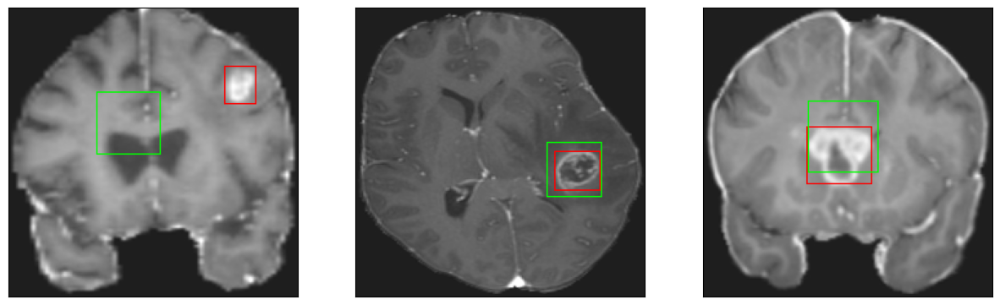

26/26 [==============================] - 3s 106ms/step - loss: 5.4521 - IoU: 0.5922 - val_loss: 10.3218 - val_IoU: 0.4254
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 5.2895 - IoU: 0.6003
Epoch 72: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


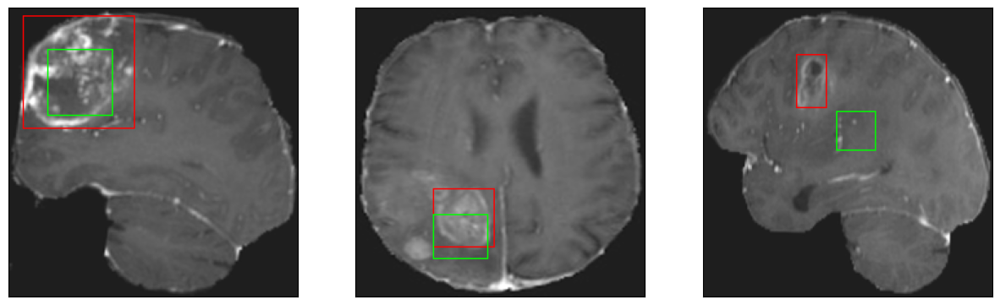

26/26 [==============================] - 3s 109ms/step - loss: 5.2895 - IoU: 0.6003 - val_loss: 11.2414 - val_IoU: 0.3899
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 5.3311 - IoU: 0.6044
Epoch 73: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


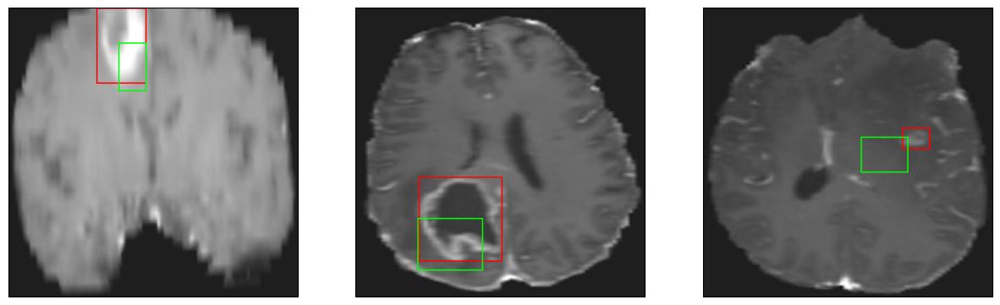

26/26 [==============================] - 3s 113ms/step - loss: 5.3311 - IoU: 0.6044 - val_loss: 10.4557 - val_IoU: 0.4188
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 5.2518 - IoU: 0.6011
Epoch 74: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


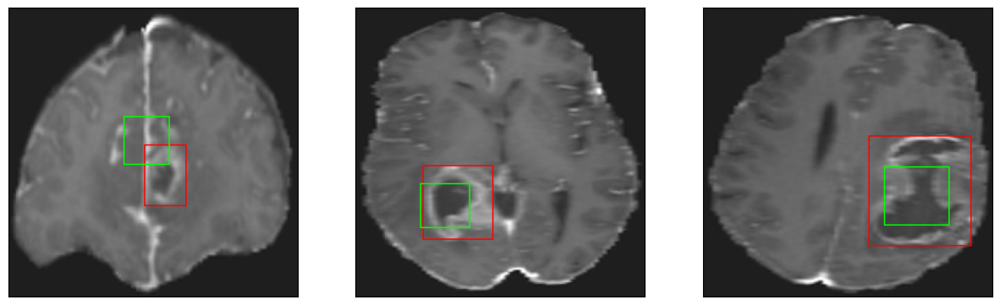

26/26 [==============================] - 3s 118ms/step - loss: 5.2518 - IoU: 0.6011 - val_loss: 10.1833 - val_IoU: 0.4371
Epoch 75/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1288 - IoU: 0.6115
Epoch 75: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


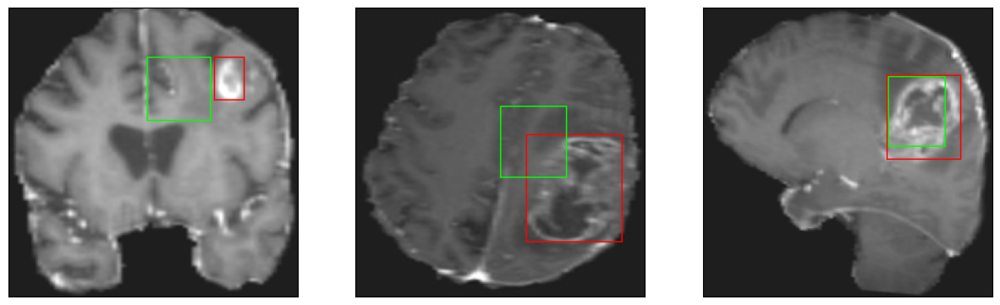

26/26 [==============================] - 3s 98ms/step - loss: 5.1196 - IoU: 0.6129 - val_loss: 12.4190 - val_IoU: 0.3553
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 5.4866 - IoU: 0.5927
Epoch 76: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


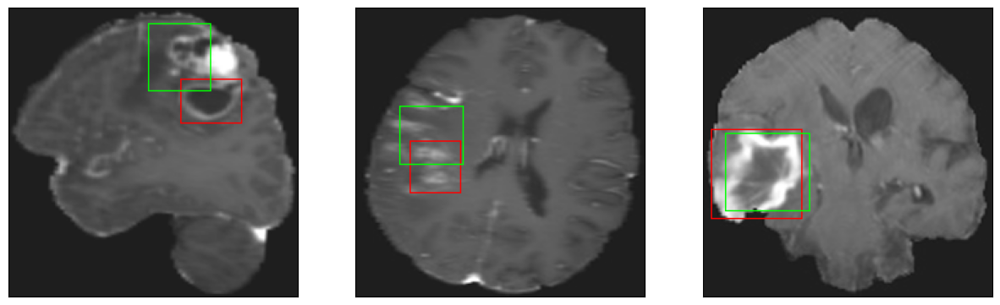

26/26 [==============================] - 3s 103ms/step - loss: 5.4866 - IoU: 0.5927 - val_loss: 10.8997 - val_IoU: 0.4190
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 5.5838 - IoU: 0.5846
Epoch 77: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


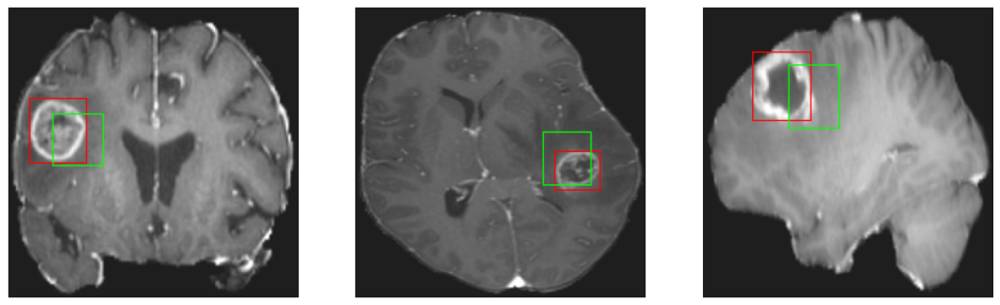

26/26 [==============================] - 3s 126ms/step - loss: 5.5838 - IoU: 0.5846 - val_loss: 10.7136 - val_IoU: 0.4168
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 5.3553 - IoU: 0.6021
Epoch 78: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


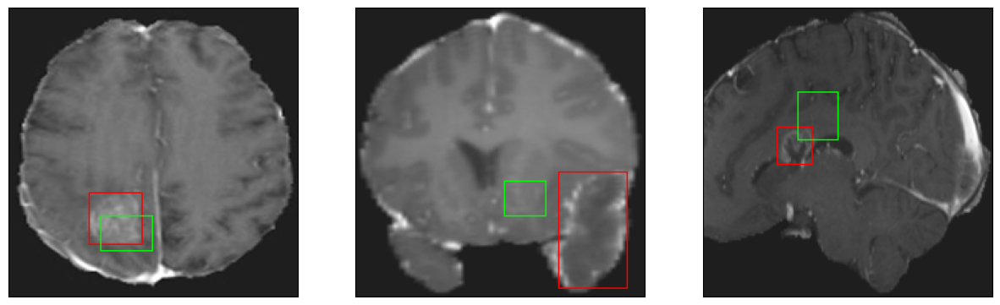

26/26 [==============================] - 3s 124ms/step - loss: 5.3553 - IoU: 0.6021 - val_loss: 9.8375 - val_IoU: 0.4496
Epoch 79/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2586 - IoU: 0.6120
Epoch 79: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


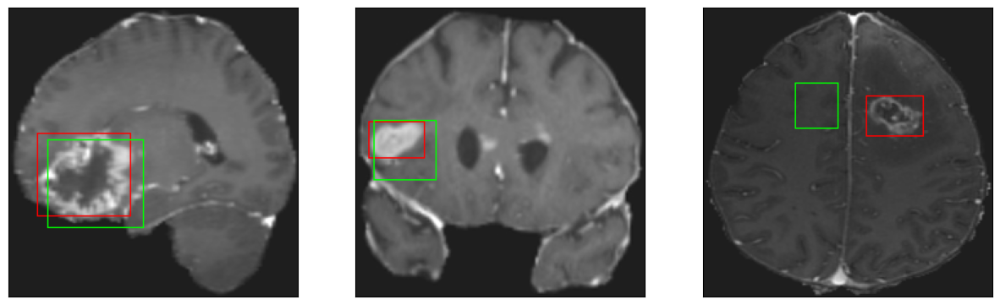

26/26 [==============================] - 3s 100ms/step - loss: 5.3023 - IoU: 0.6098 - val_loss: 13.3160 - val_IoU: 0.3406
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 5.3800 - IoU: 0.5950
Epoch 80: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


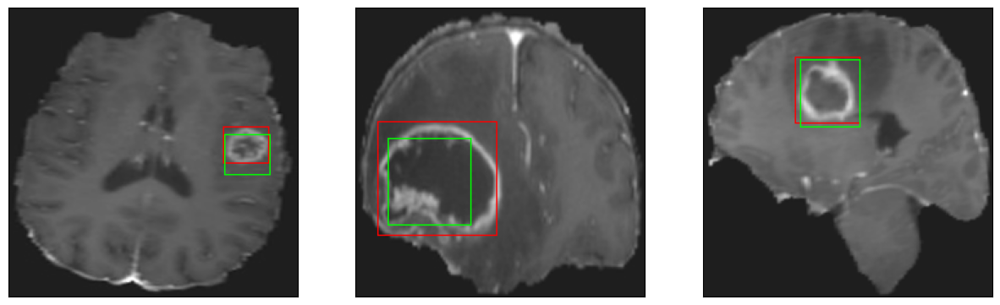

26/26 [==============================] - 3s 122ms/step - loss: 5.3800 - IoU: 0.5950 - val_loss: 10.1731 - val_IoU: 0.4215
Epoch 81/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2505 - IoU: 0.6039
Epoch 81: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


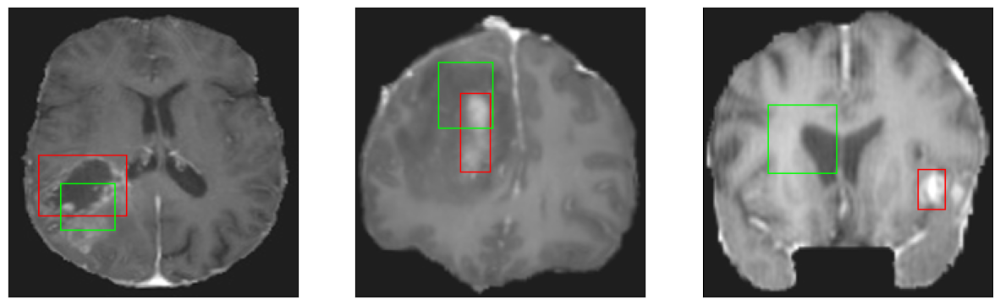

26/26 [==============================] - 3s 133ms/step - loss: 5.2958 - IoU: 0.6026 - val_loss: 11.1847 - val_IoU: 0.4129
Epoch 82/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0571 - IoU: 0.6124
Epoch 82: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


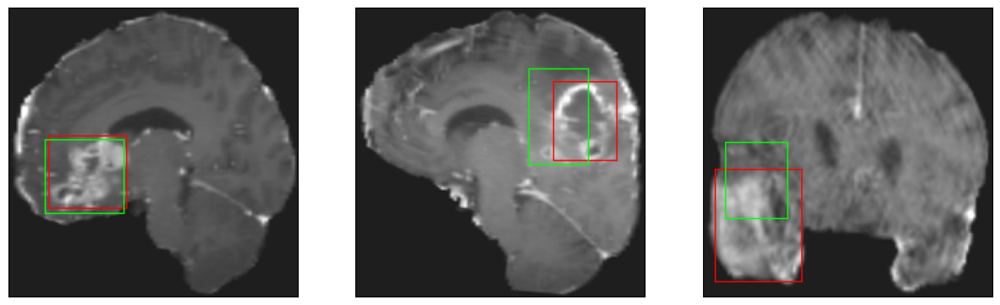

26/26 [==============================] - 2s 95ms/step - loss: 5.0070 - IoU: 0.6132 - val_loss: 10.1383 - val_IoU: 0.4553
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 5.0150 - IoU: 0.6173
Epoch 83: val_loss did not improve from 9.63908
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


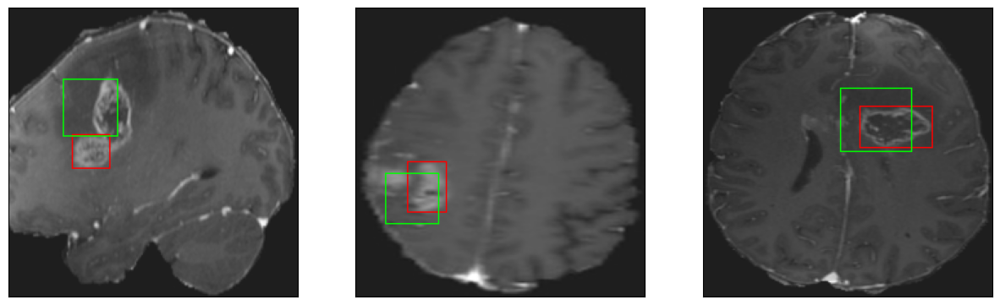

26/26 [==============================] - 3s 111ms/step - loss: 5.0150 - IoU: 0.6173 - val_loss: 11.2731 - val_IoU: 0.4243
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0249 - IoU: 0.6170
Epoch 84: val_loss improved from 9.63908 to 9.15677, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


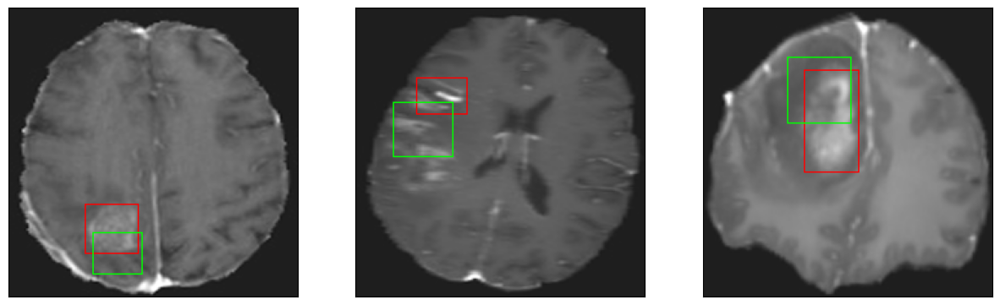

26/26 [==============================] - 4s 155ms/step - loss: 5.0330 - IoU: 0.6177 - val_loss: 9.1568 - val_IoU: 0.4884
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3018 - IoU: 0.6042
Epoch 85: val_loss did not improve from 9.15677
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


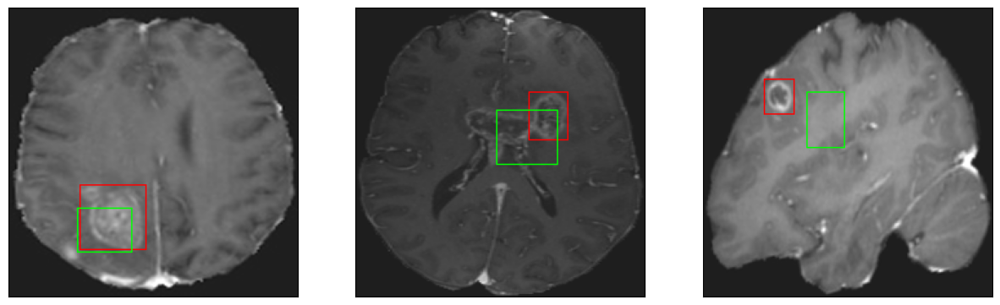

26/26 [==============================] - 3s 109ms/step - loss: 5.3321 - IoU: 0.6018 - val_loss: 10.6384 - val_IoU: 0.4331
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 5.0787 - IoU: 0.6146
Epoch 86: val_loss did not improve from 9.15677
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


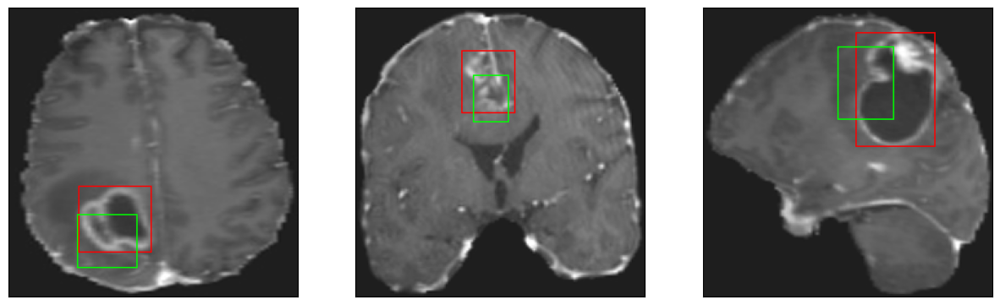

26/26 [==============================] - 3s 112ms/step - loss: 5.0787 - IoU: 0.6146 - val_loss: 9.1620 - val_IoU: 0.4919
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0684 - IoU: 0.6145
Epoch 87: val_loss did not improve from 9.15677
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


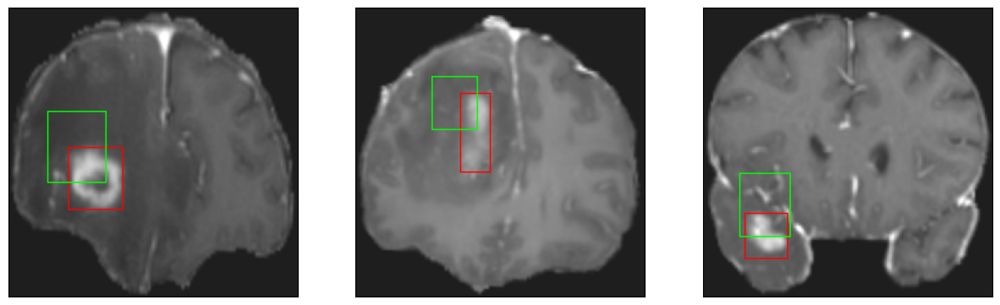

26/26 [==============================] - 3s 105ms/step - loss: 5.0844 - IoU: 0.6155 - val_loss: 9.9260 - val_IoU: 0.4515
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 4.8817 - IoU: 0.6188
Epoch 88: val_loss did not improve from 9.15677
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


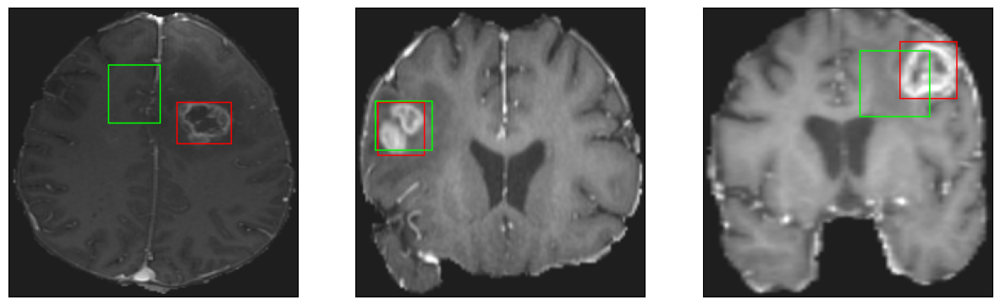

26/26 [==============================] - 3s 122ms/step - loss: 4.8817 - IoU: 0.6188 - val_loss: 9.9004 - val_IoU: 0.4569
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 5.0369 - IoU: 0.6127
Epoch 89: val_loss did not improve from 9.15677
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


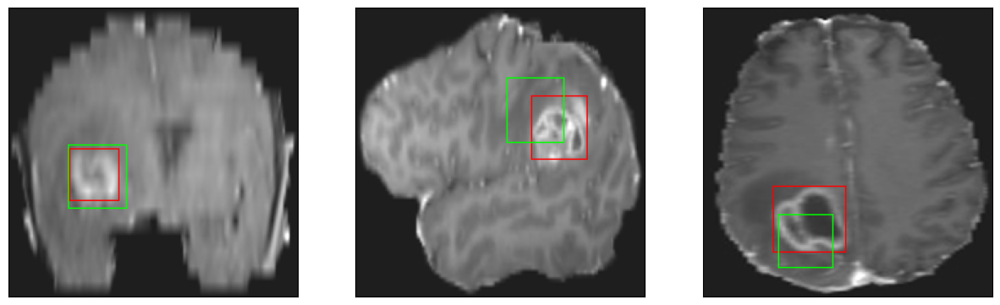

26/26 [==============================] - 3s 116ms/step - loss: 5.0369 - IoU: 0.6127 - val_loss: 9.8620 - val_IoU: 0.4534
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 4.9679 - IoU: 0.6153
Epoch 90: val_loss did not improve from 9.15677
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


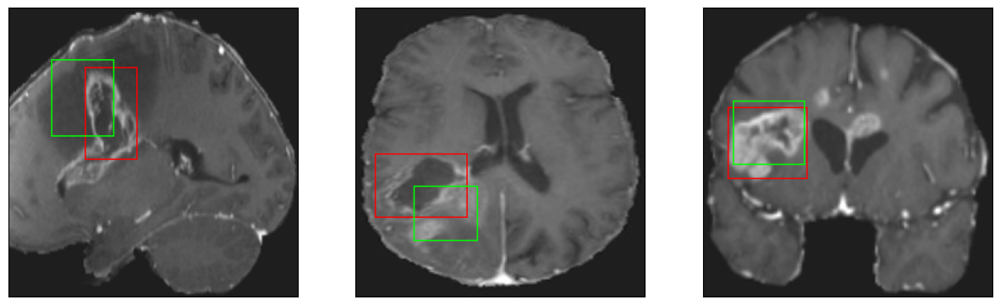

26/26 [==============================] - 3s 98ms/step - loss: 4.9679 - IoU: 0.6153 - val_loss: 9.6742 - val_IoU: 0.4863
Epoch 91/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8906 - IoU: 0.6293
Epoch 91: val_loss did not improve from 9.15677
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


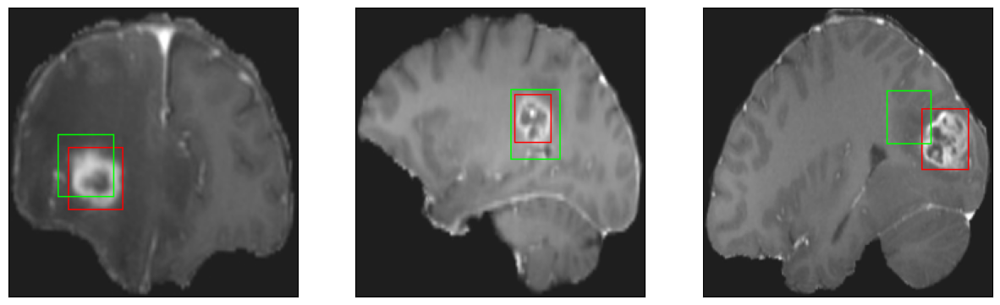

26/26 [==============================] - 2s 94ms/step - loss: 4.9120 - IoU: 0.6274 - val_loss: 12.9418 - val_IoU: 0.3366
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 4.9848 - IoU: 0.6115
Epoch 92: val_loss improved from 9.15677 to 9.01554, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


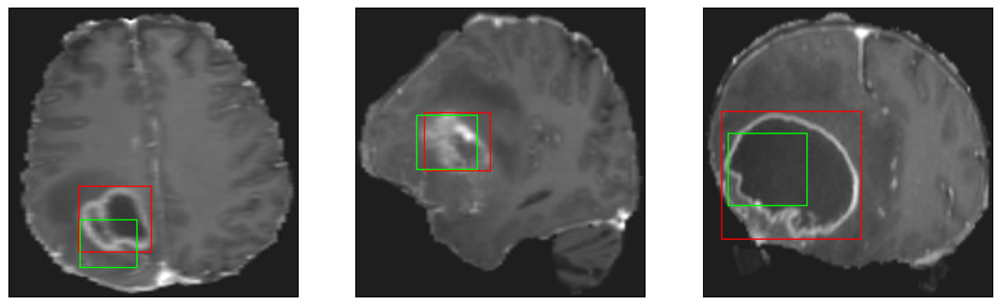

26/26 [==============================] - 4s 137ms/step - loss: 4.9848 - IoU: 0.6115 - val_loss: 9.0155 - val_IoU: 0.4927
Epoch 93/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0857 - IoU: 0.6142
Epoch 93: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


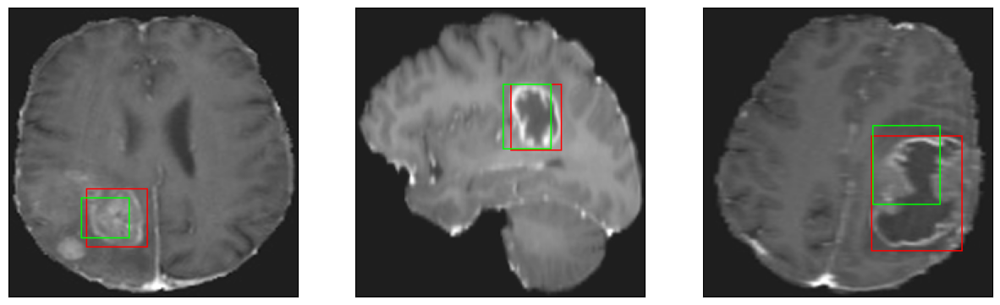

26/26 [==============================] - 4s 140ms/step - loss: 5.0535 - IoU: 0.6148 - val_loss: 11.4938 - val_IoU: 0.3871
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 4.8601 - IoU: 0.6293
Epoch 94: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


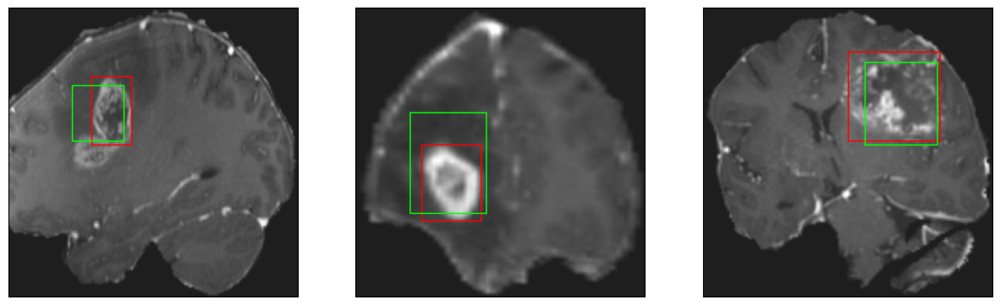

26/26 [==============================] - 3s 117ms/step - loss: 4.8601 - IoU: 0.6293 - val_loss: 10.4683 - val_IoU: 0.4432
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 4.8841 - IoU: 0.6221
Epoch 95: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


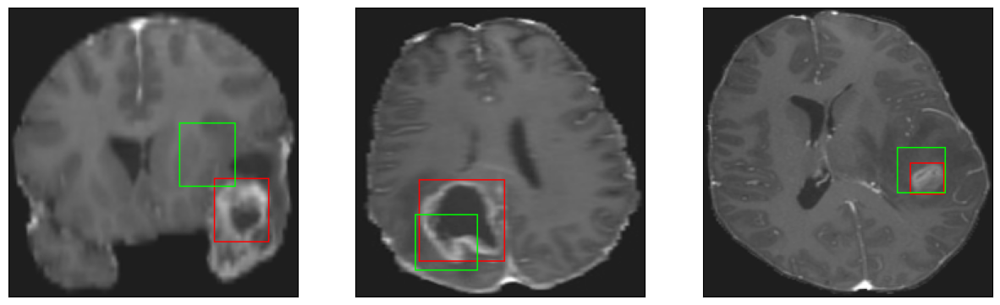

26/26 [==============================] - 3s 108ms/step - loss: 4.8841 - IoU: 0.6221 - val_loss: 10.2917 - val_IoU: 0.4471
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 4.6965 - IoU: 0.6311
Epoch 96: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


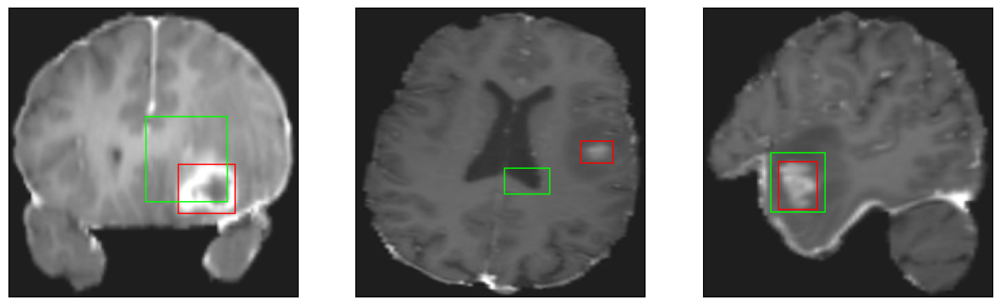

26/26 [==============================] - 4s 142ms/step - loss: 4.6965 - IoU: 0.6311 - val_loss: 10.8505 - val_IoU: 0.4159
Epoch 97/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8110 - IoU: 0.6353
Epoch 97: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


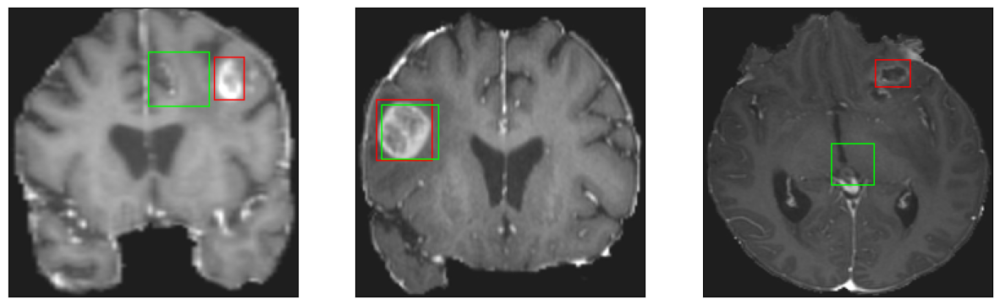

26/26 [==============================] - 3s 101ms/step - loss: 4.8374 - IoU: 0.6345 - val_loss: 9.9271 - val_IoU: 0.4474
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 4.9301 - IoU: 0.6235
Epoch 98: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


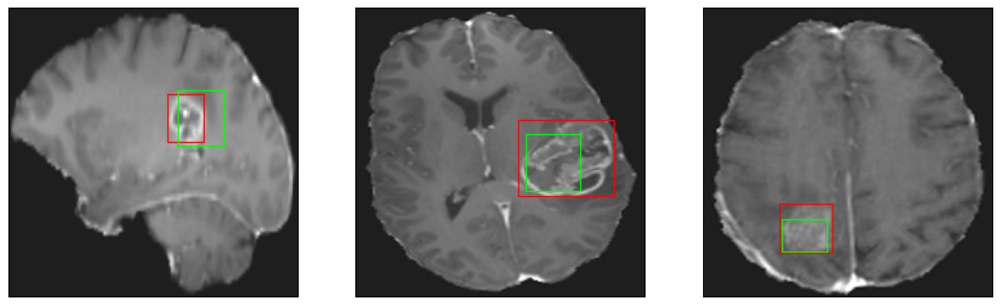

26/26 [==============================] - 3s 99ms/step - loss: 4.9301 - IoU: 0.6235 - val_loss: 10.2292 - val_IoU: 0.4468
Epoch 99/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8823 - IoU: 0.6286
Epoch 99: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


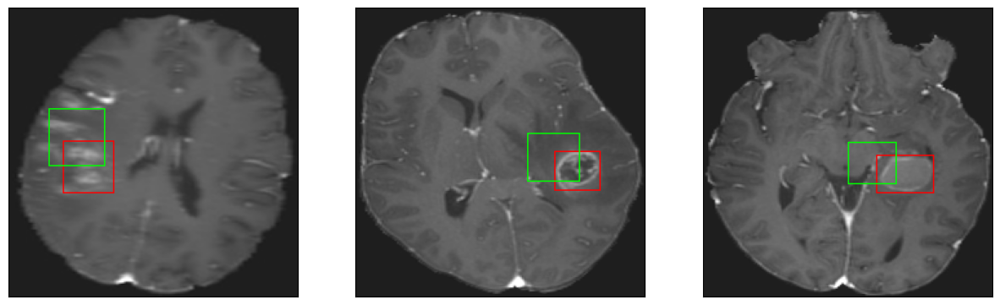

26/26 [==============================] - 3s 111ms/step - loss: 4.9129 - IoU: 0.6276 - val_loss: 10.6546 - val_IoU: 0.4168
Epoch 100/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7821 - IoU: 0.6360
Epoch 100: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


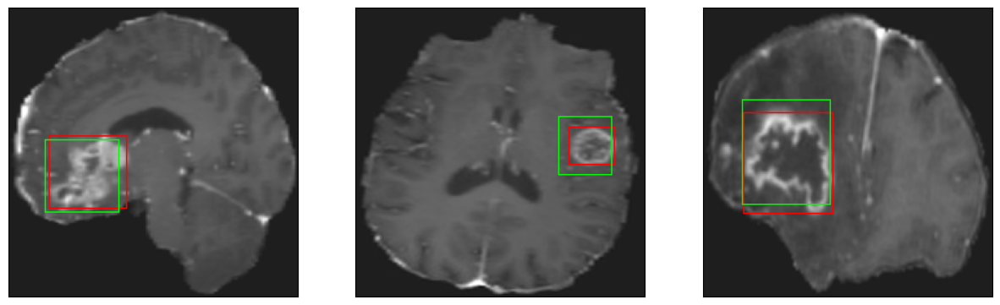

26/26 [==============================] - 3s 111ms/step - loss: 4.7639 - IoU: 0.6362 - val_loss: 9.7187 - val_IoU: 0.4612
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 4.9668 - IoU: 0.6088
Epoch 101: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


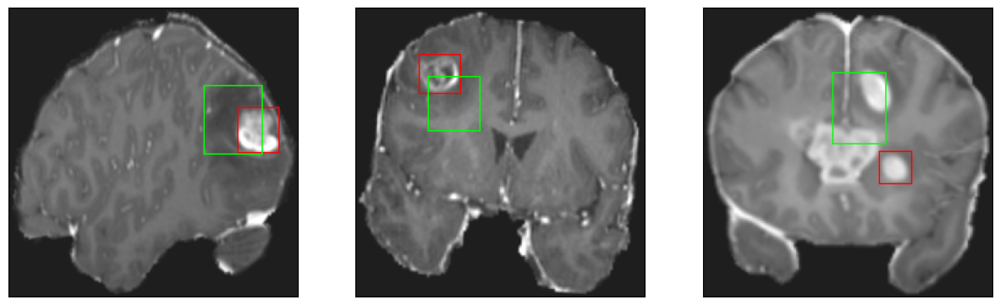

26/26 [==============================] - 3s 109ms/step - loss: 4.9668 - IoU: 0.6088 - val_loss: 9.7371 - val_IoU: 0.4554
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9013 - IoU: 0.6196
Epoch 102: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


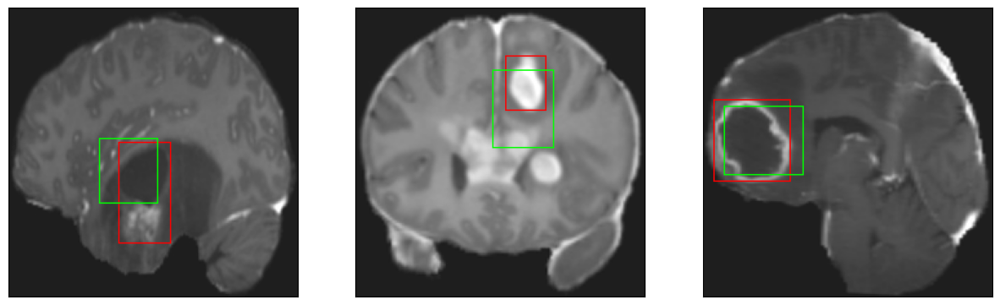

26/26 [==============================] - 2s 95ms/step - loss: 4.9039 - IoU: 0.6184 - val_loss: 10.0662 - val_IoU: 0.4535
Epoch 103/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7717 - IoU: 0.6321
Epoch 103: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


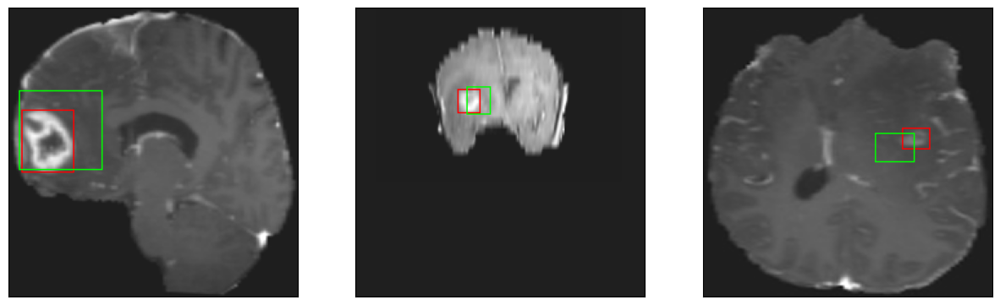

26/26 [==============================] - 3s 126ms/step - loss: 4.8302 - IoU: 0.6302 - val_loss: 9.4441 - val_IoU: 0.4875
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 4.8890 - IoU: 0.6287
Epoch 104: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


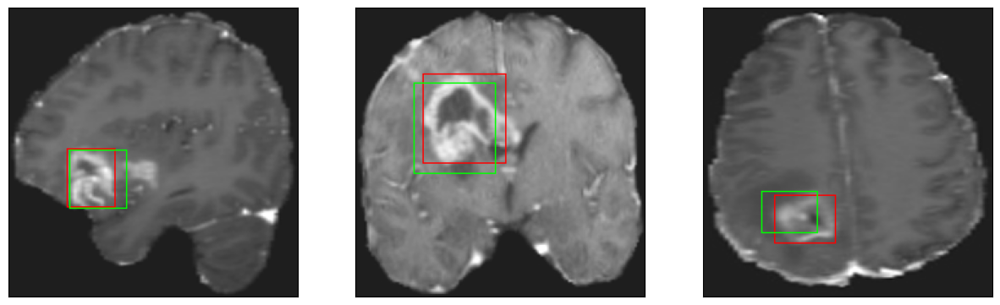

26/26 [==============================] - 3s 107ms/step - loss: 4.8890 - IoU: 0.6287 - val_loss: 9.6110 - val_IoU: 0.4713
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 4.8155 - IoU: 0.6286
Epoch 105: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


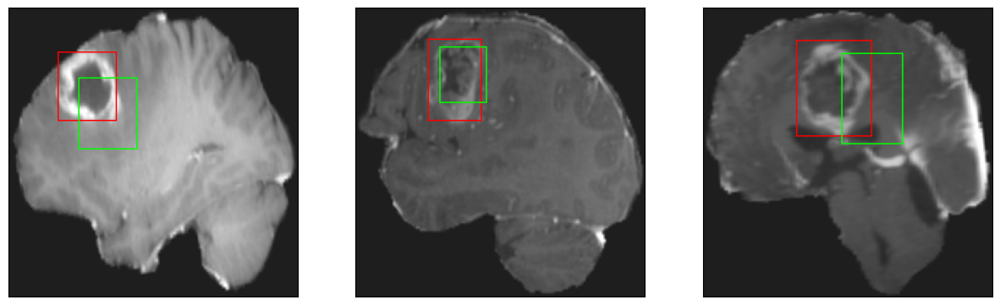

26/26 [==============================] - 3s 101ms/step - loss: 4.8155 - IoU: 0.6286 - val_loss: 10.8529 - val_IoU: 0.4063
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 4.8791 - IoU: 0.6252
Epoch 106: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


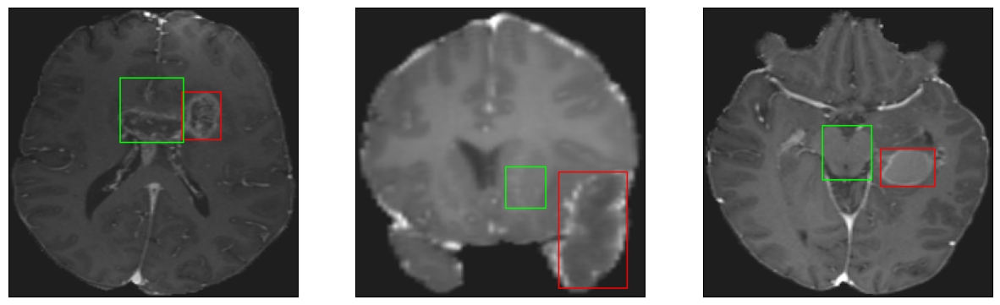

26/26 [==============================] - 3s 101ms/step - loss: 4.8791 - IoU: 0.6252 - val_loss: 10.4543 - val_IoU: 0.4259
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 4.6836 - IoU: 0.6371
Epoch 107: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


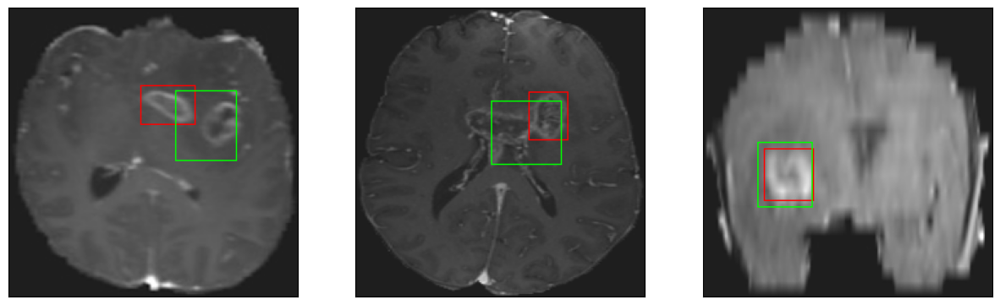

26/26 [==============================] - 3s 114ms/step - loss: 4.6836 - IoU: 0.6371 - val_loss: 10.7647 - val_IoU: 0.4277
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 4.7285 - IoU: 0.6346
Epoch 108: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


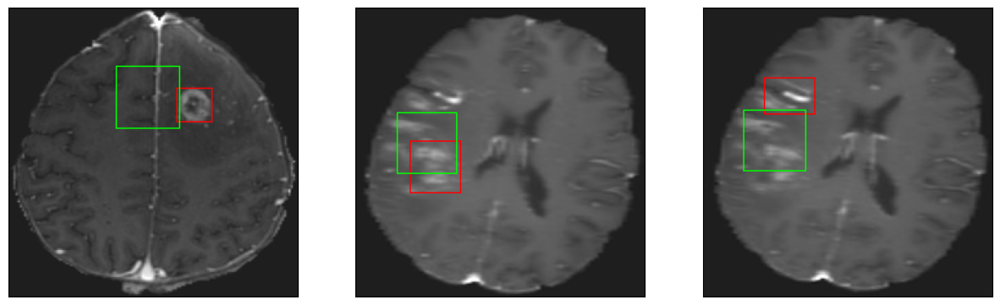

26/26 [==============================] - 3s 104ms/step - loss: 4.7285 - IoU: 0.6346 - val_loss: 9.8190 - val_IoU: 0.4704
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 4.7166 - IoU: 0.6341
Epoch 109: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


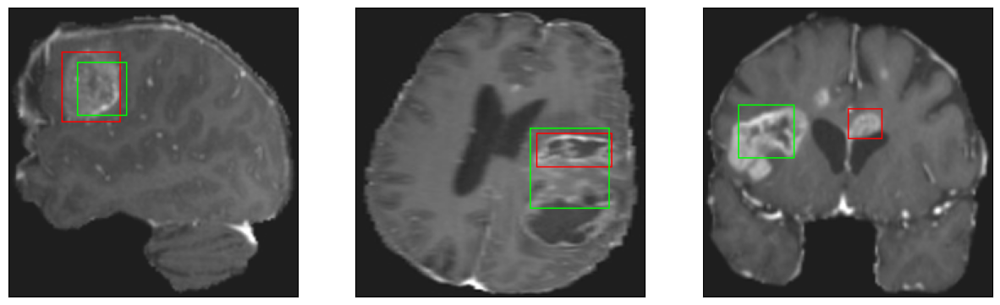

26/26 [==============================] - 3s 99ms/step - loss: 4.7166 - IoU: 0.6341 - val_loss: 9.7237 - val_IoU: 0.4682
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9623 - IoU: 0.6199
Epoch 110: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


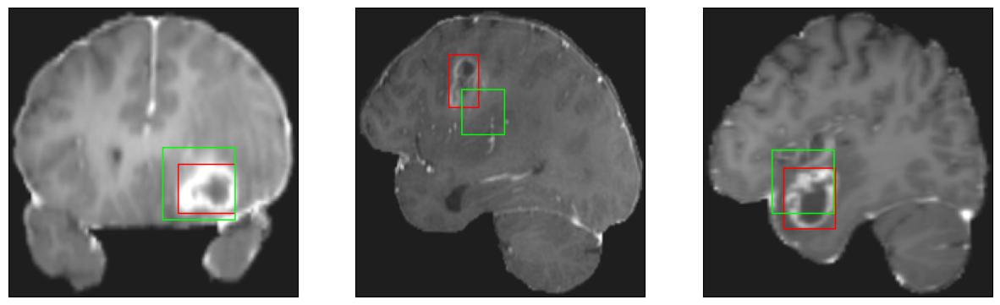

26/26 [==============================] - 3s 97ms/step - loss: 4.9646 - IoU: 0.6187 - val_loss: 9.3587 - val_IoU: 0.4799
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6683 - IoU: 0.6339
Epoch 111: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


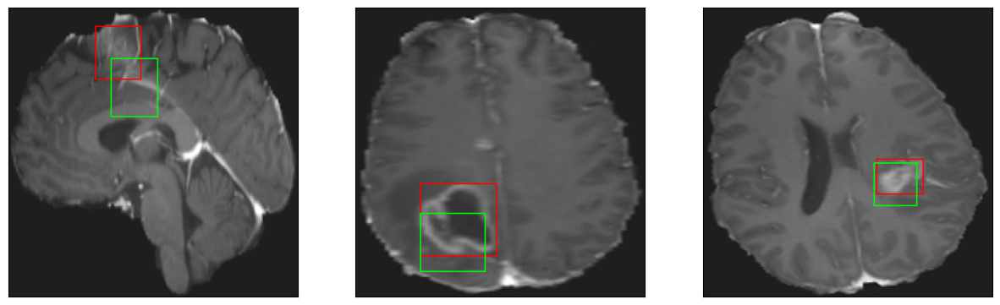

26/26 [==============================] - 3s 123ms/step - loss: 4.6645 - IoU: 0.6328 - val_loss: 10.5744 - val_IoU: 0.4322
Epoch 112/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7031 - IoU: 0.6346
Epoch 112: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


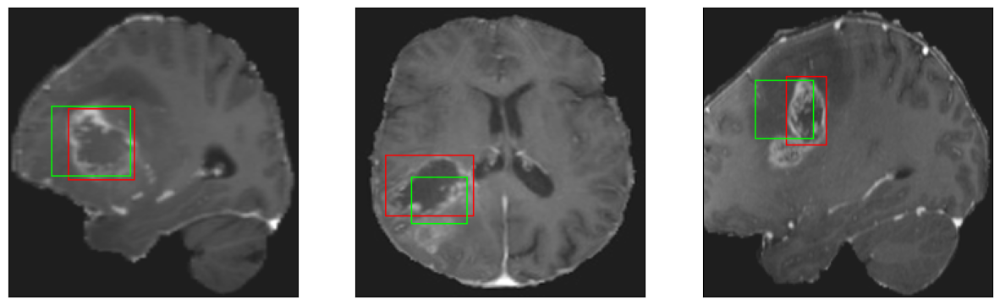

26/26 [==============================] - 2s 96ms/step - loss: 4.6861 - IoU: 0.6352 - val_loss: 9.9028 - val_IoU: 0.4745
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 4.8323 - IoU: 0.6296
Epoch 113: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


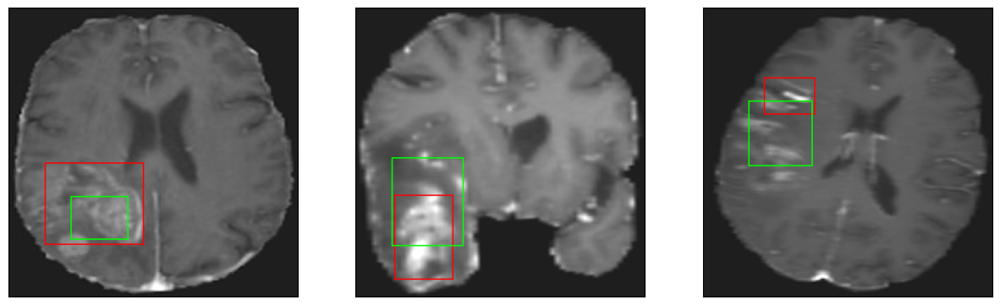

26/26 [==============================] - 3s 101ms/step - loss: 4.8323 - IoU: 0.6296 - val_loss: 10.0705 - val_IoU: 0.4643
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 4.5567 - IoU: 0.6439
Epoch 114: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


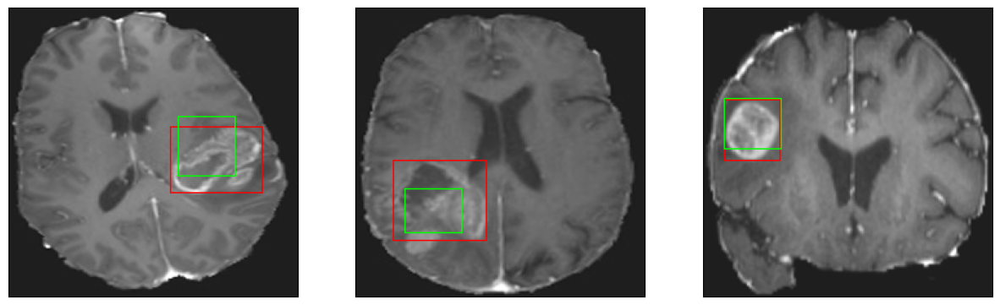

26/26 [==============================] - 3s 102ms/step - loss: 4.5567 - IoU: 0.6439 - val_loss: 13.0357 - val_IoU: 0.3357
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6212 - IoU: 0.6366
Epoch 115: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


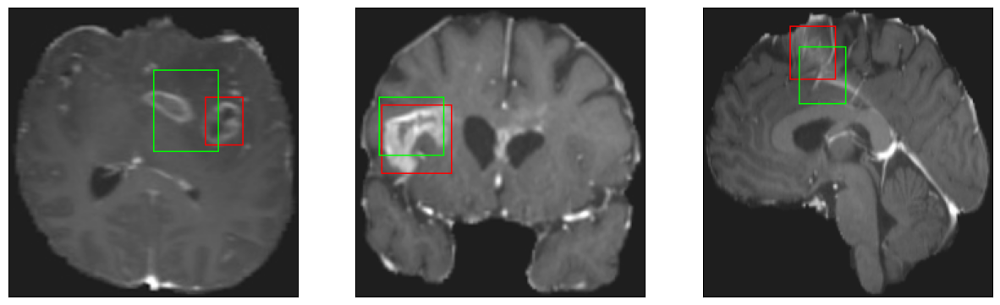

26/26 [==============================] - 3s 124ms/step - loss: 4.6197 - IoU: 0.6377 - val_loss: 9.6532 - val_IoU: 0.4661
Epoch 116/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7424 - IoU: 0.6322
Epoch 116: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


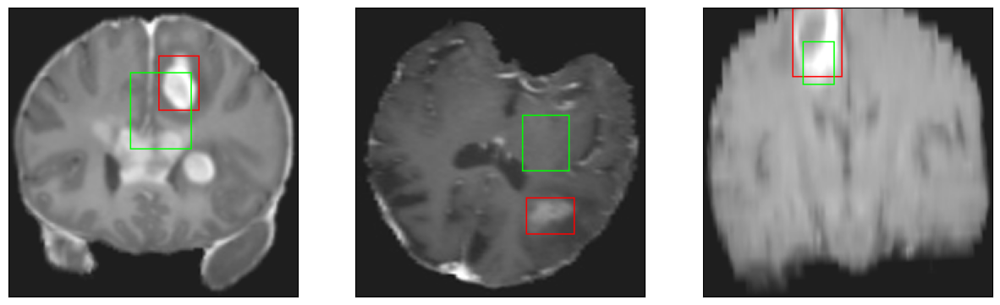

26/26 [==============================] - 3s 117ms/step - loss: 4.7268 - IoU: 0.6319 - val_loss: 9.8552 - val_IoU: 0.4663
Epoch 117/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6098 - IoU: 0.6373
Epoch 117: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


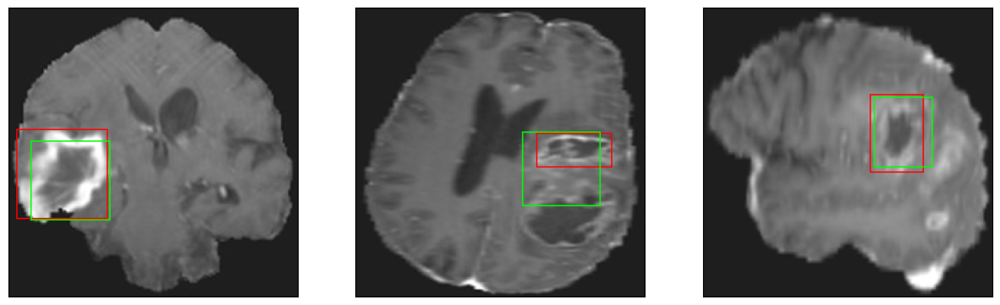

26/26 [==============================] - 3s 109ms/step - loss: 4.6008 - IoU: 0.6384 - val_loss: 9.5609 - val_IoU: 0.4677
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 4.7394 - IoU: 0.6375
Epoch 118: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


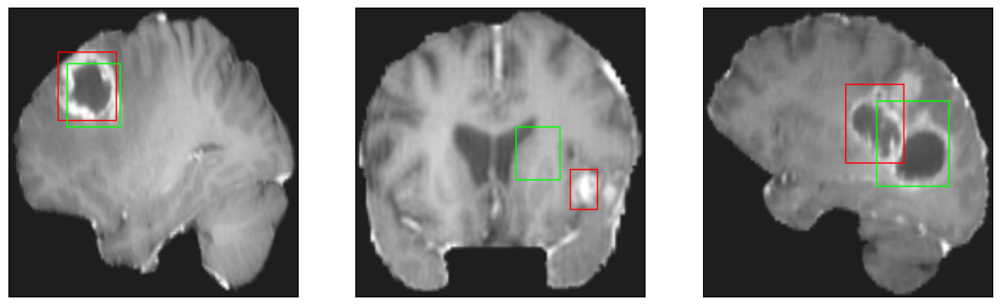

26/26 [==============================] - 3s 127ms/step - loss: 4.7394 - IoU: 0.6375 - val_loss: 9.5461 - val_IoU: 0.4663
Epoch 119/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5699 - IoU: 0.6466
Epoch 119: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


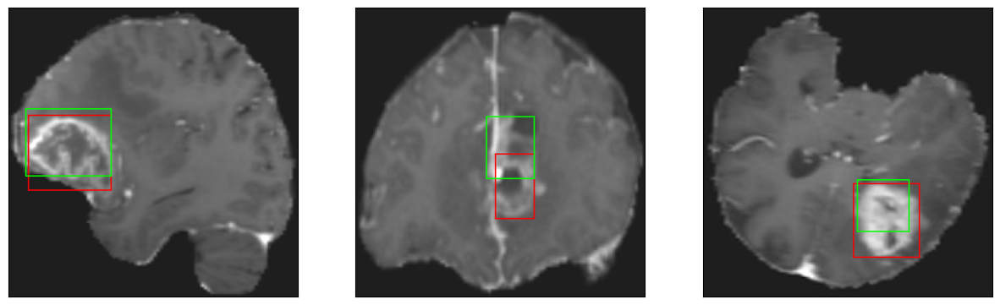

26/26 [==============================] - 3s 113ms/step - loss: 4.6031 - IoU: 0.6448 - val_loss: 9.7577 - val_IoU: 0.4554
Epoch 120/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7105 - IoU: 0.6299
Epoch 120: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


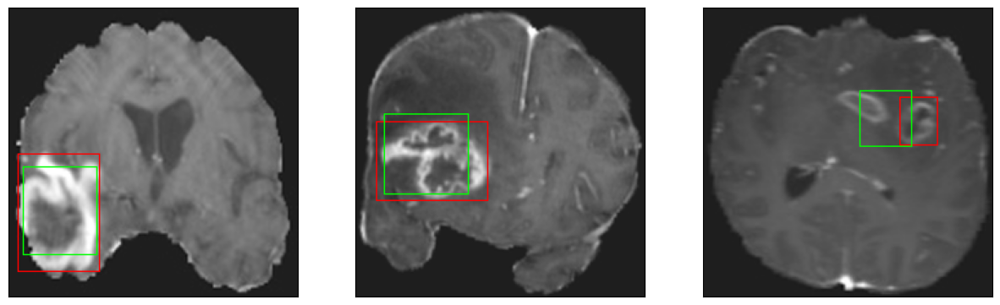

26/26 [==============================] - 3s 108ms/step - loss: 4.7458 - IoU: 0.6281 - val_loss: 9.9245 - val_IoU: 0.4513
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 4.6104 - IoU: 0.6421
Epoch 121: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


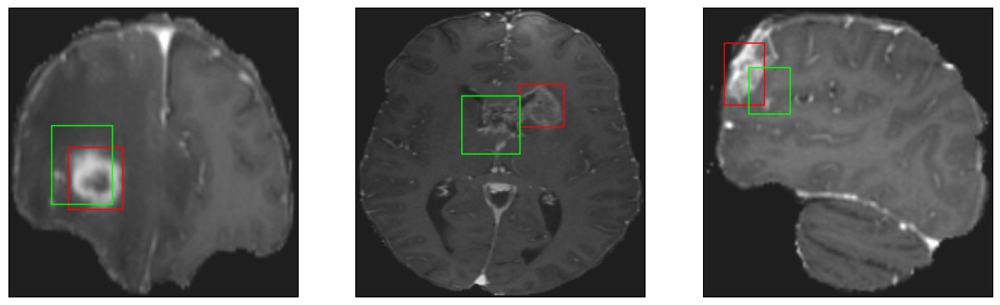

26/26 [==============================] - 3s 111ms/step - loss: 4.6104 - IoU: 0.6421 - val_loss: 9.6677 - val_IoU: 0.4619
Epoch 122/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7473 - IoU: 0.6293
Epoch 122: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


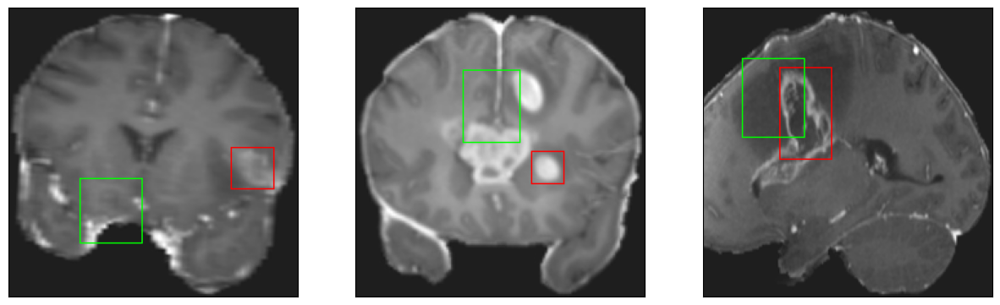

26/26 [==============================] - 3s 122ms/step - loss: 4.7439 - IoU: 0.6286 - val_loss: 9.7097 - val_IoU: 0.4592
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 4.5017 - IoU: 0.6435
Epoch 123: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


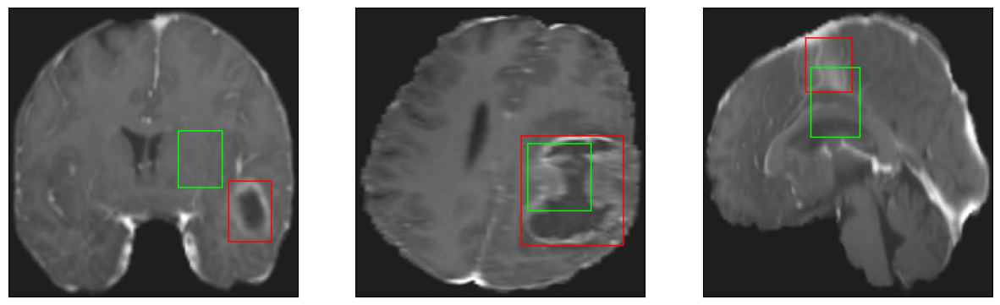

26/26 [==============================] - 2s 95ms/step - loss: 4.5017 - IoU: 0.6435 - val_loss: 10.3726 - val_IoU: 0.4180
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 4.5146 - IoU: 0.6429
Epoch 124: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


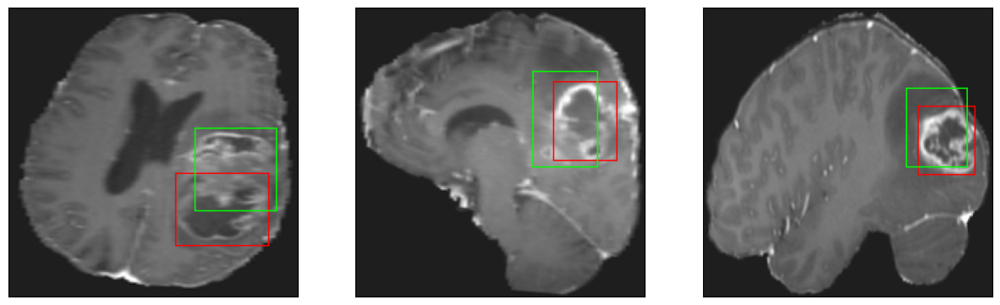

26/26 [==============================] - 3s 99ms/step - loss: 4.5146 - IoU: 0.6429 - val_loss: 10.1351 - val_IoU: 0.4568
Epoch 125/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5477 - IoU: 0.6493
Epoch 125: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


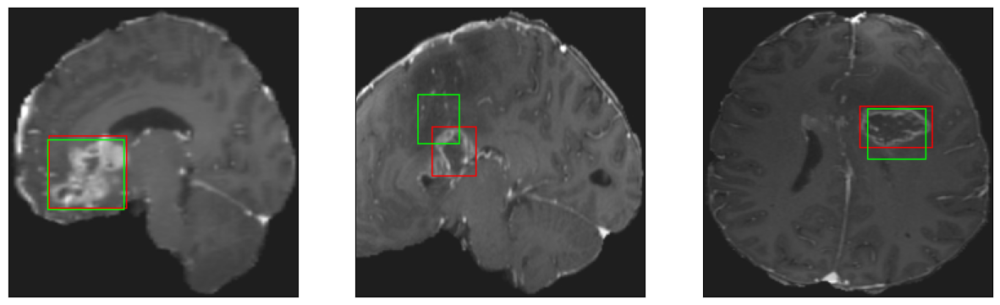

26/26 [==============================] - 2s 91ms/step - loss: 4.5545 - IoU: 0.6480 - val_loss: 9.9626 - val_IoU: 0.4578
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 4.4392 - IoU: 0.6549
Epoch 126: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


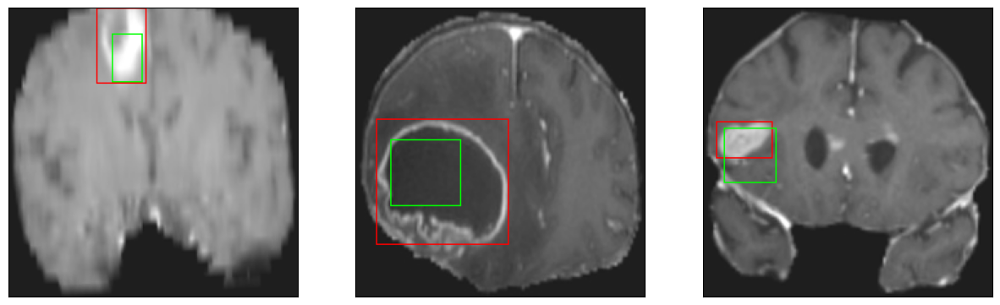

26/26 [==============================] - 3s 113ms/step - loss: 4.4392 - IoU: 0.6549 - val_loss: 9.5641 - val_IoU: 0.4595
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 4.4602 - IoU: 0.6509
Epoch 127: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


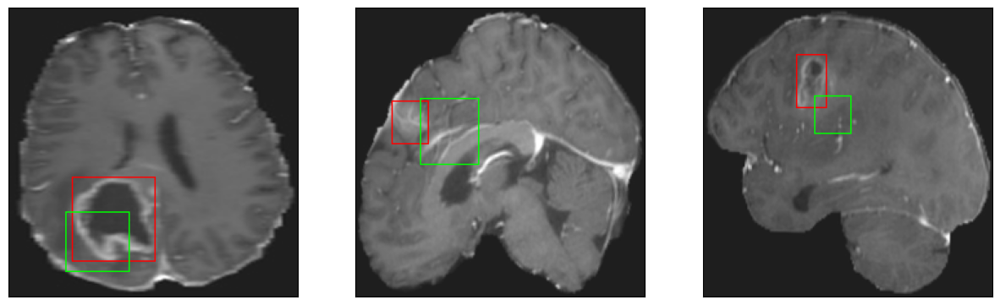

26/26 [==============================] - 3s 111ms/step - loss: 4.4602 - IoU: 0.6509 - val_loss: 9.4936 - val_IoU: 0.4823
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 4.5402 - IoU: 0.6477
Epoch 128: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


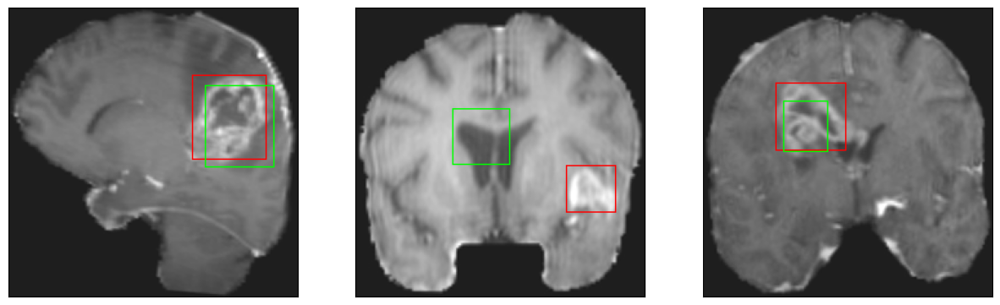

26/26 [==============================] - 3s 96ms/step - loss: 4.5402 - IoU: 0.6477 - val_loss: 10.1519 - val_IoU: 0.4144
Epoch 129/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4838 - IoU: 0.6505
Epoch 129: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


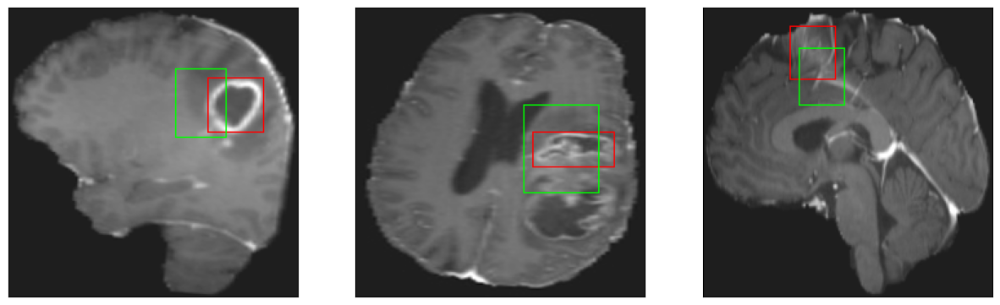

26/26 [==============================] - 3s 102ms/step - loss: 4.5299 - IoU: 0.6500 - val_loss: 12.1626 - val_IoU: 0.3577
Epoch 130/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5065 - IoU: 0.6468
Epoch 130: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


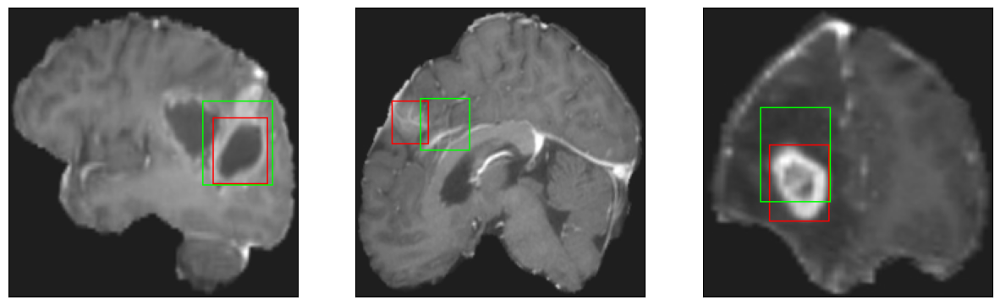

26/26 [==============================] - 3s 126ms/step - loss: 4.4735 - IoU: 0.6478 - val_loss: 10.0031 - val_IoU: 0.4344
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 4.5481 - IoU: 0.6405
Epoch 131: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


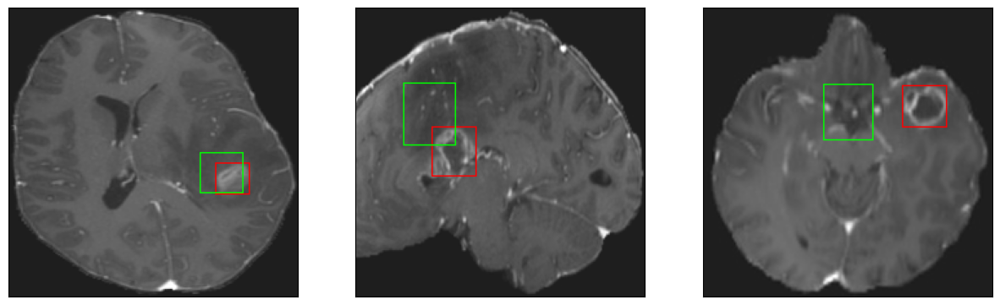

26/26 [==============================] - 3s 121ms/step - loss: 4.5481 - IoU: 0.6405 - val_loss: 12.0404 - val_IoU: 0.3766
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 4.5201 - IoU: 0.6441
Epoch 132: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


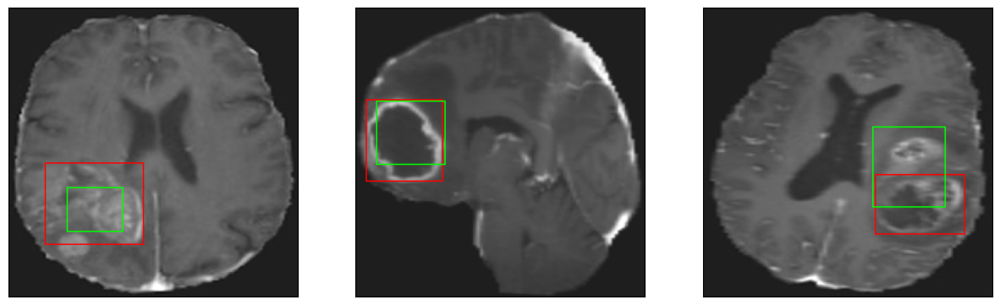

26/26 [==============================] - 2s 90ms/step - loss: 4.5201 - IoU: 0.6441 - val_loss: 10.0416 - val_IoU: 0.4557
Epoch 133/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6200 - IoU: 0.6422
Epoch 133: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


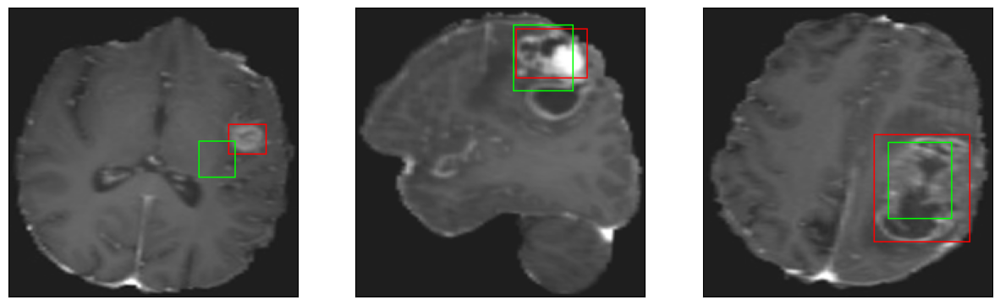

26/26 [==============================] - 3s 105ms/step - loss: 4.5759 - IoU: 0.6439 - val_loss: 11.3726 - val_IoU: 0.4105
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4939 - IoU: 0.6511
Epoch 134: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


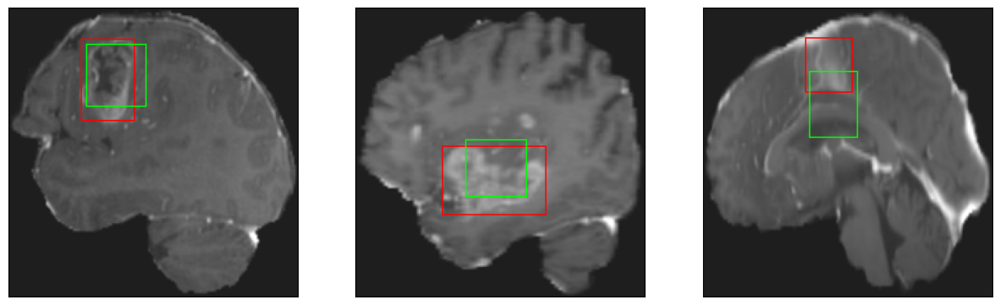

26/26 [==============================] - 2s 91ms/step - loss: 4.5029 - IoU: 0.6497 - val_loss: 9.8841 - val_IoU: 0.4597
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 4.7688 - IoU: 0.6352
Epoch 135: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


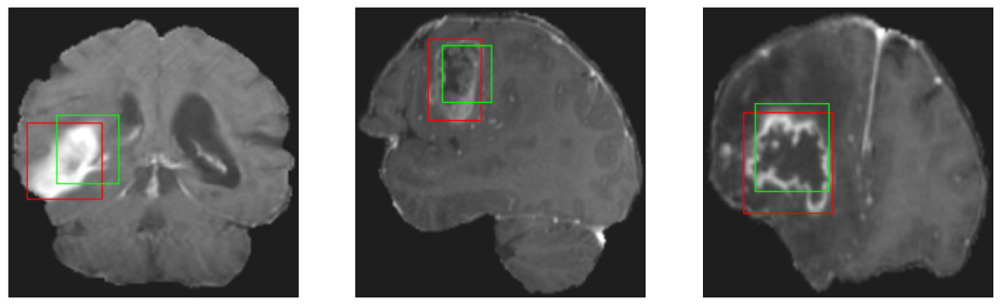

26/26 [==============================] - 3s 127ms/step - loss: 4.7688 - IoU: 0.6352 - val_loss: 11.0155 - val_IoU: 0.4047
Epoch 136/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5959 - IoU: 0.6412
Epoch 136: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


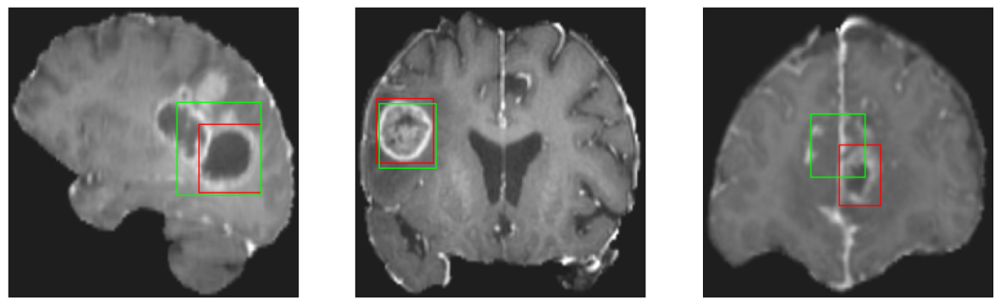

26/26 [==============================] - 3s 126ms/step - loss: 4.5699 - IoU: 0.6412 - val_loss: 9.3626 - val_IoU: 0.4783
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 4.4698 - IoU: 0.6527
Epoch 137: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


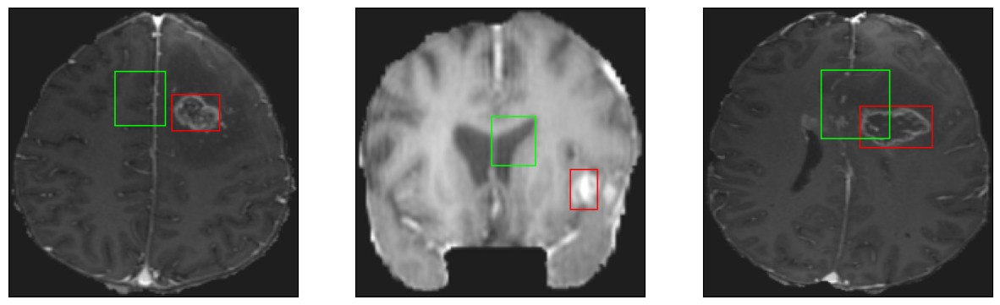

26/26 [==============================] - 3s 108ms/step - loss: 4.4698 - IoU: 0.6527 - val_loss: 9.9174 - val_IoU: 0.4548
Epoch 138/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3889 - IoU: 0.6623
Epoch 138: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


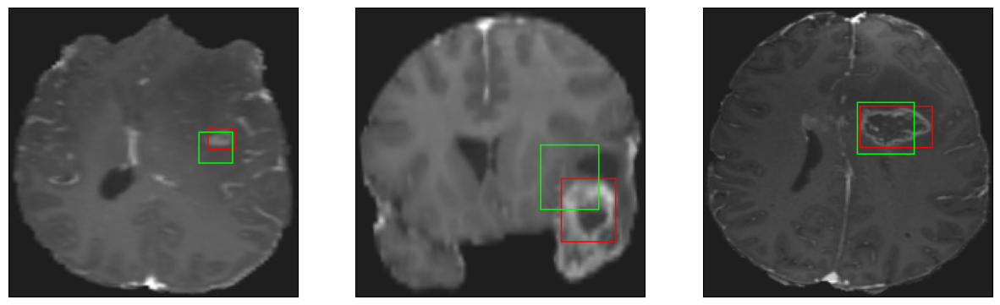

26/26 [==============================] - 3s 105ms/step - loss: 4.3859 - IoU: 0.6610 - val_loss: 9.4499 - val_IoU: 0.4621
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 4.4937 - IoU: 0.6508
Epoch 139: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


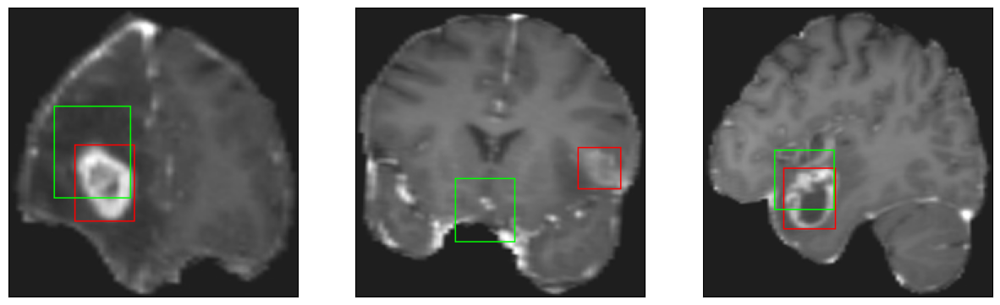

26/26 [==============================] - 3s 123ms/step - loss: 4.4937 - IoU: 0.6508 - val_loss: 9.3672 - val_IoU: 0.4788
Epoch 140/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5857 - IoU: 0.6369
Epoch 140: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


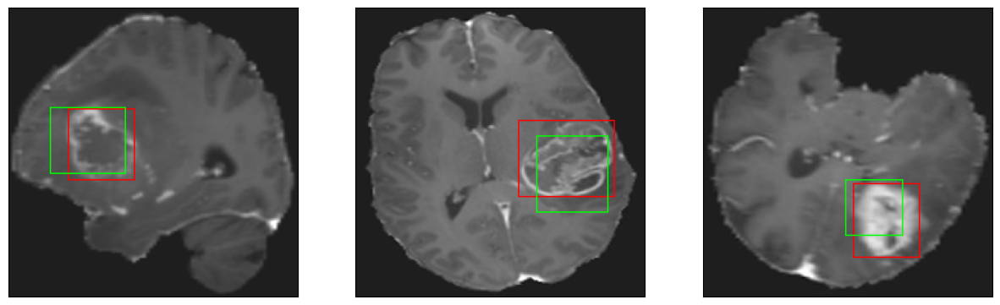

26/26 [==============================] - 3s 130ms/step - loss: 4.5679 - IoU: 0.6386 - val_loss: 10.7989 - val_IoU: 0.4294
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 4.6303 - IoU: 0.6351
Epoch 141: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


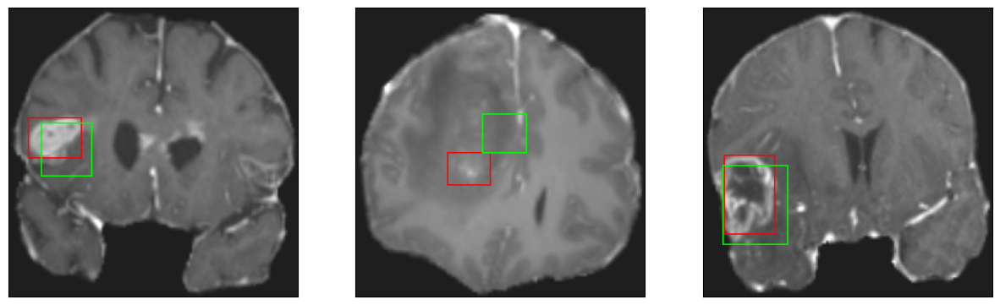

26/26 [==============================] - 3s 98ms/step - loss: 4.6303 - IoU: 0.6351 - val_loss: 10.4181 - val_IoU: 0.4445
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 4.4508 - IoU: 0.6484
Epoch 142: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


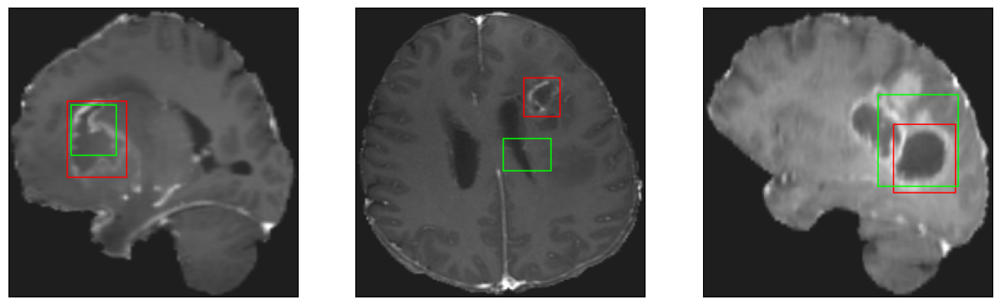

26/26 [==============================] - 3s 102ms/step - loss: 4.4508 - IoU: 0.6484 - val_loss: 9.2888 - val_IoU: 0.4886
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 4.4772 - IoU: 0.6506
Epoch 143: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


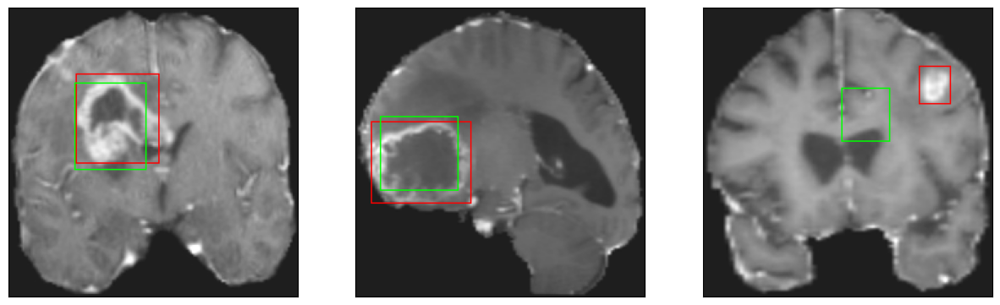

26/26 [==============================] - 3s 127ms/step - loss: 4.4772 - IoU: 0.6506 - val_loss: 10.0652 - val_IoU: 0.4414
Epoch 144/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5230 - IoU: 0.6388
Epoch 144: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


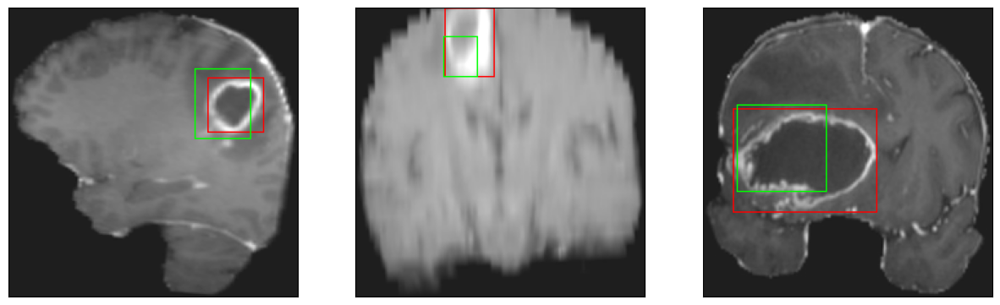

26/26 [==============================] - 3s 114ms/step - loss: 4.5458 - IoU: 0.6394 - val_loss: 10.2502 - val_IoU: 0.4452
Epoch 145/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4533 - IoU: 0.6562
Epoch 145: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


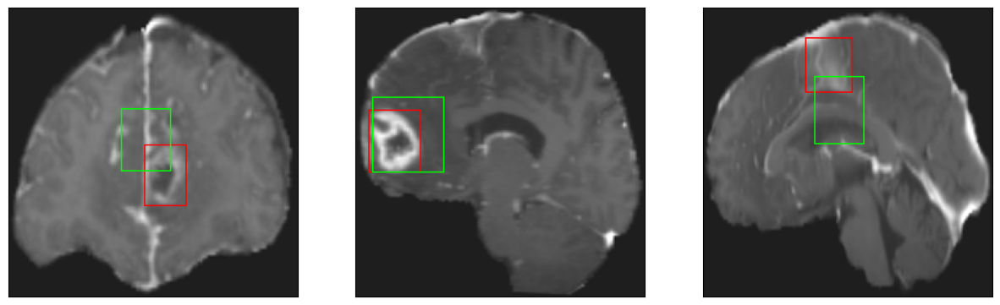

26/26 [==============================] - 2s 94ms/step - loss: 4.4324 - IoU: 0.6569 - val_loss: 9.7116 - val_IoU: 0.4622
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 4.4383 - IoU: 0.6523
Epoch 146: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 7ms/step
4


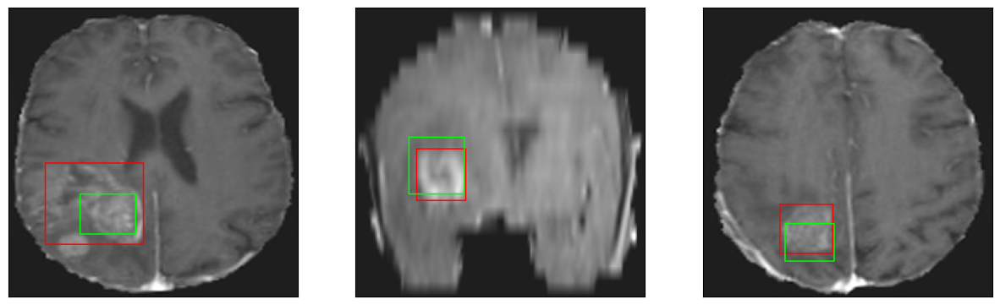

26/26 [==============================] - 3s 131ms/step - loss: 4.4383 - IoU: 0.6523 - val_loss: 10.2664 - val_IoU: 0.4397
Epoch 147/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6972 - IoU: 0.6375
Epoch 147: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


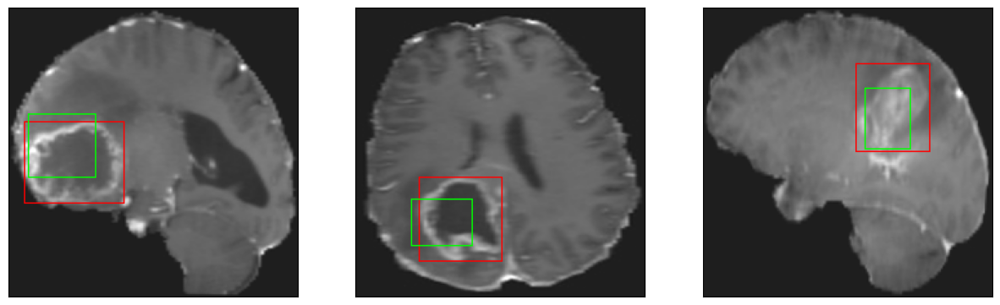

26/26 [==============================] - 3s 111ms/step - loss: 4.6315 - IoU: 0.6407 - val_loss: 13.1989 - val_IoU: 0.3317
Epoch 148/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3638 - IoU: 0.6549
Epoch 148: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


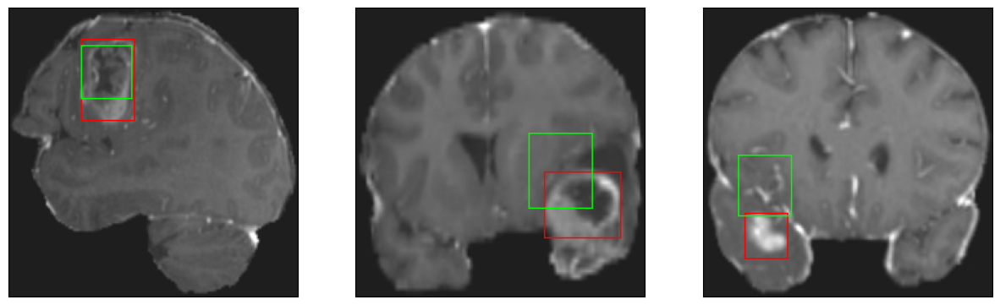

26/26 [==============================] - 3s 101ms/step - loss: 4.3480 - IoU: 0.6566 - val_loss: 12.8811 - val_IoU: 0.3485
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 4.4282 - IoU: 0.6460
Epoch 149: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


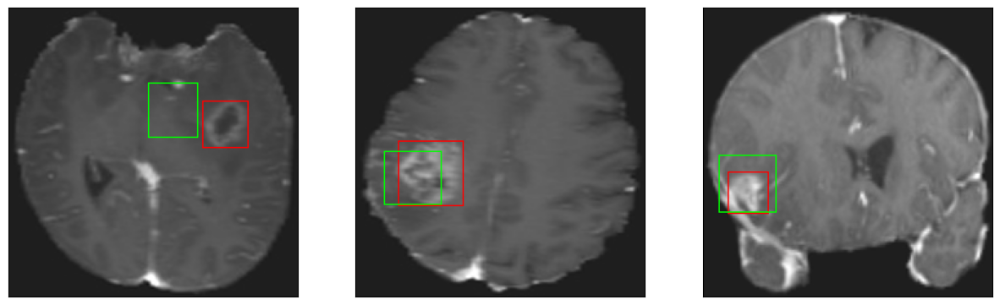

26/26 [==============================] - 3s 112ms/step - loss: 4.4282 - IoU: 0.6460 - val_loss: 10.3939 - val_IoU: 0.4359
Epoch 150/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4158 - IoU: 0.6507
Epoch 150: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


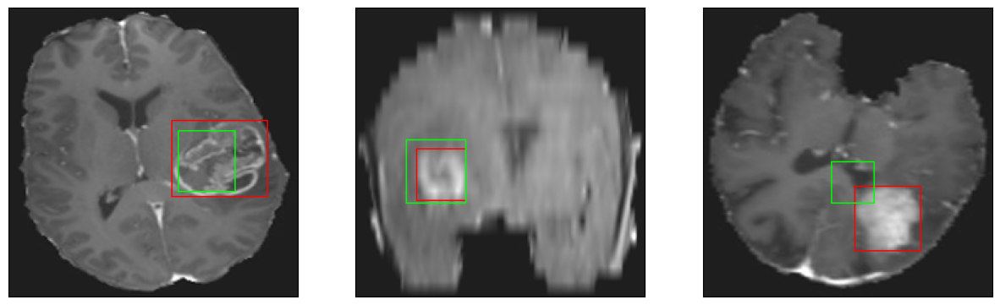

26/26 [==============================] - 3s 112ms/step - loss: 4.3867 - IoU: 0.6527 - val_loss: 9.5491 - val_IoU: 0.4768
Epoch 151/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5887 - IoU: 0.6480
Epoch 151: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


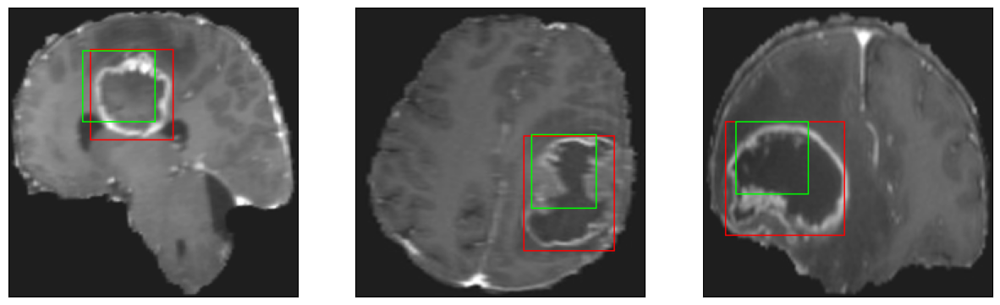

26/26 [==============================] - 3s 123ms/step - loss: 4.5970 - IoU: 0.6473 - val_loss: 12.8892 - val_IoU: 0.3339
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 4.5141 - IoU: 0.6520
Epoch 152: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


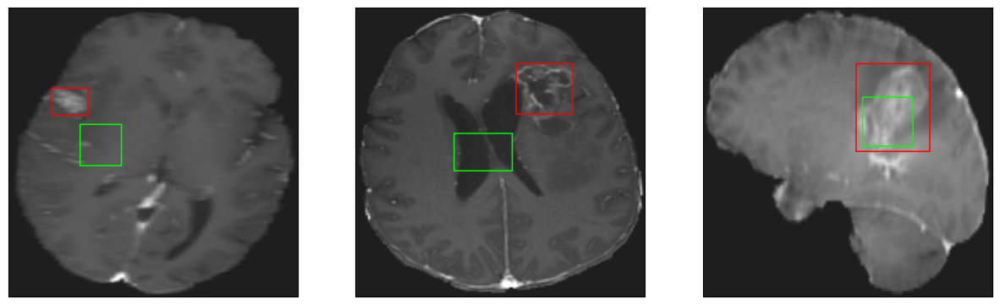

26/26 [==============================] - 3s 127ms/step - loss: 4.5141 - IoU: 0.6520 - val_loss: 9.6230 - val_IoU: 0.4818
Epoch 153/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6733 - IoU: 0.6493
Epoch 153: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


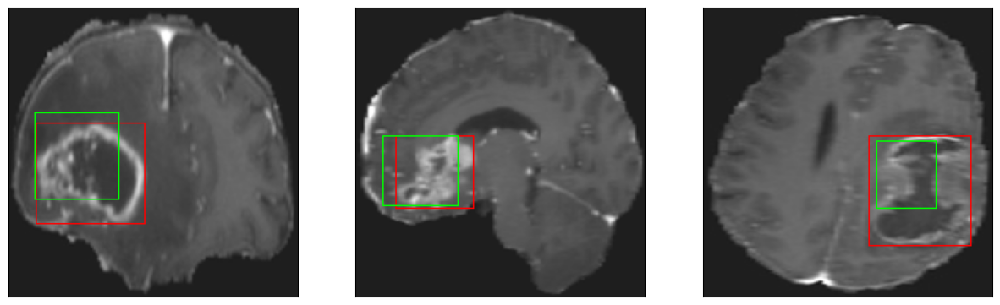

26/26 [==============================] - 3s 100ms/step - loss: 4.6793 - IoU: 0.6487 - val_loss: 10.3177 - val_IoU: 0.4338
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 4.4373 - IoU: 0.6558
Epoch 154: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


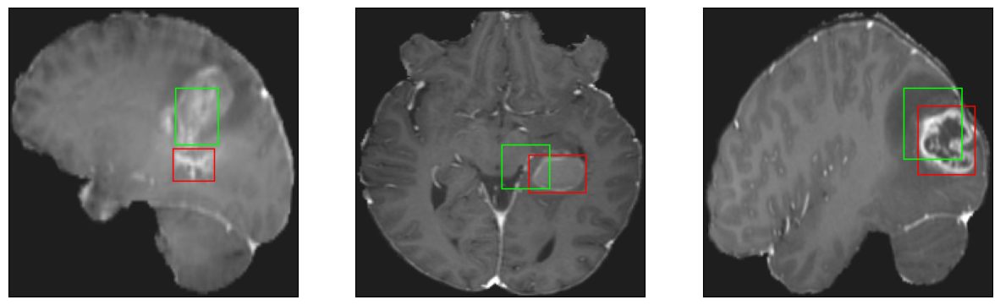

26/26 [==============================] - 3s 98ms/step - loss: 4.4373 - IoU: 0.6558 - val_loss: 9.5375 - val_IoU: 0.4659
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 4.6634 - IoU: 0.6415
Epoch 155: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


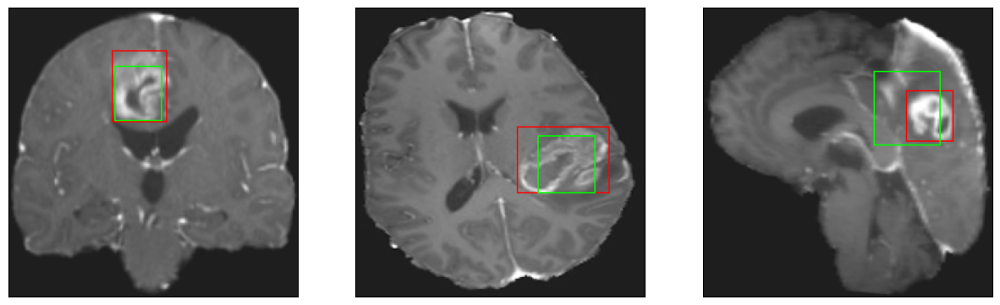

26/26 [==============================] - 3s 110ms/step - loss: 4.6634 - IoU: 0.6415 - val_loss: 10.6027 - val_IoU: 0.4033
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 4.2990 - IoU: 0.6574
Epoch 156: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


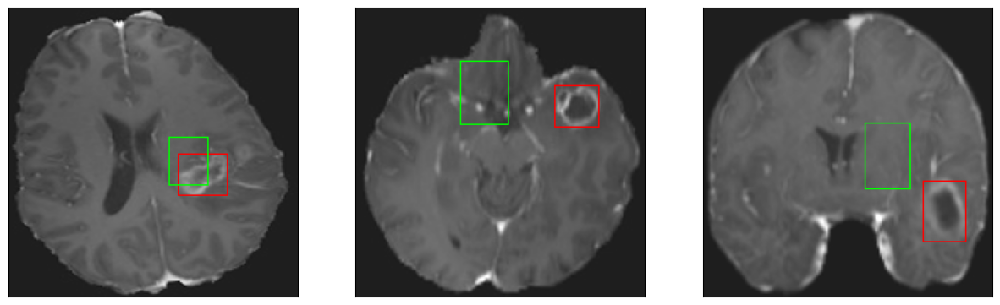

26/26 [==============================] - 3s 127ms/step - loss: 4.2990 - IoU: 0.6574 - val_loss: 10.1836 - val_IoU: 0.4433
Epoch 157/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4422 - IoU: 0.6516
Epoch 157: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


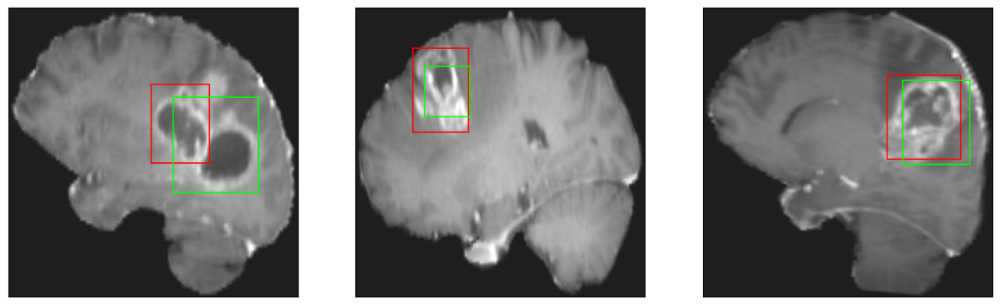

26/26 [==============================] - 3s 98ms/step - loss: 4.4267 - IoU: 0.6518 - val_loss: 9.4609 - val_IoU: 0.4882
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3674 - IoU: 0.6585
Epoch 158: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


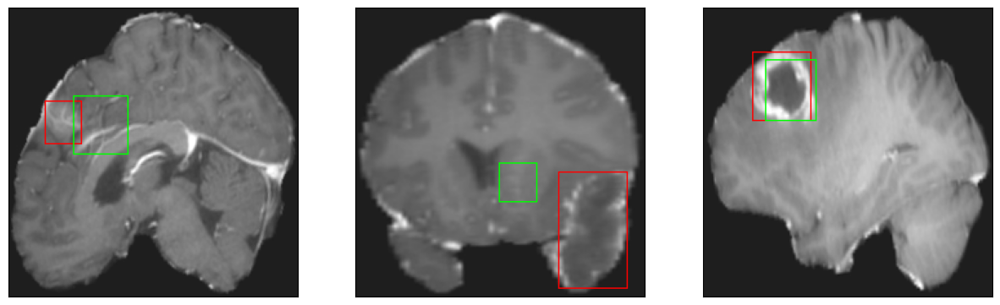

26/26 [==============================] - 3s 100ms/step - loss: 4.4056 - IoU: 0.6565 - val_loss: 10.4469 - val_IoU: 0.4325
Epoch 159/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4951 - IoU: 0.6505
Epoch 159: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


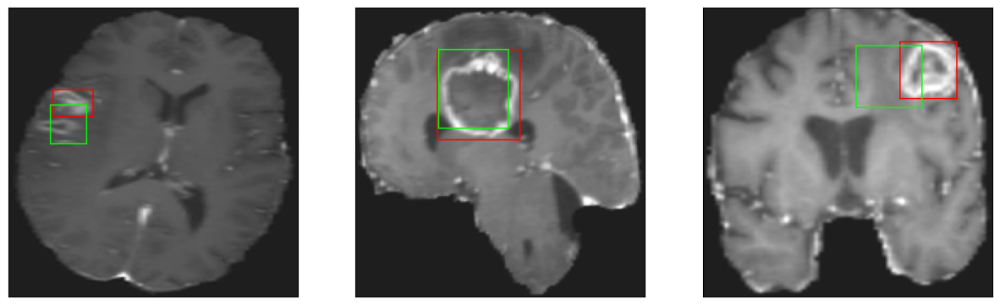

26/26 [==============================] - 3s 121ms/step - loss: 4.5365 - IoU: 0.6484 - val_loss: 9.4555 - val_IoU: 0.4696
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 4.4715 - IoU: 0.6466
Epoch 160: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


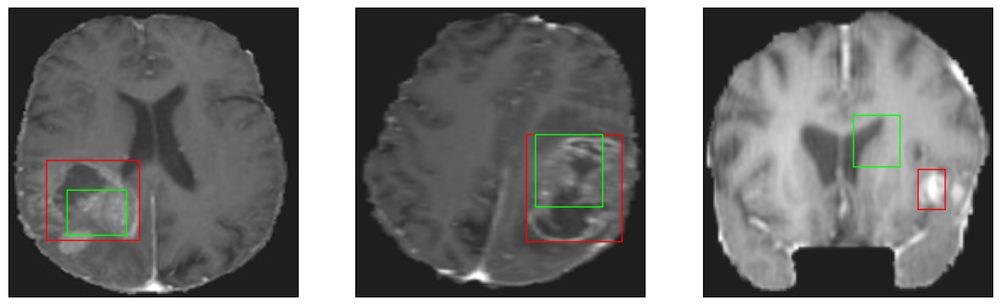

26/26 [==============================] - 3s 127ms/step - loss: 4.4715 - IoU: 0.6466 - val_loss: 9.9081 - val_IoU: 0.4543
Epoch 161/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5737 - IoU: 0.6424
Epoch 161: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


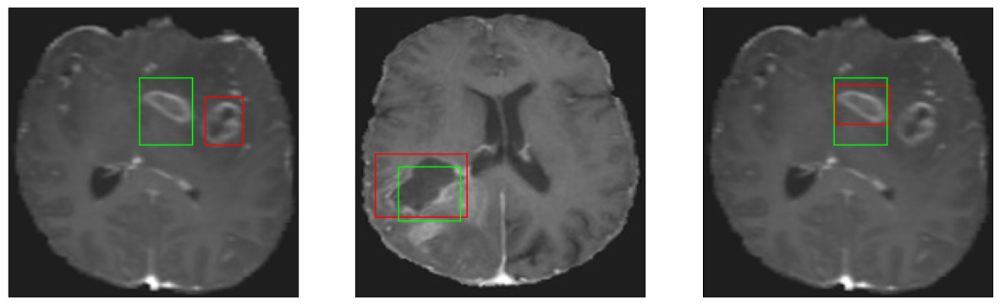

26/26 [==============================] - 3s 123ms/step - loss: 4.5890 - IoU: 0.6423 - val_loss: 12.2135 - val_IoU: 0.3710
Epoch 162/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2912 - IoU: 0.6673
Epoch 162: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


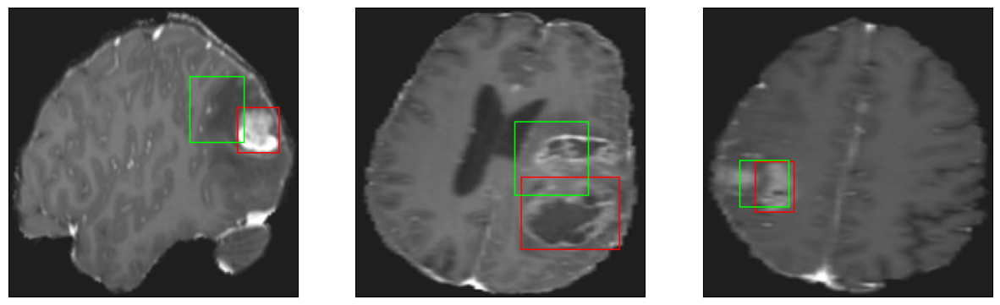

26/26 [==============================] - 3s 118ms/step - loss: 4.3695 - IoU: 0.6628 - val_loss: 10.6235 - val_IoU: 0.4087
Epoch 163/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3499 - IoU: 0.6583
Epoch 163: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


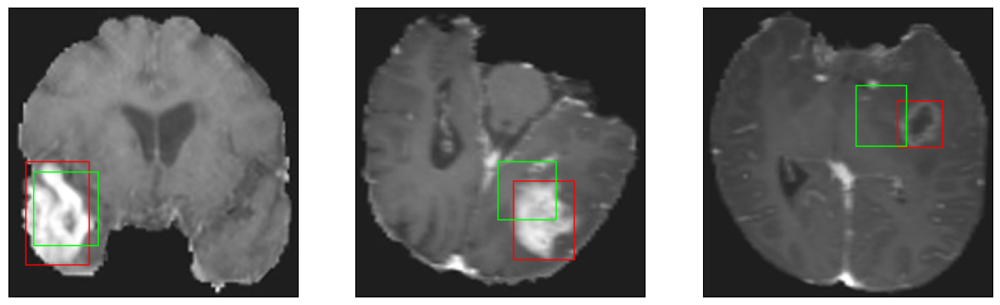

26/26 [==============================] - 3s 107ms/step - loss: 4.3000 - IoU: 0.6610 - val_loss: 9.0172 - val_IoU: 0.5080
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 4.3894 - IoU: 0.6521
Epoch 164: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


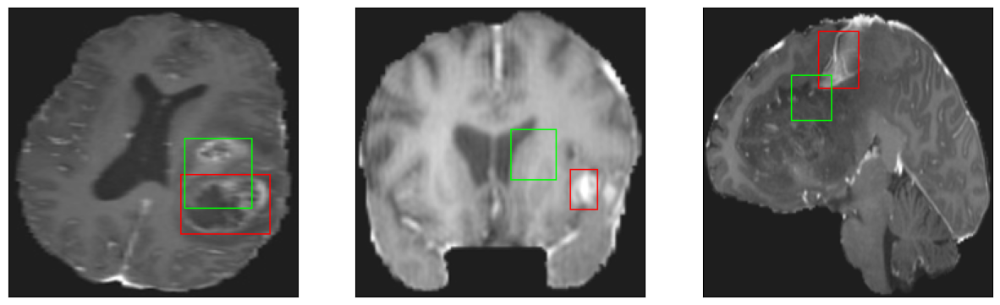

26/26 [==============================] - 3s 96ms/step - loss: 4.3894 - IoU: 0.6521 - val_loss: 9.2090 - val_IoU: 0.4768
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 4.2680 - IoU: 0.6633
Epoch 165: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


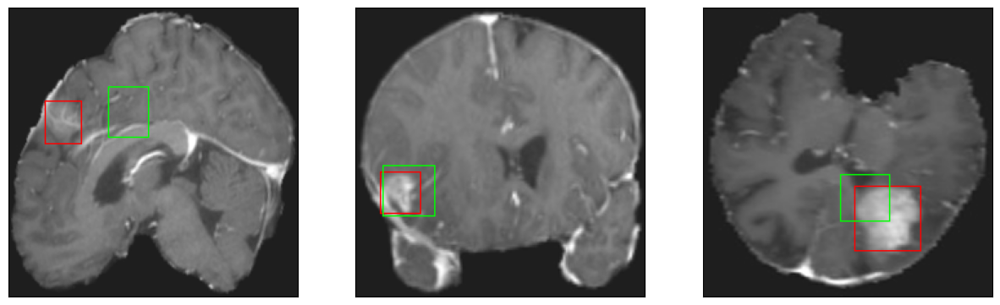

26/26 [==============================] - 3s 108ms/step - loss: 4.2680 - IoU: 0.6633 - val_loss: 10.2932 - val_IoU: 0.4420
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2967 - IoU: 0.6629
Epoch 166: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


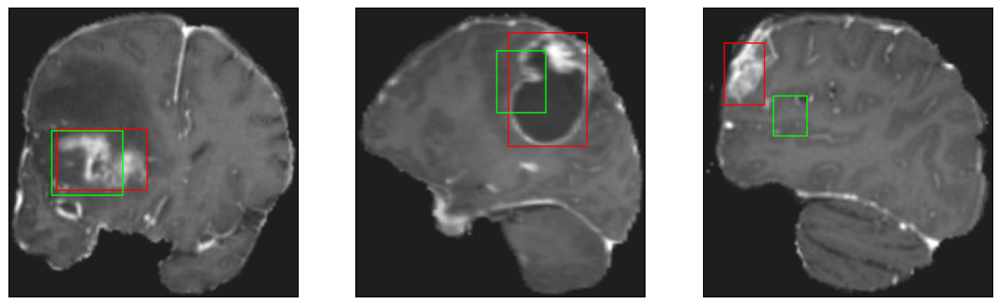

26/26 [==============================] - 3s 118ms/step - loss: 4.3202 - IoU: 0.6611 - val_loss: 9.7989 - val_IoU: 0.4664
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 4.3770 - IoU: 0.6562
Epoch 167: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


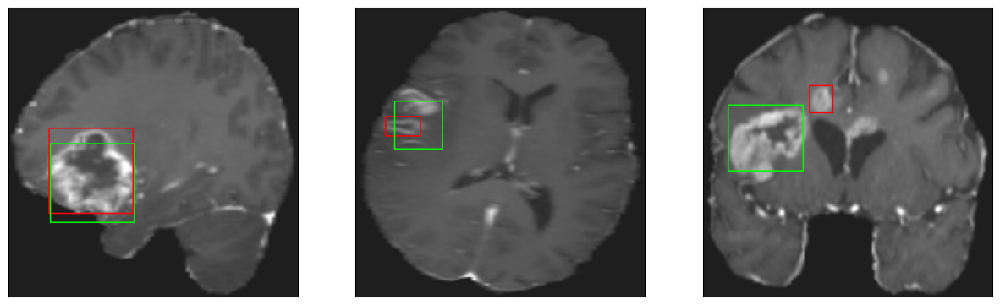

26/26 [==============================] - 3s 106ms/step - loss: 4.3770 - IoU: 0.6562 - val_loss: 9.2348 - val_IoU: 0.4943
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 4.2134 - IoU: 0.6606
Epoch 168: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


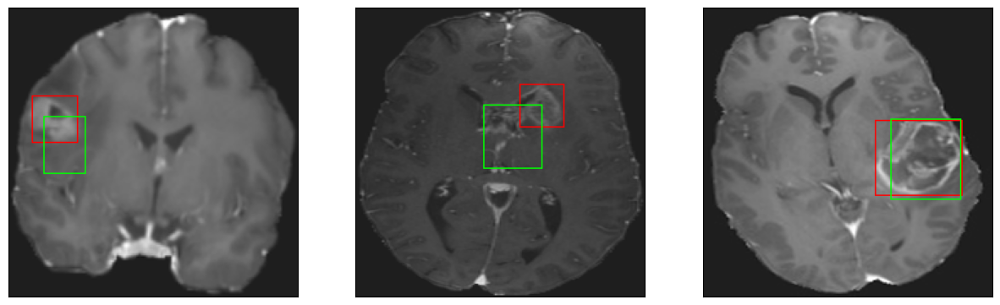

26/26 [==============================] - 3s 120ms/step - loss: 4.2134 - IoU: 0.6606 - val_loss: 10.0661 - val_IoU: 0.4679
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 4.3467 - IoU: 0.6543
Epoch 169: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


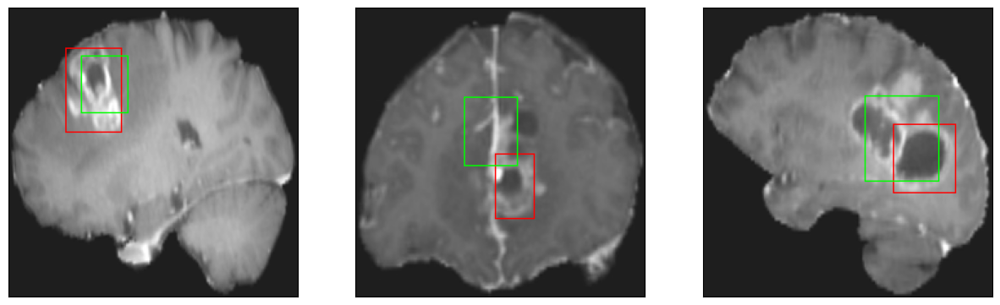

26/26 [==============================] - 3s 113ms/step - loss: 4.3467 - IoU: 0.6543 - val_loss: 12.1690 - val_IoU: 0.3823
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 4.5556 - IoU: 0.6389
Epoch 170: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


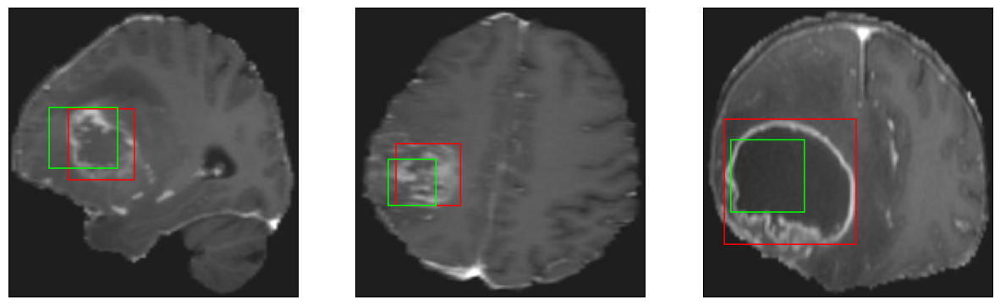

26/26 [==============================] - 3s 118ms/step - loss: 4.5556 - IoU: 0.6389 - val_loss: 10.0531 - val_IoU: 0.4473
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 4.5007 - IoU: 0.6433
Epoch 171: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 11ms/step
4


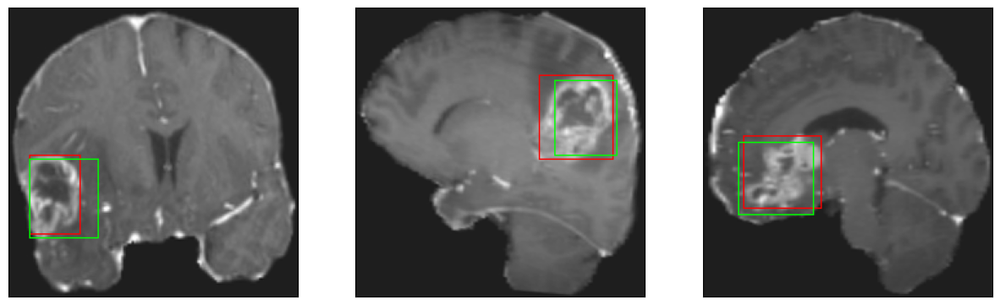

26/26 [==============================] - 3s 101ms/step - loss: 4.5007 - IoU: 0.6433 - val_loss: 9.8214 - val_IoU: 0.4667
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 4.2896 - IoU: 0.6618
Epoch 172: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


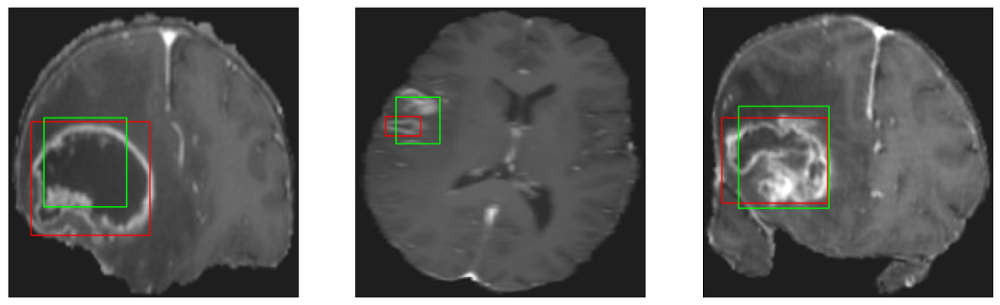

26/26 [==============================] - 3s 118ms/step - loss: 4.2896 - IoU: 0.6618 - val_loss: 9.4297 - val_IoU: 0.4771
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3620 - IoU: 0.6579
Epoch 173: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


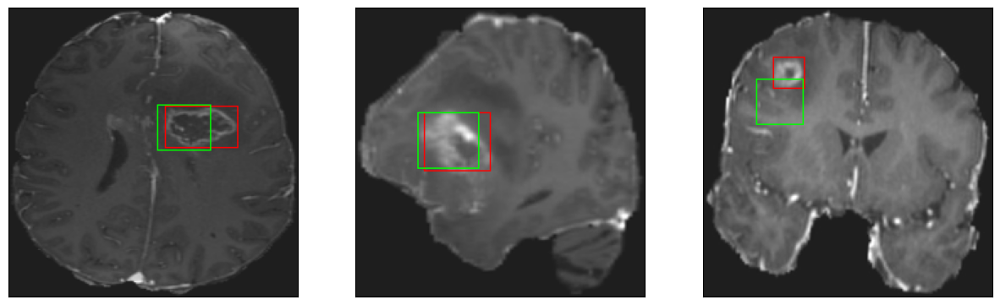

26/26 [==============================] - 3s 126ms/step - loss: 4.3517 - IoU: 0.6590 - val_loss: 9.7105 - val_IoU: 0.4587
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 4.2615 - IoU: 0.6612
Epoch 174: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


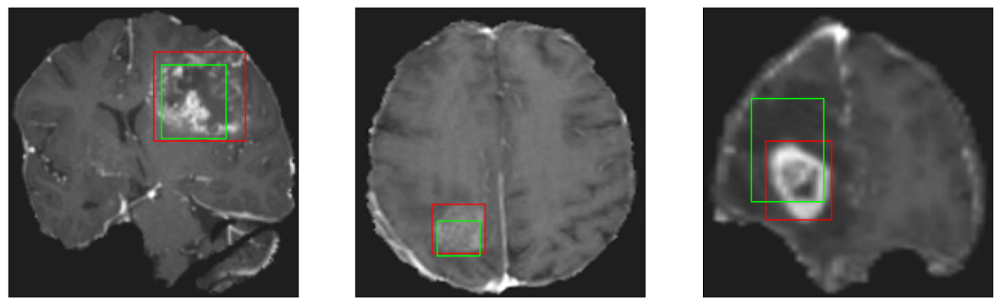

26/26 [==============================] - 3s 113ms/step - loss: 4.2615 - IoU: 0.6612 - val_loss: 11.9038 - val_IoU: 0.3780
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 4.1154 - IoU: 0.6745
Epoch 175: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


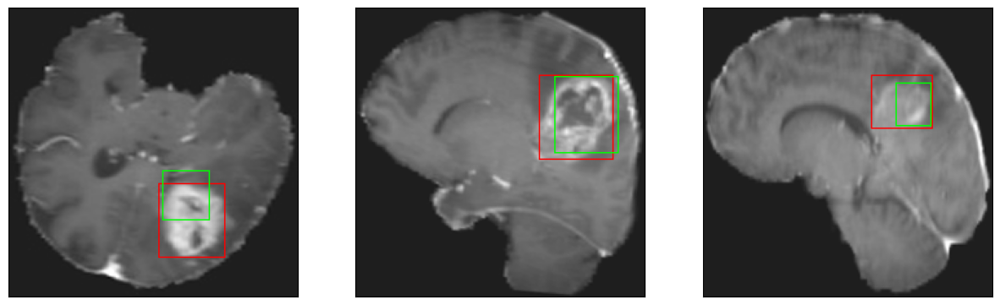

26/26 [==============================] - 3s 105ms/step - loss: 4.1154 - IoU: 0.6745 - val_loss: 9.6844 - val_IoU: 0.4654
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 4.3677 - IoU: 0.6509
Epoch 176: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


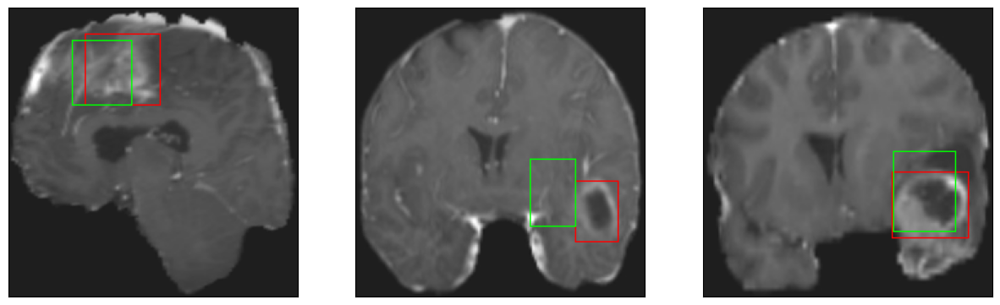

26/26 [==============================] - 3s 118ms/step - loss: 4.3677 - IoU: 0.6509 - val_loss: 9.7458 - val_IoU: 0.4777
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 4.2655 - IoU: 0.6608
Epoch 177: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


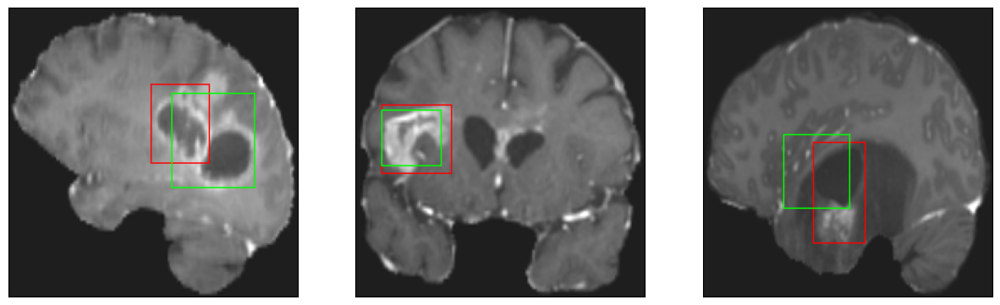

26/26 [==============================] - 3s 132ms/step - loss: 4.2655 - IoU: 0.6608 - val_loss: 9.3735 - val_IoU: 0.4800
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 4.2204 - IoU: 0.6648
Epoch 178: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


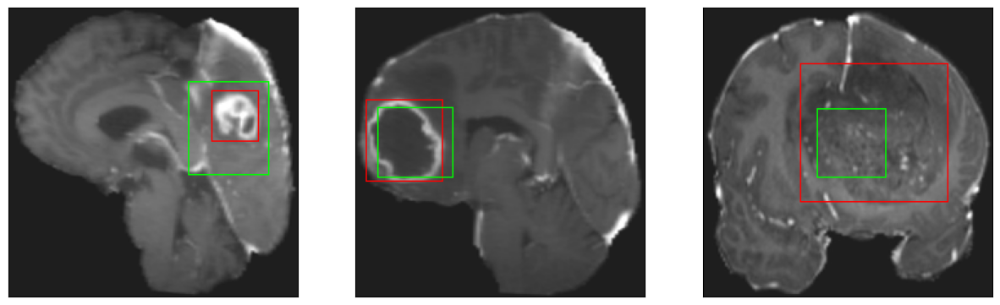

26/26 [==============================] - 3s 106ms/step - loss: 4.2204 - IoU: 0.6648 - val_loss: 9.4651 - val_IoU: 0.5024
Epoch 179/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2589 - IoU: 0.6640
Epoch 179: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


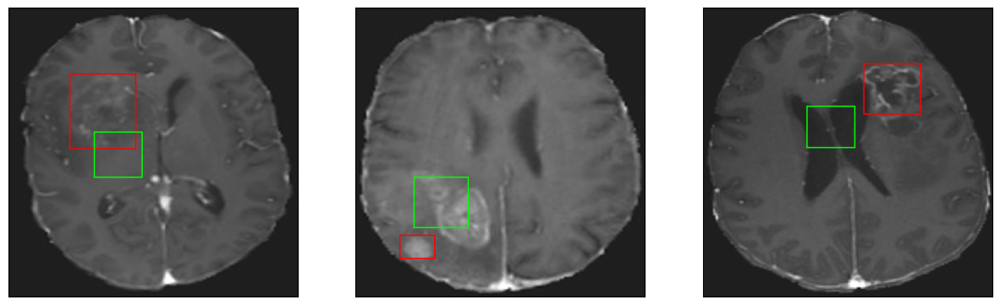

26/26 [==============================] - 3s 121ms/step - loss: 4.2282 - IoU: 0.6658 - val_loss: 13.7170 - val_IoU: 0.3404
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0782 - IoU: 0.6715
Epoch 180: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


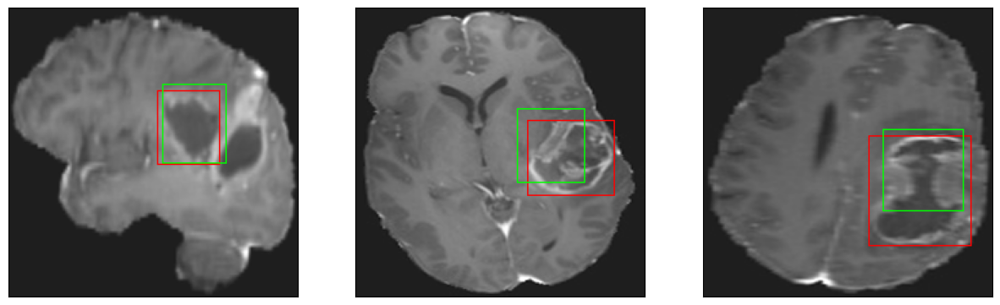

26/26 [==============================] - 3s 112ms/step - loss: 4.0600 - IoU: 0.6719 - val_loss: 12.9700 - val_IoU: 0.3693
Epoch 181/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2078 - IoU: 0.6643
Epoch 181: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


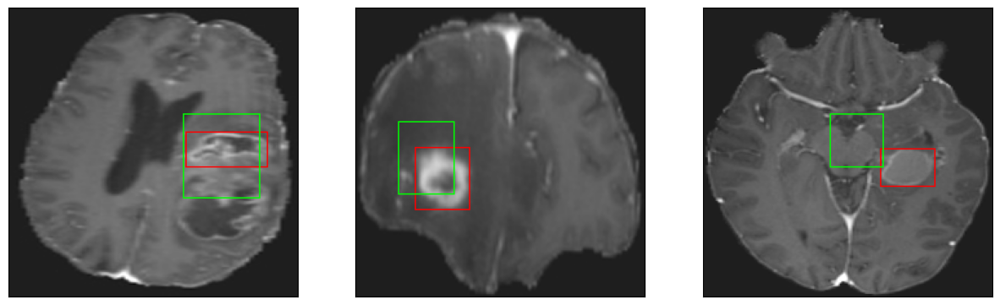

26/26 [==============================] - 3s 117ms/step - loss: 4.2448 - IoU: 0.6627 - val_loss: 10.1105 - val_IoU: 0.4531
Epoch 182/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5490 - IoU: 0.6530
Epoch 182: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


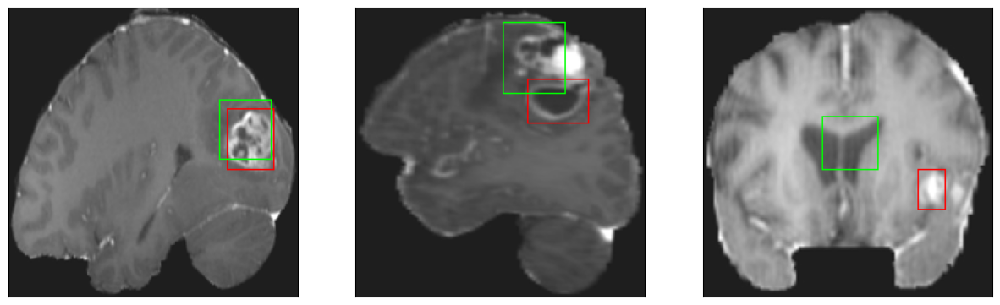

26/26 [==============================] - 3s 105ms/step - loss: 4.5216 - IoU: 0.6545 - val_loss: 9.4497 - val_IoU: 0.4907
Epoch 183/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1335 - IoU: 0.6749
Epoch 183: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


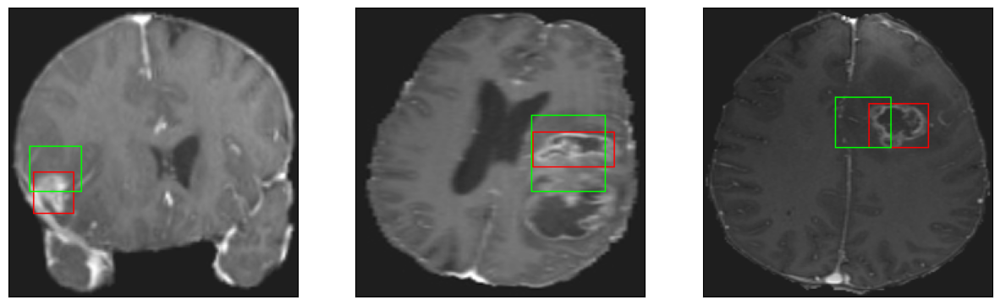

26/26 [==============================] - 3s 98ms/step - loss: 4.0882 - IoU: 0.6766 - val_loss: 13.4007 - val_IoU: 0.3340
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 4.2389 - IoU: 0.6655
Epoch 184: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


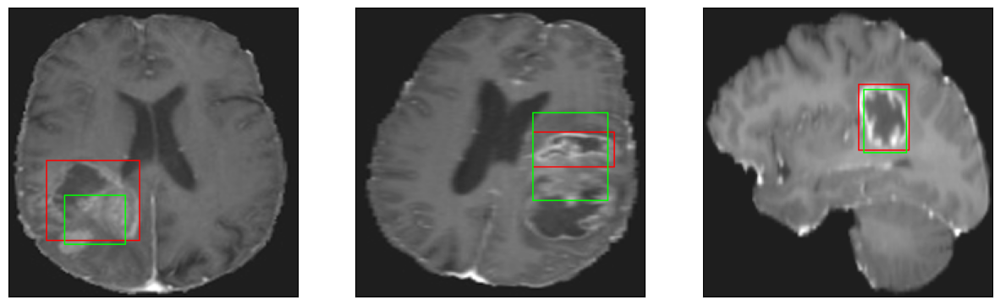

26/26 [==============================] - 3s 112ms/step - loss: 4.2389 - IoU: 0.6655 - val_loss: 10.4798 - val_IoU: 0.4344
Epoch 185/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2333 - IoU: 0.6584
Epoch 185: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


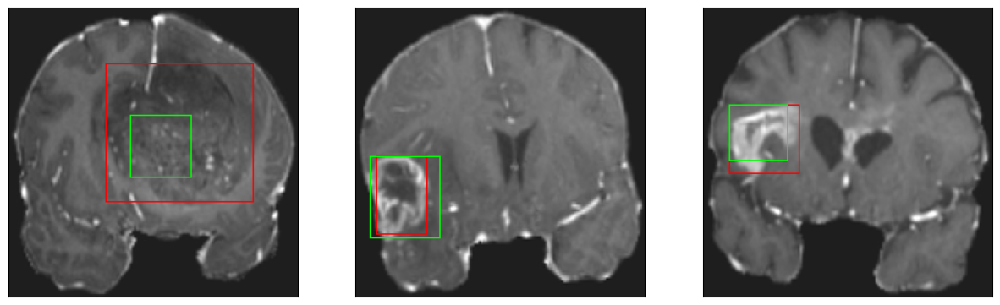

26/26 [==============================] - 3s 104ms/step - loss: 4.2166 - IoU: 0.6591 - val_loss: 9.1195 - val_IoU: 0.4901
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 4.2291 - IoU: 0.6674
Epoch 186: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


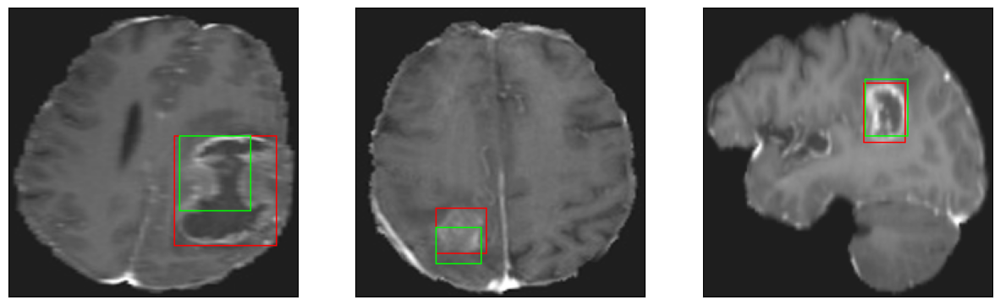

26/26 [==============================] - 3s 114ms/step - loss: 4.2291 - IoU: 0.6674 - val_loss: 10.3598 - val_IoU: 0.4347
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 4.1842 - IoU: 0.6614
Epoch 187: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


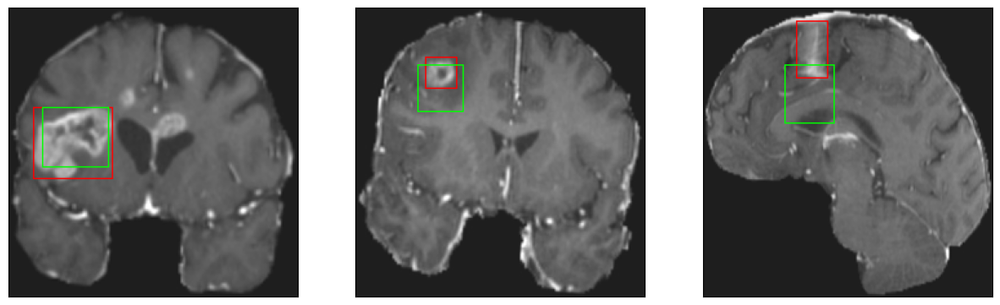

26/26 [==============================] - 3s 100ms/step - loss: 4.1842 - IoU: 0.6614 - val_loss: 10.3408 - val_IoU: 0.4451
Epoch 188/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2944 - IoU: 0.6590
Epoch 188: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


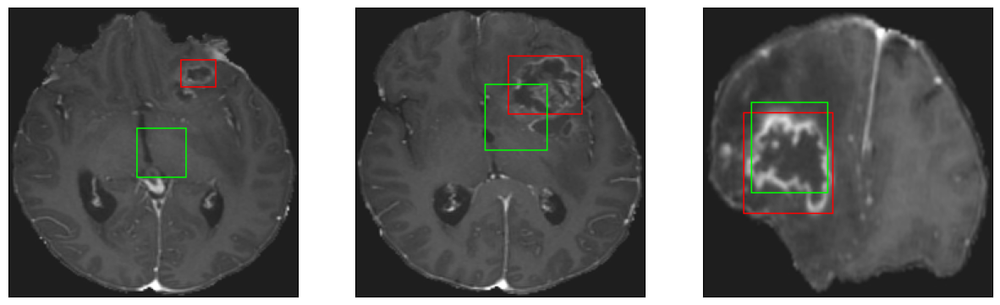

26/26 [==============================] - 3s 109ms/step - loss: 4.2659 - IoU: 0.6595 - val_loss: 9.6728 - val_IoU: 0.4697
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 4.1205 - IoU: 0.6661
Epoch 189: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


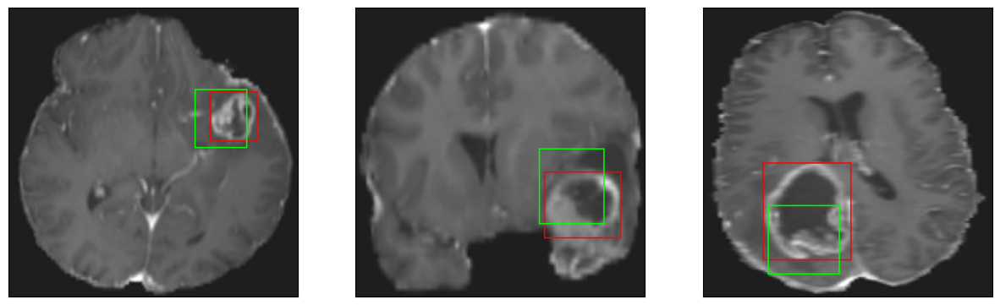

26/26 [==============================] - 3s 101ms/step - loss: 4.1205 - IoU: 0.6661 - val_loss: 9.2344 - val_IoU: 0.4909
Epoch 190/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2013 - IoU: 0.6706
Epoch 190: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


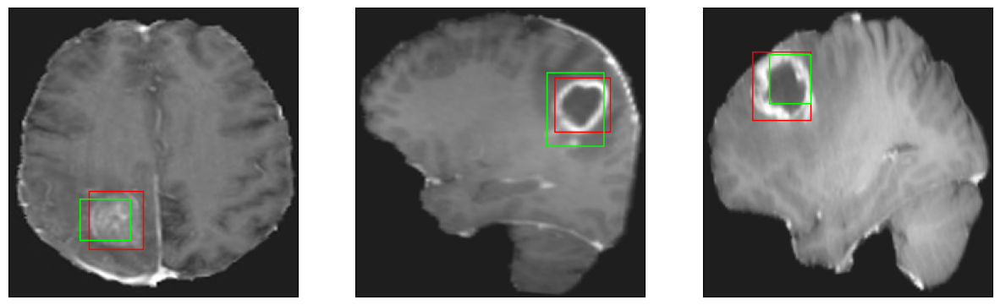

26/26 [==============================] - 2s 96ms/step - loss: 4.1763 - IoU: 0.6721 - val_loss: 10.4323 - val_IoU: 0.4333
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 4.1600 - IoU: 0.6686
Epoch 191: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


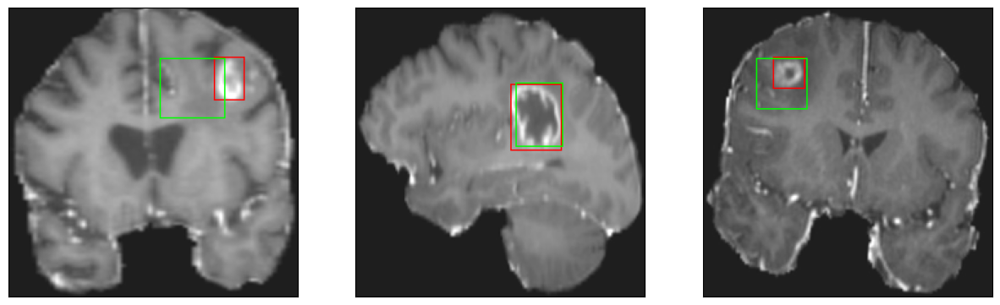

26/26 [==============================] - 3s 104ms/step - loss: 4.1600 - IoU: 0.6686 - val_loss: 9.4634 - val_IoU: 0.4776
Epoch 192/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2218 - IoU: 0.6606
Epoch 192: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


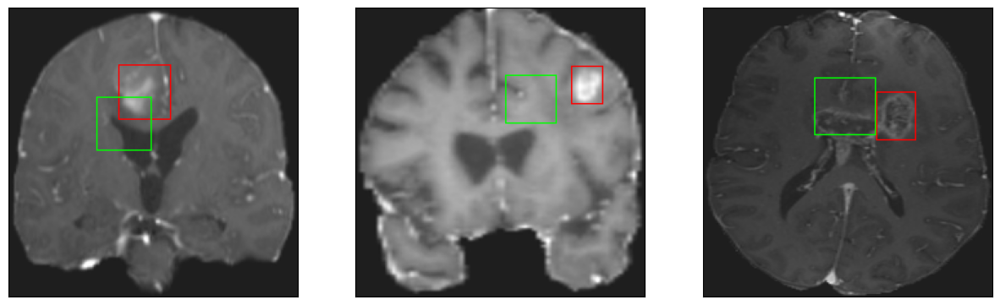

26/26 [==============================] - 2s 95ms/step - loss: 4.2812 - IoU: 0.6584 - val_loss: 9.4212 - val_IoU: 0.4904
Epoch 193/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1409 - IoU: 0.6731
Epoch 193: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


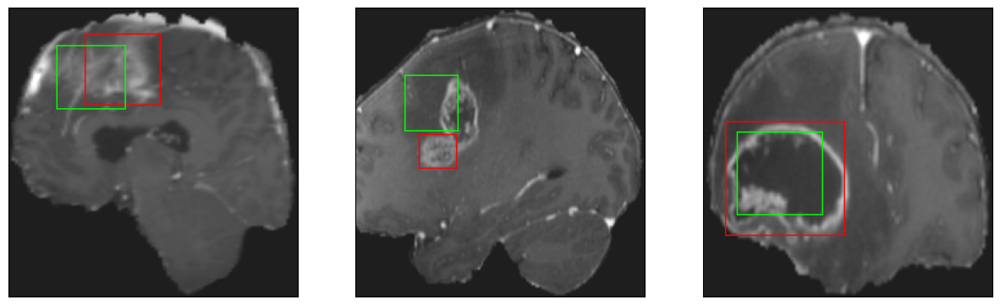

26/26 [==============================] - 3s 131ms/step - loss: 4.1138 - IoU: 0.6755 - val_loss: 9.1716 - val_IoU: 0.4906
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 4.1821 - IoU: 0.6683
Epoch 194: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


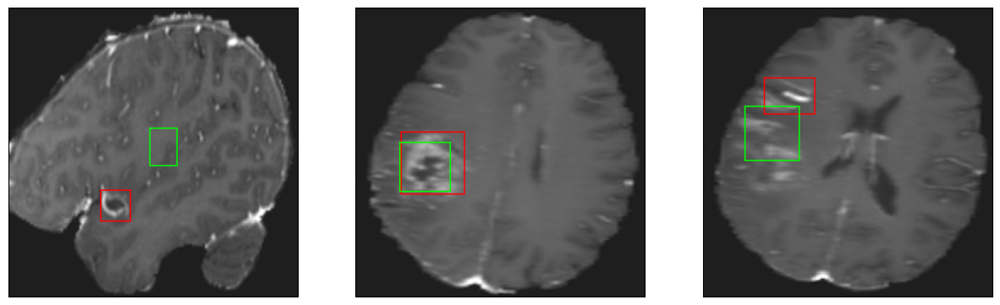

26/26 [==============================] - 3s 128ms/step - loss: 4.1821 - IoU: 0.6683 - val_loss: 9.1575 - val_IoU: 0.4803
Epoch 195/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1340 - IoU: 0.6713
Epoch 195: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


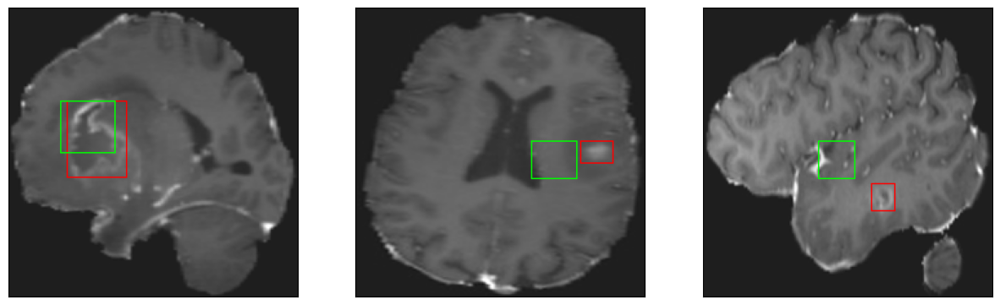

26/26 [==============================] - 3s 102ms/step - loss: 4.1423 - IoU: 0.6708 - val_loss: 11.0339 - val_IoU: 0.4195
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 4.3222 - IoU: 0.6545
Epoch 196: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


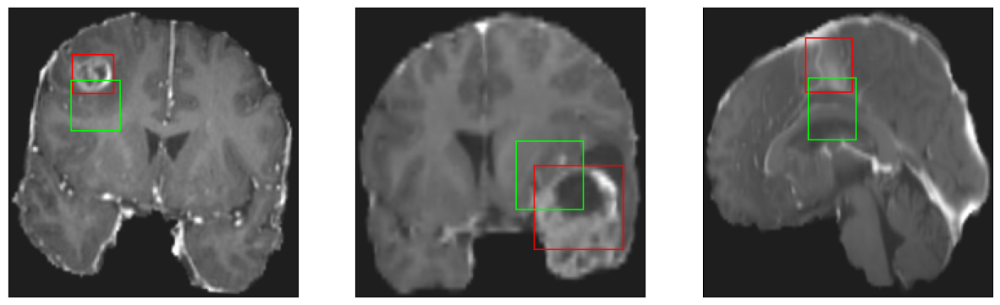

26/26 [==============================] - 3s 96ms/step - loss: 4.3222 - IoU: 0.6545 - val_loss: 9.7926 - val_IoU: 0.4569
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 4.2165 - IoU: 0.6639
Epoch 197: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


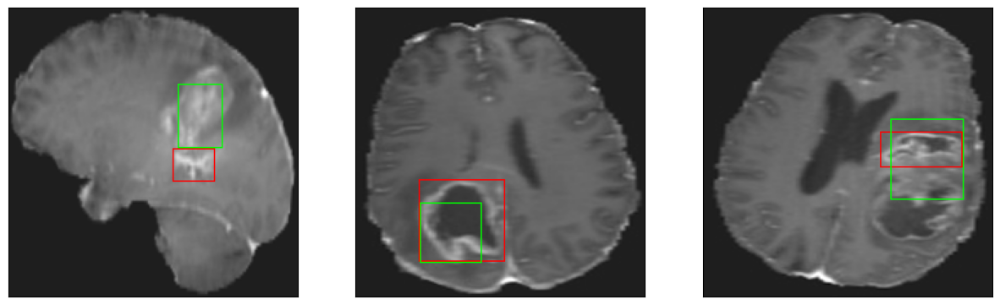

26/26 [==============================] - 3s 105ms/step - loss: 4.2165 - IoU: 0.6639 - val_loss: 9.2756 - val_IoU: 0.4824
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 4.1192 - IoU: 0.6712
Epoch 198: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


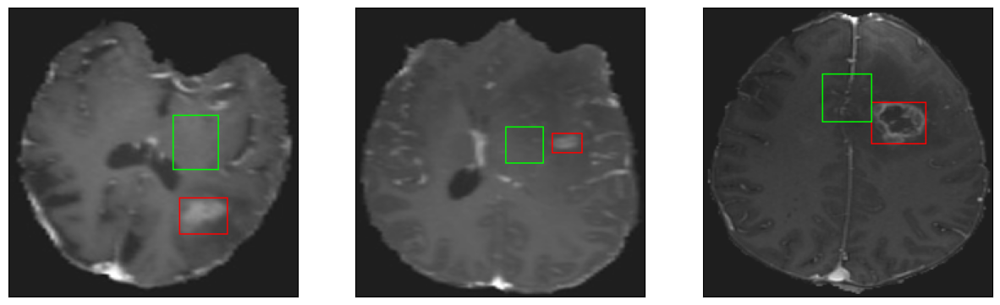

26/26 [==============================] - 3s 116ms/step - loss: 4.1192 - IoU: 0.6712 - val_loss: 11.0501 - val_IoU: 0.4224
Epoch 199/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0772 - IoU: 0.6836
Epoch 199: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


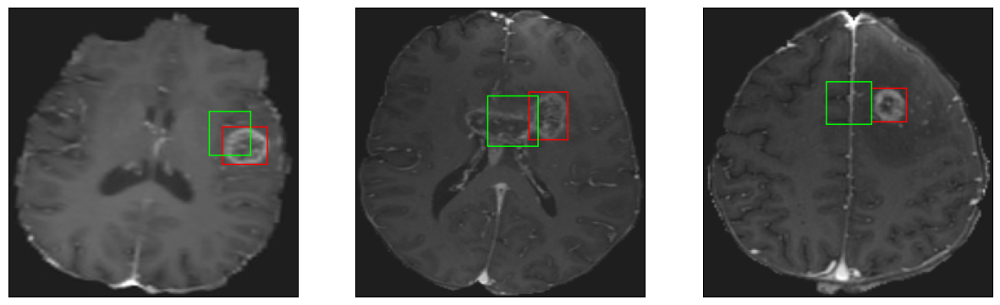

26/26 [==============================] - 3s 116ms/step - loss: 4.0496 - IoU: 0.6839 - val_loss: 10.7768 - val_IoU: 0.4239
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 4.2500 - IoU: 0.6653
Epoch 200: val_loss did not improve from 9.01554
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


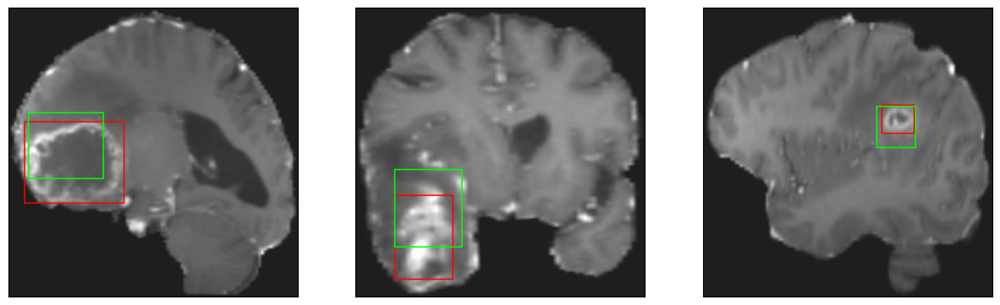

26/26 [==============================] - 3s 119ms/step - loss: 4.2500 - IoU: 0.6653 - val_loss: 9.6013 - val_IoU: 0.4731


In [24]:
model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [25]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [26]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [27]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 36ms/step - loss: 12.0638 - IoU: 0.3622


[12.063831329345703, 0.3621794879436493]